In [1]:
import numpy as np
# pandas is a fast and simple library for data manipulation
# it supports spreadsheet-like data structures, so we can read/write/manipulate csv or excel files easily
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.backends.backend_pdf import PdfPages
from sklearn.cluster import KMeans
# use curve_fit for Rosenbluth linear fit
from scipy.optimize import curve_fit
from scipy.interpolate import interp1d
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
# import subprocess
# python version: /usr/local/bin/python3
# optional: use science paper style for plots
# from matplotlib.ticker import ScalarFormatter
from matplotlib.ticker import ScalarFormatter



# import scienceplots
# plt.style.use('science')



# from PIL import Image
# from reportlab.pdfgen import canvas
# plt.rcParams['font.weight'] = 'bold'  # Applies to all text elements
# plt.rcParams['axes.titleweight'] = 'bold'  # Bold titles
# plt.rcParams['axes.labelweight'] = 'bold'  # Bold axis labels
# plt.rcParams['legend.fontsize'] = 12  # Adjust legend font size
# plt.rcParams['legend.fontweight'] = 'bold'  # Bold legend text
# plt.rcParams['xtick.labelsize'] = 12  # Adjust x-tick labels font size
# plt.rcParams['ytick.labelsize'] = 12  # Adjust y-tick labels font size

# calculate bin-centering correction using Fortran program
import subprocess
import os



In [2]:
#____________________presets____________________
# physical constants
mass_nucleon = 0.938273
mass_C12=11.178
alpha_fine = 1/137.036

# three-momentum bin centers
qvcenters = [0.100, 0.148, 0.167, 0.205, 0.240, 0.300, 0.380, 0.475, 0.570, 0.649, 0.756, 0.991, 1.619, 1.921, 2.213, 2.500, 2.783, 3.500]
# three-momentum edges
qvbins = [0.063, 0.124, 0.158, 0.186, 0.223, 0.270, 0.340, 0.428, 0.523, 0.609, 0.702, 0.878, 1.302, 1.770, 2.067, 2.357, 2.642, 2.923, 4.500]
# four-momentum squared bin names, in string format
qvbin_names = ['[0.063,0.124]', '[0.124,0.158]', '[0.158,0.186]', '[0.186,0.223]', '[0.223,0.270]', '[0.270,0.340]', '[0.340,0.428]', '[0.428,0.523]', '[0.523,0.609]',
                '[0.609,0.702]', '[0.702,0.878]', '[0.878,1.302]', '[1.302,1.770]', '[1.770,2.067]', '[2.067,2.357]', '[2.357,2.642]', '[2.642,2.923]', '[2.923,4.500]']

# four-momentum squared bin centers
Q2centers = [0.010, 0.020, 0.026, 0.040, 0.056, 0.093, 0.120, 0.160, 0.265, 0.380, 0.500, 0.800, 1.250, 1.750, 2.250, 2.750, 3.250, 3.750]
# four-momentum squared bin edges
Q2bins = [0.004, 0.015, 0.025, 0.035, 0.045, 0.070, 0.100, 0.145, 0.206, 0.322, 0.438, 0.650, 1.050, 1.500, 2.000, 2.500, 3.000, 3.500, 4.000]
# four-momentum squared bin names, in string format
Q2bin_names = ['[0.004,0.015]', '[0.015,0.025]', '[0.025,0.035]', '[0.035,0.045]', '[0.045,0.070]', '[0.070,0.100]', '[0.100,0.145]', '[0.145,0.206]', '[0.206,0.322]',
                '[0.322,0.438]', '[0.438,0.650]', '[0.650,1.050]', '[1.050,1.500]', '[1.500,2.000]', '[2.000,2.500]', '[2.500,3.000]', '[3.000,3.500]', '[3.500,4.000]']

# Feb24 2025: map from data set index to data set name (author, year, etc.)
dataSet_to_name = {1:"Barreau:1983ht", 2:"O'Connell:198", 3:"Sealock:1989nx", 4:"Baran:1988tw", 5:"Bagdasaryan:1988hp", 6:"Dai - HallA:2019da", 
    7:"Arrington:1995hs", 8:"Day:1993md", 9:"Arrington:1998psnoCC", 10:"Gaskell:2008", 11:"Whitney:1974hr", 12:"AlsamiJan05", 13:"VaheJun07", 
    14:"Gomez74", 15:"Fomin", 16:"Yamaguchi73", 17:"Ryan84", 18:"Cyzyk:1963zz", 19:"Bounin63", 20:"Photo-Daphne", 
    # 21:"Spamer70", 
    21:"Antony-Spies:1970jjs",22:"Goldemberg64", 23:"DeForrest65", 24:"Mihovilovic:2024ymj", 25:"CLAS-e4nu",26:"GarinoBates:1992",
    -1:"N/A"
    }

# march 31 from Eric:
dataSet_to_normalization = {
    1: 0.95971, 2: 0.96416, 3: 1.0744, 4: 0.99482, 5: 0.93381,
    6: 1.0126, 7: 0.96716, 8: 1.0238, 9: 0.97904, 10: 0.99064,
    11: 0.98384, 12: 1.0000, 13: 1.0163, 14: 1.0300, 15: 1.0190,
    16: 0.95853, 17: 1.0174, 18: 1.0168, 19: 1.0794, 20: 1.0000,
    21: 1.0019, 22: 0.99801, 23: 0.96773, 24: 0.95610,
    25:0.85, 26:0.94
}

dataSet_to_normError = {
    1: 0.62926E-02, 2: 0.12908E-01, 3: 0.80983E-02, 4: 0.69809E-02, 5: 0.16758E-01,
    6: 0.92261E-02, 7: 0.15546E-01, 8: 0.65203E-02, 9: 0.55606E-02, 10: 0.75245E-02,
    11: 0.25318E-01, 12: 0.0, 13: 0.17632E-02, 14: 0.91993E-02, 15: 0.63181E-02,
    16: 0.25582E-01, 17: 0.42184E-01, 18: 0.68067E-01, 19: 0.35847E-01, 20: 0.0,
    21: 0.18356E-01, 22: 0.41475E-01, 23: 0.17317E-01, 24: 0.23120E-01,
    25:0.02,26:0.02
}

# ____________________utility functions____________________

# round to only 3 significant figures (for printing)
def round_sig_3(x):
    return '%s' % float('%.3g' % x)

# append a row to a dataframe
def append_row(df, row):
    return pd.concat([df, pd.DataFrame([row], columns=row.index)]).reset_index(drop=True)

# linear model for Rosenbluth fitting
def linear_model(x, a, b):
    return a * x + b

def Vcoul(A=12,Z=6):
    HBARC  = 0.197327      # in GeV.fm
    ALPHA  = 1.0/137.0
    C_ASTE = 0.775
    R0     = 1.1*A**(1./3.) + 0.86*A**(-1./3.)

    # Coulomb potential at the center of the nucleus
    V0  = (3./2.)*ALPHA*HBARC*(Z-1.)/R0  # in GeV

    # Average potential
    V  = C_ASTE*V0      # from Eur. Phys. J. A26 (2005) 167
    return V

def quasi_deuteron(ex): # ex in MeV; return GD cross-section: GeV^-2
    def pauli_blocking(ex): # ex in MeV
        if ex <=20:
            return np.exp(-73.3/ex)
        elif 20 < ex <=140: 
            return 8.3714e-2 - 9.8343e-3 * ex + 4.1222e-4 * ex**2 - 3.4762e-6 * ex**3 + 9.3537e-9 * ex**4
        else:
            return np.exp(-24.2/ex)
    N=6
    A=12
    Z=6
    if ex <2.224:
        return 0
    else:    
        sigma = 397.8*(N*Z/A)*((ex-2.224)**(3/2))*(ex**-3)*pauli_blocking(ex) # in mb
        return sigma * 0.1 * 0.1975**-2 # in GeV^-2

def dipole_E(Q2): # Q2 in GeV^2; return dipole form unitless
    return 1/((1+Q2/0.71)**2)


In [ ]:
# ____________________RLRT extraction, plotting functions____________________
errorbar_setting = {'markersize':0,'capsize':0,'lw':1,'fmt':'D','elinewidth':1,'zorder':2,'alpha':0.5}
our_scatter_setting = {'s':10,'marker':'D',
                       'edgecolors':'gray',
                       'linewidth':0.5,'zorder':4,'alpha':1}
scatter_setting = {'s':10,
                   'edgecolors':'gray',
                   'linewidth':0.5,
                   'zorder':3,'alpha':1}
photo_scatter_setting = {'s':30,'color':'lime','marker':'^','edgecolors':'black','linewidth':0.5,'zorder':1}
yam_scatter = {'s':4,'marker':'o','edgecolors':'gray','linewidth':0.3,'zorder':3}
baran_scatter_setting = {'s':20,'edgecolors':'gray','linewidth':0.5,'zorder':3,'alpha':1}
Ex_cut=0.03
Ex_cut_lowq=0.1
# susacolor='royalblue'
susacolor='violet'
SuSAExtractColor='lawngreen'
susalw=2

def prepare_df(df_data=None,coulomb=None):
    df = df_data.copy()
    # read the csv file:
    # if filepath is not None:
    #     df = pd.read_csv(filepath)
    #     # Z,A,E0,ThetaDeg,nu,cross,error,dataSet
    #     df = df[['Z','A','E0','ThetaDeg','nu','cross','error','dataSet']]
    # elif df_data is not None:
    #     df = df_data.copy()
    # else:
    #     return None

    if 'error' not in df.columns:
        df['error']=0.0

    # calculate normalized cross section:
    if 'dataSet' not in df.columns:
        df['dataSet']=-1
        df['normalization']=1
        df['normError']=0
    else:
        df["normalization"]=df["dataSet"].map(dataSet_to_normalization)
        df["normError"]=df["dataSet"].map(dataSet_to_normError)
    df['normCross'] = df['cross'] * df['normalization']
        
    # system_err = 0.02
    system_err = 0.0

    df['error'] = np.sqrt(df['error']**2 + ((system_err*df['cross'])**2))
    df['normCrossError']=df['normCross']*np.sqrt((df['error']/df['cross'])**2+(df['normError']/df['normalization'])**2)
    df["ThetaRad"]=df["ThetaDeg"]*np.pi/180
    df["sin2(T/2)"]=(np.sin(df["ThetaRad"]/2))**2
    df["cos2(T/2)"]=(np.cos(df["ThetaRad"]/2))**2
    df["tan2(T/2)"]=(np.tan(df["ThetaRad"]/2))**2

    df["Ex"] = df["nu"] - (df["E0"]-df["E0"]/(1+2*df["E0"]*df["sin2(T/2)"]/mass_C12))

    # R = 2.894, Z = 6, A = 12
    # df["R"]=1.1*(df["A"])**(1/3)+0.86/((df["A"])**(1/3))
    
    df["Ep"]=df["E0"]-df["nu"]

    
    if coulomb is not None:
        df["Veff"]=coulomb
    else:
        df["Veff"]=Vcoul(A=12,Z=6)

    # GENIE:
    # df["Veff"]=0.0
    
    df["Ffoc2"]=((df["E0"]+df["Veff"])/df["E0"])**2
    
    # starting here: effective values only______________________
    df["E0original"]=df["E0"]
    df["E0"]=df["E0"]+df["Veff"]
    df["Ep"]=df["Ep"]+df["Veff"]

    df["Q2"]=4*df["E0"]*(df["Ep"])*df["sin2(T/2)"]
    # df["Q2eff"]=4*df["E0eff"]*df["Epeff"]*df["sin2(T/2)"]
    df["qv2"]=df["nu"]**2+df["Q2"]
    df["qv"]=np.sqrt(df["qv2"])

    df["W2"]=mass_nucleon**2+2*mass_nucleon*df["nu"]-df["Q2"]

    # !!!! question June 11
    # df = df.loc[df['W2']>=0]# interesting

    # df["WA2"]=mass_C12**2+2*mass_C12*df["nu"]-df["Q2"]
    df["epsilon"]=1/(1+2*(1+(df["nu"]**2)/df["Q2"])*df["tan2(T/2)"]) 


    df["gamma"]=alpha_fine*df["Ep"]*(df["W2"]-mass_nucleon**2)/((4*((np.pi)**2)*df["Q2"]*mass_nucleon*df["E0"])*(1-df["epsilon"]))
    df["Sig_R"]=df["normCross"]/df["gamma"]
    df["D_sig_R"]=df["error"]/df["gamma"]
    df["Sig_mott"]=4*(alpha_fine**2)*(df["Ep"]**2)*df["cos2(T/2)"]/(df["Q2"]**2)
    df["Sig_mott"]=df["Ffoc2"]*alpha_fine**2 *df["cos2(T/2)"]*(2*df["E0"]*df["sin2(T/2)"])**-2

    # Calculate the Rosenbluth quantity:
    df["Hcc"]= ((df["qv"]**4)/(4*(alpha_fine**2)*(df["Ep"]**2)*(df["cos2(T/2)"]+2*(df["qv2"]/df["Q2"])*df["sin2(T/2)"])))/df["Ffoc2"]
    df["Hcc_Sig(nb)"]=df["Hcc"]*df["normCross"]
    df["Hcc_error(nb)"]=df["Hcc"]*df["normCrossError"]
    df["Hcc_Sig(GeV)"]=df["Hcc_Sig(nb)"]/((0.1973269**2)*10000000)
    df["Hcc_error(GeV)"]=df["Hcc_error(nb)"]/((0.1973269**2)*10000000)

    # # subdivide the data into bins
    df['qvbin'] = 0
    df['qvcenter'] = 0
    df["qvbin"]=pd.cut(x=df["qv"],bins=qvbins,labels=qvbin_names,right=True)
    df["qvcenter"]=pd.cut(x=df["qv"],bins=qvbins,labels=qvcenters,right=True)
    df['qvcenter']=pd.to_numeric(df['qvcenter'])

    df['Q2bin'] = 0
    df['Q2center'] = 0
    df["Q2bin"]=pd.cut(x=df["Q2"],bins=Q2bins,labels=Q2bin_names,right=True)
    df["Q2center"]=pd.cut(x=df["Q2"],bins=Q2bins,labels=Q2centers,right=True)
    df['Q2center']=pd.to_numeric(df['Q2center'])
    df=df.dropna()

    # W2binsizes = np.array([0.01,0.01,0.01,0.01,0.01,
    #                        0.01,0.01,0.015,0.015,0.05,
    #                        0.1,0.1,0.1,0.1,0.1,
    #                        0.1,0.1,0.1])
    # Exbinsizes = np.array([0.01,0.01,0.01,0.01,0.01,
    #                     0.02,0.02,0.02,0.02,0.02,
    #                     0.02,0.02,0.02,0.02,0.02,
    #                     0.02,0.02,0.02])
    ## bin-centering related:
    df['W2bin_q2']=0.0
    df['W2center_q2']=0.0
    df['nucenter_w2_q2']=0.0
    df['epcenter_w2_q2']=0.0

    df['Exbin_q2']=0.0
    df['Excenter_q2']=0.0
    df['nucenter_ex_q2']=0.0
    df['epcenter_ex_q2']=0.0


    df['W2bin_qv']=0.0
    df['W2center_qv']=0.0
    df['nucenter_w2_qv']=0.0
    df['epcenter_w2_qv']=0.0

    df['Exbin_qv']=0.0
    df['Excenter_qv']=0.0
    df['nucenter_ex_qv']=0.0
    df['epcenter_ex_qv']=0.0


    # W2_q2_binsize = dict(zip(Q2centers, W2binsizes))
    # df['W2_q2_binsize'] = df['Q2center'].map(W2_q2_binsize)
    # df['W2_q2_start'] = mass_nucleon**2 + 2 * mass_nucleon * 0.05 - df['Q2center']
    # df['W2_q2_bin_index'] = np.floor((df['W2'] - df['W2_q2_start']) / df['W2_q2_binsize']).astype(int)
    # df['W2_q2center'] = df['W2_q2_start'] + (df['W2_q2_bin_index'] + 0.5) * df['W2_q2_binsize']
    # df['nu_W2_q2center'] = (df['W2_q2center'] - mass_nucleon**2 + df['Q2center']) / (2 * mass_nucleon)
    # df["epsilon_W2_q2center"] = 1 / (1 + 2 * (1 + (df["nu_W2_q2center"]**2) / df["Q2center"]) * df["tan2(T/2)"])
    W2ns=np.array([20,23,19,26,26,
                30,22,23,25,24,
                20,22,20,22,20,
                19,17,18])


    def W2edges_epsilon_range(df=None, edges=None, min_range=0.25):
        i = 0
        while i < len(edges) - 2:
            lo, mid, hi = edges[i], edges[i+1], edges[i+2]
            # Calculate y-range in the merged bin [lo, hi)
            sub = df[(df['W2'] >= lo) & (df['W2'] < hi)]
            if not sub.empty and (sub['epsilon'].max() - sub['epsilon'].min()) < min_range:
                # Merge by removing mid-edge
                edges = np.delete(edges, i+1)
                # Step back to re-check previous merge
                if i > 0: i -= 1
            else:
                i += 1
        return edges
    
    def Exedges_epsilon_range(df=None, edges=None, min_range=0.25):
        i = 0
        while i < len(edges) - 2:
            lo, mid, hi = edges[i], edges[i+1], edges[i+2]
            # Calculate y-range in the merged bin [lo, hi)
            sub = df[(df['Ex'] >= lo) & (df['Ex'] < hi)]
            if not sub.empty and (sub['epsilon'].max() - sub['epsilon'].min()) < min_range:
                # Merge by removing mid-edge
                edges = np.delete(edges, i+1)
                # Step back to re-check previous merge
                if i > 0: i -= 1
            else:
                i += 1
        return edges
    
    for i in range(len(Q2centers)):
        Q2center = Q2centers[i]

        ## Ex < 30MeV:
        mask = (df['Q2center'] == Q2center) & (df['Ex'] < Ex_cut)
        if Q2center == 0.01:
            mask = (df['Q2center'] == Q2center) & (df['Ex'] < Ex_cut_lowq)

        if len(df.loc[mask, 'Ex']) > 0:

            n_bins=max(1,len(df.loc[mask, 'Ex']) // 5)
            Exedges = np.quantile(df.loc[mask, 'Ex'], np.linspace(0, 1, n_bins + 1))
            
            Exedges = Exedges_epsilon_range(df=df.loc[mask],edges=Exedges)
            # if Q2center in [0.026,0.04,0.056,0.16]: # good
            #     Exedges = np.delete(Exedges, [1])
            # if Q2center == 0.12: # good
            #     Exedges = np.delete(Exedges, [1,2,3,4])
            # if Q2center == 0.04: # good
            #     Exedges = np.delete(Exedges, [1])
            # Exedges=np.unique(Exedges)
            # Exedges = np.arange(Exmin,Exmax,Exbinsizes[i])
            Excenters = (Exedges[:-1] + Exedges[1:]) / 2

            df.loc[mask, 'Exbin_q2'] = pd.cut(df.loc[mask, 'Ex'], bins=Exedges, labels=False, include_lowest=True,duplicates='drop')
            df.loc[mask, 'Excenter_q2'] = df.loc[mask, 'Exbin_q2'].map(lambda i: Excenters[int(i)] if pd.notnull(i) else np.nan)
            df.loc[mask, 'nucenter_ex_q2']=df.loc[mask, 'Excenter_q2']+Q2center/(2*mass_C12)
            df.loc[mask, 'epcenter_ex_q2']=1/(1+2*(1+(df.loc[mask, 'nucenter_ex_q2']**2)/Q2center)*df.loc[mask, 'tan2(T/2)']) 


        ## Ex >= 30MeV:
        mask = (df['Q2center'] == Q2center) & (df['Ex'] >= Ex_cut)
        if Q2center == 0.01:
            mask = (df['Q2center'] == Q2center) & (df['Ex'] > Ex_cut_lowq)
        if len(df.loc[mask, 'W2']) > 0:
            # W2min = df.loc[mask, 'W2'].min()*0.99
            # W2max = df.loc[mask, 'W2'].max()*1.01
            

            n_bins=max(1,len(df.loc[mask, 'W2']) // W2ns[i])
            # n_bins=max(1,len(df.loc[mask, 'W2']) // 10)

            # W2edges = np.quantile(df.loc[mask, 'W2'], np.linspace(0, 1, n_bins + 1),method='lower')
            W2edges = np.quantile(df.loc[mask, 'W2'], np.linspace(0, 1, n_bins + 1))
            W2edges = W2edges_epsilon_range(df=df.loc[mask],edges=W2edges)
            if Q2center == 0.02: # good
                W2edges = np.delete(W2edges, [-3])
            if Q2center == 0.026: # good
                W2edges = np.delete(W2edges, [-2,-3])
            if Q2center == 0.04: # good
                W2edges = np.delete(W2edges, [-2])
            if Q2center == 0.056: # good
                W2edges = np.delete(W2edges, [1,3,5,-2,-3,-4,-5])
            if Q2center == 0.093: # good
                W2edges = np.delete(W2edges, [2,4,9,-2,-3,-4])
            if Q2center == 0.12: # good
                W2edges = np.delete(W2edges, [-2,-3,-5,-6,-7])
            if Q2center == 0.16: # good
                W2edges = np.delete(W2edges, [-3])
            if Q2center == 0.265: # good
                W2edges = np.delete(W2edges, [-2])
            if Q2center == 0.5: # good
                W2edges = np.delete(W2edges, [-7])

            # W2edges = np.arange(W2min,W2max,W2binsizes[i])
            W2centers = (W2edges[:-1] + W2edges[1:]) / 2


            df.loc[mask, 'W2bin_q2'] = pd.cut(df.loc[mask, 'W2'], bins=W2edges, labels=False, include_lowest=True,duplicates='drop')

            df.loc[mask, 'W2center_q2'] = df.loc[mask, 'W2bin_q2'].map(lambda i: W2centers[int(i)] if pd.notnull(i) else np.nan)

            df.loc[mask, 'nucenter_w2_q2']=(df.loc[mask, 'W2center_q2']-mass_nucleon**2 + Q2center)/(2*mass_nucleon)
            df.loc[mask, 'epcenter_w2_q2']=1/(1+2*(1+(df.loc[mask, 'nucenter_w2_q2']**2)/Q2center)*df.loc[mask, 'tan2(T/2)']) 


    W2ns=np.array([30,19,16,14,20,
                22,22,21,21,18,
                20,21,25,20,18,
                18,20,28])

    for i in range(len(qvcenters)):
        qvcenter = qvcenters[i]

        ## Ex < 30MeV:
        mask = (df['qvcenter'] == qvcenter) & (df['Ex'] < Ex_cut)
        if qvcenter == 0.1:
            mask = (df['qvcenter'] == qvcenter) & (df['Ex'] < Ex_cut_lowq)
        if len(df.loc[mask, 'Ex'])>0:

            n_bins=max(1,len(df.loc[mask, 'Ex']) // 5)

            Exedges = np.quantile(df.loc[mask, 'Ex'], np.linspace(0, 1, n_bins + 1))
            Exedges = Exedges_epsilon_range(df=df.loc[mask],edges=Exedges)


            # Exedges = np.arange(Exmin,Exmax,Exbinsizes[i])        
            Excenters = (Exedges[:-1] + Exedges[1:]) / 2
            
            df.loc[mask, 'Exbin_qv'] = pd.cut(df.loc[mask, 'Ex'], bins=Exedges, labels=False, include_lowest=True,duplicates='drop')
            df.loc[mask, 'Excenter_qv'] = df.loc[mask, 'Exbin_qv'].map(lambda i: Excenters[int(i)] if pd.notnull(i) else np.nan)

            df.loc[mask, 'nucenter_ex_qv'] = np.sqrt(mass_C12**2+qvcenter**2+2*mass_C12*df.loc[mask, 'Excenter_qv'])-mass_C12
            df.loc[mask, 'epcenter_ex_qv']=1/(1+2*(1+(df.loc[mask, 'nucenter_ex_qv']**2)/(qvcenter**2-df.loc[mask, 'nucenter_ex_qv']**2)
                                                   )*df.loc[mask, 'tan2(T/2)']) 


        ## Ex >= 30MeV:
        mask = (df['qvcenter'] == qvcenter) & (df['Ex'] >= Ex_cut)
        if qvcenter == 0.1:
            mask = (df['qvcenter'] == qvcenter) & (df['Ex'] >= Ex_cut_lowq)

        # if qvcenter > Ex_cut and len(df.loc[mask, 'Ex'])>10:
        if qvcenter > 0.1:


            n_bins=max(1,len(df.loc[mask, 'W2']) // W2ns[i])
            W2edges = np.quantile(df.loc[mask, 'W2'], np.linspace(0, 1, n_bins + 1))
            W2edges = W2edges_epsilon_range(df=df.loc[mask],edges=W2edges)
            # if qvcenter == 0.3:
            #     W2edges = np.delete(W2edges,[-2])
            if qvcenter == 0.38: # good
                W2edges = np.delete(W2edges,[-2,-3,-4])
            if qvcenter == 0.475: # good
                W2edges = np.delete(W2edges,[-2,-3,-4,-5])
            if qvcenter == 0.57: # good
                W2edges = np.delete(W2edges,[-2,-3,-4,-5,-6,-7,-8])
            if qvcenter == 0.649: # good
                W2edges = np.delete(W2edges,[-2,-3,-7])
            if qvcenter == 0.756:
                n_bins=max(1,len(df.loc[mask, 'W2']) // W2ns[i])
                W2edges = np.quantile(df.loc[mask, 'W2'], np.linspace(0, 1, n_bins + 1))
                W2edges = np.delete(W2edges,[-9])

            W2centers = (W2edges[:-1] + W2edges[1:]) / 2
            
            df.loc[mask, 'W2bin_qv'] = pd.cut(df.loc[mask, 'W2'], bins=W2edges, labels=False, include_lowest=True)
            df.loc[mask, 'W2center_qv'] = df.loc[mask, 'W2bin_qv'].map(lambda i: W2centers[int(i)] if pd.notnull(i) else np.nan)

            df.loc[mask, 'nucenter_w2_qv'] = np.sqrt(qvcenter**2+df.loc[mask, 'W2center_qv'])-mass_nucleon
            df.loc[mask, 'epcenter_w2_qv']=1/(1+2*(1+(df.loc[mask, 'nucenter_w2_qv']**2)/(qvcenter**2-df.loc[mask, 'nucenter_w2_qv']**2)
                                            )*df.loc[mask, 'tan2(T/2)']) 

    df=df.dropna()
    return df

def calculate_bc(df,noNS=False):
    # response_columns = ['qv','q2','ex','nu','RTTOT','RLTOT','RTQE','RLQE','RTIE','RLIE','RTE','RLE','RTNS','RLNS']
    response_columns = ['i','RTTOT','RLTOT','RTnoNS','RLnoNS']
    if noNS:
        response_columns = ['i','RTtrue','RLtrue','RTTOT','RLTOT']

    # calculate bc_q2_w2
    df[['Q2center','W2center_q2']].to_csv('Carbon/input.txt',index=True,header=False,sep=' ')
    with open('Carbon/output.txt', 'w') as output_file:
        subprocess.run(['Carbon/Eric/response-25June10/response_q2_w2', 'Carbon/input.txt'], stdout=output_file) 
    subprocess.run(['sleep', '0.5'])
    df_response = pd.read_csv('Carbon/output.txt', sep='\s+', header=None, names=response_columns)
    df['RL_q2c_w2'] = df.index.map(df_response.set_index('i')['RLTOT'])
    df['RT_q2c_w2'] = df.index.map(df_response.set_index('i')['RTTOT'])

    df[['Q2','W2']].to_csv('Carbon/input.txt',index=True,header=False,sep=' ')
    with open('Carbon/output.txt', 'w') as output_file:
        subprocess.run(['Carbon/Eric/response-25June10/response_q2_w2', 'Carbon/input.txt'], stdout=output_file) 
    subprocess.run(['sleep', '0.5'])
    df_response = pd.read_csv('Carbon/output.txt', sep='\s+', header=None, names=response_columns)
    df['RL_q2d_w2'] = df.index.map(df_response.set_index('i')['RLTOT'])
    df['RT_q2d_w2'] = df.index.map(df_response.set_index('i')['RTTOT'])

    df['bc_q2_w2']=1.0
    for Q2center in Q2centers:
        ## Ex >= 50MeV:
        mask = (df['Q2center'] == Q2center) & (df['Ex'] >= Ex_cut)
        df.loc[mask, 'bc_q2_w2']=(df.loc[mask, 'epcenter_w2_q2']*df.loc[mask, 'RL_q2c_w2']
                                +0.5*((Q2center+df.loc[mask, 'nucenter_w2_q2']**2)/Q2center)*df.loc[mask, 'RT_q2c_w2']
                            )/(df.loc[mask, 'epsilon']*df.loc[mask, 'RL_q2d_w2']
                            +0.5*(df.loc[mask, 'qv2']/df.loc[mask, 'Q2'])*df.loc[mask, 'RT_q2d_w2'])
    print('RL RT bc_q2_w2 done.')




    # calculate bc_q2_ex
    df[['Q2center','Excenter_q2']].to_csv('Carbon/input.txt',index=True,header=False,sep=' ')
    with open('Carbon/output.txt', 'w') as output_file:
        subprocess.run(['Carbon/Eric/response-25June10/response_q2_ex', 'Carbon/input.txt'], stdout=output_file) 
    subprocess.run(['sleep', '0.5'])
    df_response = pd.read_csv('Carbon/output.txt', sep='\s+', header=None, names=response_columns)
    df['RL_q2c_ex'] = df.index.map(df_response.set_index('i')['RLTOT'])
    df['RT_q2c_ex'] = df.index.map(df_response.set_index('i')['RTTOT'])

    df[['Q2','Ex']].to_csv('Carbon/input.txt',index=True,header=False,sep=' ')
    with open('Carbon/output.txt', 'w') as output_file:
        subprocess.run(['Carbon/Eric/response-25June10/response_q2_ex', 'Carbon/input.txt'], stdout=output_file) 
    subprocess.run(['sleep', '0.5'])
    df_response = pd.read_csv('Carbon/output.txt', sep='\s+', header=None, names=response_columns)
    df['RL_q2d_ex'] = df.index.map(df_response.set_index('i')['RLTOT'])
    df['RT_q2d_ex'] = df.index.map(df_response.set_index('i')['RTTOT'])

    df['bc_q2_ex']=1.0
    for Q2center in Q2centers:
        ## Ex < 50MeV:
        mask = (df['Q2center'] == Q2center) & (df['Ex'] < Ex_cut)
        if Q2center == 0.01:
            mask = (df['Q2center'] == Q2center) & (df['Ex'] < Ex_cut_lowq)

        df.loc[mask, 'bc_q2_ex']=(df.loc[mask, 'epcenter_ex_q2']*df.loc[mask, 'RL_q2c_ex']
                                +0.5*((Q2center+df.loc[mask, 'nucenter_ex_q2']**2)/Q2center)*df.loc[mask, 'RT_q2c_ex']
                            )/(df.loc[mask, 'epsilon']*df.loc[mask, 'RL_q2d_ex']
                            +0.5*(df.loc[mask, 'qv2']/df.loc[mask, 'Q2'])*df.loc[mask, 'RT_q2d_ex'])
    print('RL RT bc_q2_ex done.')



    # calculate bc_qv_w2
    df[['qvcenter','W2center_qv']].to_csv('Carbon/input.txt',index=True,header=False,sep=' ')
    with open('Carbon/output.txt', 'w') as output_file:
        subprocess.run(['Carbon/Eric/response-25June10/response_qv_w2', 'Carbon/input.txt'], stdout=output_file) 
    subprocess.run(['sleep', '0.5'])
    df_response = pd.read_csv('Carbon/output.txt', sep='\s+', header=None, names=response_columns)
    df['RL_qvc_w2'] = df.index.map(df_response.set_index('i')['RLTOT'])
    df['RT_qvc_w2'] = df.index.map(df_response.set_index('i')['RTTOT'])

    df[['qv','W2']].to_csv('Carbon/input.txt',index=True,header=False,sep=' ')
    with open('Carbon/output.txt', 'w') as output_file:
        subprocess.run(['Carbon/Eric/response-25June10/response_qv_w2', 'Carbon/input.txt'], stdout=output_file) 
    subprocess.run(['sleep', '0.5'])
    df_response = pd.read_csv('Carbon/output.txt', sep='\s+', header=None, names=response_columns)
    df['RL_qvd_w2'] = df.index.map(df_response.set_index('i')['RLTOT'])
    df['RT_qvd_w2'] = df.index.map(df_response.set_index('i')['RTTOT'])

    df['bc_qv_w2']=1.0
    for qvcenter in qvcenters:
        ## Ex >= 50MeV:
        mask = (df['qvcenter'] == qvcenter) & (df['Ex'] >= Ex_cut)
        df.loc[mask, 'bc_qv_w2']=(df.loc[mask, 'epcenter_w2_qv']*df.loc[mask, 'RL_qvc_w2']
                                +0.5*((qvcenter**2)/(qvcenter**2-df.loc[mask,'nucenter_w2_qv']**2))*df.loc[mask, 'RT_qvc_w2']
                            )/(df.loc[mask, 'epsilon']*df.loc[mask, 'RL_qvd_w2']
                            +0.5*(df.loc[mask, 'qv2']/df.loc[mask, 'Q2'])*df.loc[mask, 'RT_qvd_w2'])
    print('RL RT bc_qv_w2 done.')



    # calculate bc_qv_ex
    df[['qvcenter','Excenter_qv']].to_csv('Carbon/input.txt',index=True,header=False,sep=' ')
    with open('Carbon/output.txt', 'w') as output_file:
        subprocess.run(['Carbon/Eric/response-25June10/response_qv_ex', 'Carbon/input.txt'], stdout=output_file) 
    subprocess.run(['sleep', '0.5'])
    df_response = pd.read_csv('Carbon/output.txt', sep='\s+', header=None, names=response_columns)
    df['RL_qvc_ex'] = df.index.map(df_response.set_index('i')['RLTOT'])
    df['RT_qvc_ex'] = df.index.map(df_response.set_index('i')['RTTOT'])

    df[['qv','Ex']].to_csv('Carbon/input.txt',index=True,header=False,sep=' ')
    with open('Carbon/output.txt', 'w') as output_file:
        subprocess.run(['Carbon/Eric/response-25June10/response_qv_ex', 'Carbon/input.txt'], stdout=output_file) 
    subprocess.run(['sleep', '0.5'])
    df_response = pd.read_csv('Carbon/output.txt', sep='\s+', header=None, names=response_columns)
    df['RL_qvd_ex'] = df.index.map(df_response.set_index('i')['RLTOT'])
    df['RT_qvd_ex'] = df.index.map(df_response.set_index('i')['RTTOT'])

    df['bc_qv_ex']=1.0
    for qvcenter in qvcenters:
        ## Ex < 50MeV:
        mask = (df['qvcenter'] == qvcenter) & (df['Ex'] < Ex_cut)
        if qvcenter == 0.1:
            mask = (df['qvcenter'] == qvcenter) & (df['Ex'] < Ex_cut_lowq)

        df.loc[mask, 'bc_qv_ex']=(df.loc[mask, 'epcenter_ex_qv']*df.loc[mask, 'RL_qvc_ex']
                                +0.5*((qvcenter**2)/(qvcenter**2-df.loc[mask,'nucenter_ex_qv']**2))*df.loc[mask, 'RT_qvc_ex']
                            )/(df.loc[mask, 'epsilon']*df.loc[mask, 'RL_qvd_ex']
                            +0.5*(df.loc[mask, 'qv2']/df.loc[mask, 'Q2'])*df.loc[mask, 'RT_qvd_ex'])
    print('RL RT bc_q2_ex done.')


    return df

# Q2bins:

def RLRT_extract_q2_ex(df=None,bin_index=0,Rosenbluth_plot=False,bc=True,absolute_sigma=True):

    
    Q2center = Q2centers[bin_index]
    ## Ex bins:

    Q2bin_data = df.loc[(df['Q2center']==Q2center) & (df['Ex']<Ex_cut)].copy()
    if Q2center == 0.01:
        Q2bin_data = df.loc[(df['Q2center']==Q2center) & (df['Ex']<Ex_cut_lowq)].copy()
    Q2bin_data = Q2bin_data.dropna()
    # Q2bin_data = df.loc[(df['Q2center']==Q2center) ].copy()

    if bc:
        Q2bin_data['Hbc_Sig(GeV)']=Q2bin_data['Hcc_Sig(GeV)']*Q2bin_data['bc_q2_ex']
        Q2bin_data['Hbc_error(GeV)']=Q2bin_data['Hcc_error(GeV)']*Q2bin_data['bc_q2_ex'] 
    else:
        Q2bin_data['Hbc_Sig(GeV)']=Q2bin_data['Hcc_Sig(GeV)']
        Q2bin_data['Hbc_error(GeV)']=Q2bin_data['Hcc_error(GeV)']
    fit = pd.DataFrame()
    for Excenter in Q2bin_data['Excenter_q2'].unique():
        Exbin_data = Q2bin_data.loc[(Q2bin_data['Excenter_q2']==Excenter)]
        nuc = Excenter + Q2center/(2*mass_C12)
        if nuc < 0:
            continue
        qvc2 = (Q2center+nuc**2)
        W2c = mass_nucleon**2 + 2 * mass_nucleon * nuc - Q2center


        x = np.array(Exbin_data["epsilon"].values)
        # x = np.array(Exbin_data["epcenter_ex_q2"].values)

        y = np.array(Exbin_data["Hbc_Sig(GeV)"].values)
        y_err = np.array(Exbin_data["Hbc_error(GeV)"].values)
        if len(y)>=2 and (np.max(x)-np.min(x))>=0.25:
        
            if len(y)==2:
                x = np.concatenate([x, x])
                y = np.concatenate([y+0.1*y_err, y-0.1*y_err])
                y_err = y_err * 1.414
                y_err = np.concatenate([y_err, y_err])

            if absolute_sigma:
                params, covariance = curve_fit(linear_model, x, y, sigma=y_err, absolute_sigma=absolute_sigma)
            else:
                params, covariance = curve_fit(linear_model, x, y)

            a_opt, b_opt = params
            a_err, b_err = np.sqrt(np.diag(covariance))
            Chi2 = np.sum(np.square((y-linear_model(x,a_opt,b_opt))/y_err))
            RL = a_opt/1000
            RLerr = a_err/1000 
            RT = (2*b_opt*Q2center/qvc2)/1000
            RTerr = (2*b_err*Q2center/qvc2)/1000

            new_row = pd.Series({'Q2center':Q2center,'nu':nuc,'W2':W2c,'Ex':Excenter,'RL':RL,'RLerr':RLerr,'RT':RT,'RTerr':RTerr,'Chi2':Chi2,
                    'num_points':len(y)})             
          
            fit = append_row(fit,new_row)

    if len(fit)>0:
        fit = fit.loc[fit['nu']>=0]
    return fit

def RLRT_extract_q2_w2(df=None,bin_index=0,Rosenbluth_plot=False,bc=True,absolute_sigma=True):

    Q2center = Q2centers[bin_index]

    ## W2 bins:
    Q2bin_data = df.loc[(df['Q2center']==Q2center) & (df['Ex']>=Ex_cut)].copy()
    if Q2center == 0.01:
        Q2bin_data = df.loc[(df['Q2center']==Q2center) & (df['Ex']>=Ex_cut_lowq)].copy()


    Q2bin_data.replace([np.inf, -np.inf], np.nan, inplace=True)
    Q2bin_data.dropna(inplace=True)

    # Q2bin_data = df.loc[(df['Q2center']==Q2center) ].copy()

    if bc:
        Q2bin_data['Hbc_Sig(GeV)']=Q2bin_data['Hcc_Sig(GeV)']*Q2bin_data['bc_q2_w2']
        Q2bin_data['Hbc_error(GeV)']=Q2bin_data['Hcc_error(GeV)']*Q2bin_data['bc_q2_w2'] 
    else:
        Q2bin_data['Hbc_Sig(GeV)']=Q2bin_data['Hcc_Sig(GeV)']
        Q2bin_data['Hbc_error(GeV)']=Q2bin_data['Hcc_error(GeV)']
    fit = pd.DataFrame()
    for W2center in Q2bin_data['W2center_q2'].unique():
        W2bin_data = Q2bin_data.loc[(Q2bin_data['W2center_q2']==W2center)]
        nuc = (W2center - mass_nucleon**2 + Q2center)/(2*mass_nucleon)
        qvc2 = (Q2center+nuc**2)
        Exc = nuc - Q2center/(2*mass_C12)


        x = np.array(W2bin_data["epsilon"].values)
        # x = np.array(W2bin_data["epcenter_w2_q2"].values)
        
        y = np.array(W2bin_data["Hbc_Sig(GeV)"].values)
        y_err = np.array(W2bin_data["Hbc_error(GeV)"].values)
        # if len(y)>=2 and (np.max(x)-np.min(x))>=0.25:
        if len(y)>=2:

        
            if len(y)==2:
                x = np.concatenate([x, x])
                y = np.concatenate([y+0.1*y_err, y-0.1*y_err])
                y_err = y_err * 1.414
                y_err = np.concatenate([y_err, y_err])

            if absolute_sigma:
                params, covariance = curve_fit(linear_model, x, y, sigma=y_err, absolute_sigma=True)
            else:
                params, covariance = curve_fit(linear_model, x, y)

            a_opt, b_opt = params
            a_err, b_err = np.sqrt(np.diag(covariance))
            Chi2 = np.sum(np.square((y-linear_model(x,a_opt,b_opt))/y_err))
            RL = a_opt/1000
            RLerr = a_err/1000 
            RT = (2*b_opt*Q2center/qvc2)/1000
            RTerr = (2*b_err*Q2center/qvc2)/1000

            new_row = pd.Series({'Q2center':Q2center,'nu':nuc,'W2':W2center,'Ex':Exc,'RL':RL,'RLerr':RLerr,'RT':RT,'RTerr':RTerr,'Chi2':Chi2,
                    'num_points':len(y)})             
            # print(Q2center,nuc,W2center)
            fit = append_row(fit,new_row)
            # #____________________________________________________________________________________________________________________
            
            # if Rosenbluth_plot:
            #     fig1 = plt.figure(figsize=(12,6))
            #     # plt.plot(x,linear_model(x,a_opt,b_opt),color='gray',label = 'y='+str(round(a_opt,3))
            #     #         +'*x+'+str(round(b_opt,3))+'\nRL,RT:'+str(round(RL,3))+','+str(round(RT,3)))
            #     plt.plot(x,linear_model(x,a_opt,b_opt),color='gray',label = f'$y=${a_opt:.3}$\cdot x+${b_opt:.3}'
            #              +f'\n$R_L,R_T:$ {RL:.3},{RT:.3}'
            #              +'\n$\sigma_{RL},\sigma_{RT}:$ '+f'{RLerr:.3},{RTerr:.3}'
            #              +'\n$\\frac{\sigma_{RL}}{R_L},\\frac{\sigma_{RT}}{R_T}:$ '+f'{(RLerr/RL):.3},{(RTerr/RT):.3}'
            #              )
            #     datasets = picked['dataSet'].unique()
            #     plt.title(f'$Q^2$:{Q2center}, Ex:{Ex:.3}, $\\nu$:{nu:.3}, $\chi^2$:{Chi2:.3}, DoF:{len(y)-2}, '+'$\\frac{\chi^2}{DoF}$:'+f'{(Chi2/(len(y)-2)):.3}')
                            
            #     # plt.title('$Q^{2}_{center}$:'+str(Q2center)+'   Ex:'+str(round(Ex,3))+'   nu:'+str(round(nu,3))+'    RL,RT error: '+round_sig_3(RLerr)+','+round_sig_3(RTerr)
            #     #         +'   $\chi^2$:'+str(round(Chi2,1))+'   DoF:'+str(len(y)-2) +'   $\\frac{\chi^2}{DoF}$:'+str(round(Chi2/(len(y)-2),1)))

            #     for dataset in datasets:
            #         picked_dataset = picked.loc[picked['dataSet']==dataset]
            #         plt.errorbar(picked_dataset['epsilon'],picked_dataset['Hbc_Sig(GeV)'],yerr=picked_dataset['Hbc_error(GeV)'],
            #                     fmt ='.',capsize=3,markersize='3')
            #         plt.scatter(picked_dataset['epsilon'],picked_dataset['Hbc_Sig(GeV)'],s=10, 
            #                     # label = f'set:{dataset}')
            #                     label = f'set {dataset} {dataSet_to_name[dataset]}')

            #         for x,y,E0,theta,nu in zip(picked_dataset['epsilon'],picked_dataset['Hbc_Sig(GeV)'],
            #                                    picked_dataset['E0'],picked_dataset['ThetaDeg'],picked_dataset['nu']):
            #             plt.text(x,y,f'$E_0$={E0},$\\theta$={theta},$\\nu$={nu:.3}',fontsize=5,ha='right',va='bottom')
            #     # plt.scatter(x,y,s=1)
            #     plt.xlabel('epsilon')
            #     plt.ylabel('Hbc')
            #     plt.legend()
            #     pdf.savefig(fig1)
            #     plt.close(fig1)
            # #____________________________________________________________________________________________________________________

    # fit = pd.DataFrame({'nu':nus,'RL':RLs,'RLerr':RLerrs,'RT':RTs,'RTerr':RTerrs})
    # fit['Chi2_DoF']=fit['Chi2']/(fit['num_points']-2)



    # fit.to_excel('C12paper_figures/Q2bin/RLRT_Q2_extractions/Q2bin_'+str(Q2center)+'.xlsx',index=False,columns=['nu','Ex','RL','RT','RLerr','RTerr'])
    # if Rosenbluth_plot == True:
    #     pdf.close()

    # if len(fit)>0:
    #     fit = fit.loc[fit['nu']>=0]
    if Q2center in [0.026,0.04,0.056]:
        fit = fit.loc[fit['nu']<0.4]

    return fit

def RLRT_plot_Q2bin(df=None,df_susa=None,bin_indices = [],bc=True,absolute_sigma=True,kinematic_dashedlines=True,figsize=None,
        ChristyBodekFit_plot=True,RLRTthisAnalysis_plot=True,Goldemberg_plot=True,Yamaguchi_plot=True,Baran_plot=True,
        Photo_plot=True,Sheren_plot=False,SuSAv2_plot=False,Susa_drop_negative=False,
        EDRMF_Tania_plot=False,NuWRo_SF_FSI_plot=False,NuWRo_SF_plot=False,
        subplots_adjust=None):
    QE_left = [0,0,0,0,0,
            0,0,0,0,0.1,
            0.05,0.2,0.4,0.7,0.9,
            1.2,1.4,1.7]
    QE_right = [0.7,0.7,0.7,0.7,0.7,
            0.7,0.7,0.7,0.7,0.67,
            0.8,0.9,1.2,1.5,1.8,
            2.0,2.4,2.7]
    RLQE_top = np.array([20,30,40,500,500,
            20,20, 80, 7,8, 
            5, 2, 0.6,0.2,0.2,
            0.05,0.03,0.02])
    RTQE_top = np.array([0.013,0.027,0.03,0.035,0.041,
            0.044,0.045,0.045,0.049,0.03,
            0.03,0.015,0.005,0.003,0.002,
            0.001,0.0007,0.00022])*1e3
    RL_plot_heights = np.array([0.08,0.065,0.08,0.10,0.11,
            0.06,0.032, 0.022, 0.0140,0.06, 
            0.05, 0.03, 0.015,0.012,0.008,   
            0.004, 0.003,0.002])*1e3
    RT_plot_heights = np.array([0.02,0.033,0.035,0.035,0.041,
            0.044,0.04,0.03,0.03,0.025,
            0.025,0.02,0.015,0.009,0.008,  
            0.006, 0.004,0.003])*1e3
    

    handles = []
    labels = []
    if figsize is None:
        figsize = (12,12)
    fig, axs = plt.subplots(nrows=len(bin_indices), ncols=2, figsize=figsize,dpi=300)
    for i in range(len(bin_indices)):
        bin_index = bin_indices[i]

        Q2center = Q2centers[bin_index]
        fit = pd.concat([RLRT_extract_q2_ex(df,bin_index=bin_index,bc=bc,absolute_sigma=absolute_sigma),
                         RLRT_extract_q2_w2(df,bin_index=bin_index,bc=bc,absolute_sigma=absolute_sigma)])

        # Goldemberger:
        if Q2center == 0.01 and Goldemberg_plot: 
            Goldem_data = pd.read_csv('Carbon/12C_other_extractions/Goldemberger/Goldemberger_180.csv')
            Goldem_data['RT'] = Goldem_data['RT']*1e3
            Goldem_data['error'] = Goldem_data['error']*1e3
            axs[i,1].errorbar(Goldem_data['nu'],Goldem_data["RT"], yerr = Goldem_data["error"], ecolor='blue',**errorbar_setting)
            axs[i,1].scatter(Goldem_data['nu'],Goldem_data["RT"],color='blue',label="$R_T$ Goldemberg",**scatter_setting,marker='d')

        # photo-production:
        if Q2center == 0.01 and Photo_plot:
            Photon_plotting = pd.read_excel("Carbon/12C_other_extractions/photo-production/Photon_plotting.xlsx")
            Photon_plotting = Photon_plotting.sort_values(by=['nu'])
            Photon_plotting = Photon_plotting.reset_index(drop=True)
            Photon_plotting['RT'] = Photon_plotting['RT']*1e3

            axs[i,1].plot(Photon_plotting['nu'],Photon_plotting["RT"],color='gray',lw=1, zorder=-2)
            axs[i,1].scatter(Photon_plotting['nu'],Photon_plotting["RT"],label="$R_T$ Photo-production ($Q^2=0 \ GeV^2$)",
                             s=15,color='lime',marker='^',edgecolors='black',linewidth=0.5,zorder=1)

        # Yamaguchi:
        Yama_qvcenter = qvcenters[bin_index]
        if Yama_qvcenter in [0.148,0.167,0.205,0.24,0.3] and Yamaguchi_plot:
            # Yamaguchi RL
            Yam_data = pd.read_excel('Carbon/12C_other_extractions/Yamaguchi/Yamaguchi_plotting.xlsx',sheet_name='qv_'+str(Yama_qvcenter))                    
            Yam_data['RL'] = Yam_data['RL']*1e3
            axs[i,0].scatter(Yam_data['nu_RL'],Yam_data["RL"],color='cyan',label="$R_L$, $R_T$ Yamaguchi",**yam_scatter)
            axs[i,0].plot(Yam_data['nu_RL'],Yam_data["RL"],lw=0.5,color='gray',zorder=-1)
            # Yamaguchi RT
            Yam_data = pd.read_excel('Carbon/12C_other_extractions/Yamaguchi/Yamaguchi_plotting.xlsx',sheet_name='qv_'+str(Yama_qvcenter))
            Yam_data['RT'] = Yam_data['RT']*1e3
            axs[i,1].scatter(Yam_data['nu_RT'],Yam_data["RT"],color='cyan',**yam_scatter)
            axs[i,1].plot(Yam_data['nu_RT'],Yam_data["RT"],lw=0.5,color='gray',zorder=-1)
            fit = fit.loc[fit['nu']>=Yam_data['nu_RL'].max()]

        # Baran:
        if Q2center==0.093 and Baran_plot:

            axs[i,0].axhline(y=0, color='grey', linestyle='-')
            Baran = pd.read_csv('Carbon/12C_other_extractions/Baran/BaranRLRT.txt',sep='\s+')
            Baran['RL'] = Baran['RL']
            Baran['RLerr'] = Baran['RLerr']
            Baran['RT'] = Baran['RT']
            Baran['RTerr'] = Baran['RTerr']

            axs[i,0].scatter(Baran['nuRL'], Baran['RL'],color='orange',label='$R_L$, $R_T$ Baran ($Q^2=0.1 \ GeV^2$)',**baran_scatter_setting)
            axs[i,0].errorbar(Baran['nuRL'], Baran['RL'], yerr = Baran['RLerr'], ecolor='gray', **errorbar_setting)
            axs[i,1].scatter(Baran['nuRT'], Baran['RT'],color='orange',**baran_scatter_setting)
            axs[i,1].errorbar(Baran['nuRT'], Baran['RT'], yerr = Baran['RTerr'], ecolor='gray', **errorbar_setting)
        
        # Sheren:
        if Q2center in [0.5,0.8,1.25,1.75,2.25,2.75,3.25,3.75] and Sheren_plot:
            Sheren = pd.read_excel('Carbon/12C_other_extractions/Sheren/Sheren_plotting.xlsx')
            
            Sheren = Sheren.loc[Sheren['Q2']==Q2center]
            Sheren['RL'] = Sheren['RL']*1e3
            Sheren['RLerr'] = Sheren['RLerr']*1e3
            Sheren['RT'] = Sheren['RT']*1e3
            Sheren['RTerr'] = Sheren['RTerr']*1e3

            axs[i,0].scatter(Sheren['nu'], Sheren['RL']*12,color='deepskyblue',label="$R_L$, $R_T$ JLab e04-001",**scatter_setting)

            axs[i,0].errorbar(Sheren['nu'], Sheren['RL']*12, yerr = Sheren['RLerr']*12, **errorbar_setting,ecolor='deepskyblue')
            axs[i,1].scatter(Sheren['nu'], Sheren['RT']*12,color='deepskyblue',**scatter_setting)
            axs[i,1].errorbar(Sheren['nu'], Sheren['RT']*12, yerr = Sheren['RTerr']*12, **errorbar_setting,ecolor='deepskyblue')
            
        # Tania ED RMF
        if Q2center in [0.01,0.02,0.026,0.04,0.056,0.093,0.12,0.16,0.265,0.38,0.5,0.8,1.25] and EDRMF_Tania_plot:
            df_Tania = pd.read_csv(f'Carbon/12C_theory_predictions/EDRMF_Tania/w_RL_RT_Q2_{int(Q2center*1e6)}.out', sep='\s+', header = None)
            df_Tania.columns = ['nu', 'RL_1b', 'RT_1b', 'RL_1b2b',  'RT_1b2b']

            axs[i,0].plot(df_Tania['nu']*1e-3,df_Tania['RL_1b2b']*1e3, label = '$R_L$(QE), $R_T$(QE) ED-RMF',color = 'cornflowerblue', linestyle='solid',lw=susalw,zorder=-1)
            axs[i,1].plot(df_Tania['nu']*1e-3,df_Tania['RT_1b2b']*1e3,color = 'cornflowerblue', linestyle='solid',lw=susalw,zorder=-1)

        # NuWRo SF-FSI
        if Q2center in [0.02,0.026,0.04,0.056,0.093,0.12,0.16,0.265,0.38] and NuWRo_SF_FSI_plot:
            # df_SF = pd.read_csv(f'nuwro/Resp_FSI_12C_Q2/Resp_FSI_12C_{Q2center}_Q2_SF_oldPB.txt',sep='\s+',header=None)
            df_SF_FSI = pd.read_csv(f'Carbon/12C_MC_predictions/NuWro/Resp_FSI_12C_Q2/Resp_FSI_12C_{Q2center}_Q2_SF_oldPB.txt',sep='\s+',header=None)
            df_SF_FSI.columns = ['nu','RL','RT']
            df_SF_FSI['RL'] = df_SF_FSI['RL']*1e3
            df_SF_FSI['RT'] = df_SF_FSI['RT']*1e3
            axs[i,0].plot(df_SF_FSI['nu']/1000,df_SF_FSI['RL'],label='$R_L$(QE), $R_T$(QE) NuWRo-SF-FSI',color='green',linestyle='-',linewidth=susalw,zorder=-2)
            axs[i,1].plot(df_SF_FSI['nu']/1000,df_SF_FSI['RT'],color='green',linestyle='-',linewidth=susalw,zorder=-2)
            
        # NuWRo SF
        if NuWRo_SF_plot:
            df_SF = pd.read_csv(f'Carbon/12C_MC_predictions/NuWro/Resp_SF_12C_Q2/Resp_12C_{Q2center}_Q2_SF_oldPB.txt',sep='\s+',header=None)
            df_SF.columns = ['nu','RL','RT']
            df_SF['RL'] = df_SF['RL']*1e3
            df_SF['RT'] = df_SF['RT']*1e3
            axs[i,0].plot(df_SF['nu']/1000,df_SF['RL'],label='$R_L$(QE), $R_T$(QE) NuWRo-SF',color='violet',linestyle='-',linewidth=susalw,zorder=-2)
            axs[i,1].plot(df_SF['nu']/1000,df_SF['RT'],color='violet',linestyle='-',linewidth=susalw,zorder=-2)

        # SuSAv2 theory
        if SuSAv2_plot:
            susaq = pd.read_csv(f'Carbon/12C_theory_predictions/SuSAv2/Susa_C12_RL_RT_versusQ2/Q2_{int(Q2center*1e3)}.dat',sep='\s+',header=None)
            susaq.columns = ['omega', 'RLQE', 'RTQE', 'RL2p2h', 'RT2p2h', 'RLinelastic', 'RTinelastic']

            if Susa_drop_negative == True:
                susaq[susaq<0] = 0

            susaq['RLtotal'] = susaq['RLQE']+susaq['RL2p2h']+susaq['RLinelastic']
            susaq['RTtotal'] = susaq['RTQE']+susaq['RT2p2h']+susaq['RTinelastic']
            # plt.plot(susaq['omega'],susaq['RLQE'],label='RL QE')
            # plt.plot(susaq['omega'],susaq['RL2p2h'],label='RL 2p2h')
            # plt.plot(susaq['omega'],susaq['RLinelastic'],label='RL inelastic')
            # susacolor='slateblue'

            axs[i,0].plot(susaq['omega'],susaq['RLQE'],label='$R_L$, $R_T$ (QE) SuSAv2',color=susacolor,linestyle='dotted',lw=susalw,zorder=0)
            axs[i,0].plot(susaq['omega'],susaq['RLQE']+susaq['RL2p2h'],label='$R_L$, $R_T$ (QE+2p2h) SuSAv2',color=susacolor,linestyle='--',lw=susalw,zorder=0)
            axs[i,0].plot(susaq['omega'],susaq['RLtotal'],label='$R_L$, $R_T$ (QE+2p2h+inelastic) SuSAv2',color=susacolor,linestyle='-',lw=susalw,zorder=0)

            # axs[i,0].plot(susaq['omega'],susaq['RLinelastic'],label='RL(inelastic), RT(inelastic) SuSAv2',color=susacolor,linestyle='--',lw=susalw,zorder=0)
            # axs[i,0].plot(susaq['omega'],susaq['RLtotal'],label='RL(total) SuSAv2',color=susacolor,linestyle='-',lw=susalw,zorder=0)
            axs[i,1].plot(susaq['omega'],susaq['RTQE'],color=susacolor,linestyle='dotted',lw=susalw,zorder=0)
            axs[i,1].plot(susaq['omega'],susaq['RTQE']+susaq['RT2p2h'],color=susacolor,linestyle='--',lw=susalw,zorder=0)
            axs[i,1].plot(susaq['omega'],susaq['RTtotal'],color=susacolor,linestyle='-',lw=susalw,zorder=0)

            # axs[i,1].plot(susaq['omega'],susaq['RT2p2h'],color=susacolor,linestyle='dotted',lw=susalw,zorder=0)
            # axs[i,1].plot(susaq['omega'],susaq['RTinelastic'],color=susacolor,linestyle='--',lw=susalw,zorder=0)
            # axs[i,1].plot(susaq['omega'],susaq['RTtotal'],color=susacolor,linestyle='-',lw=susalw,zorder=0)

        # Christy-Bodek Fit:
        if ChristyBodekFit_plot:
            ChristyBodekFit = pd.read_csv('Carbon/Eric/ChristyBodekFit/Q2edges/'+f'Q2edge_{Q2center}.csv',index_col = False)
            ChristyBodekFit.columns = ['qv','q2','ex','nu','RT','RL','RTQE','RLQE','RTIE','RLIE','RTE','RLE','RTNS','RLNS']
            # RLRT total
            axs[i,0].plot(ChristyBodekFit['nu'],(ChristyBodekFit["RLQE"]+ChristyBodekFit["RLIE"]+ChristyBodekFit["RLE"]+ChristyBodekFit["RLNS"])*1e3,color='black',label="$R_L$(total), $R_T$(total) Christy-Bodek Fit", linestyle='solid',zorder=0,lw=0.8)
            axs[i,1].plot(ChristyBodekFit['nu'],(ChristyBodekFit["RTQE"]+ChristyBodekFit["RTIE"]+ChristyBodekFit["RTE"]+ChristyBodekFit["RTNS"])*1e3,color='black', linestyle='solid',zorder=0,lw=0.8)
            # RLRT QE
            axs[i,0].plot(ChristyBodekFit['nu'],ChristyBodekFit["RLQE"]*1e3,color='black',label="$R_L$(QE), $R_T$(QE+TE) Christy-Bodek Fit", linestyle='dotted',zorder=0,lw=0.8) 
            axs[i,1].plot(ChristyBodekFit['nu'],(ChristyBodekFit["RTQE"]+ChristyBodekFit["RTE"])*1e3,color='black', linestyle='dotted',zorder=0,lw=0.8)

        # This analysis:
        if len(fit)>0 and RLRTthisAnalysis_plot:

            fit['RL']=fit['RL']*1e3
            fit['RLerr']=fit['RLerr']*1e3
            fit['RT']=fit['RT']*1e3
            fit['RTerr']=fit['RTerr']*1e3
            axs[i,0].scatter(fit['nu'], fit['RL'],color='red',label='$R_L$, $R_T$ this analysis',**our_scatter_setting)
            axs[i,0].errorbar(fit['nu'], fit['RL'], yerr = fit['RLerr'], color='red', **errorbar_setting)
            # axs[idx,0].set_title("$\mathbf{q}=$"+str(qvcenter)+'  bin:'+qvbin_name)
            # axs[i,0].set_title(f"$Q^2={str(Q2center)}$ $GeV^2$")
            # axs[i,0].set_xlabel("$\\nu$ $(GeV)$")
            # axs[i,0].set_ylabel("$R_L$ $(GeV^{-1})$")

            # RT this analysis
            axs[i,1].scatter(fit['nu'], fit['RT'],color='red',**our_scatter_setting)
            axs[i,1].errorbar(fit['nu'], fit['RT'], yerr = fit['RTerr'], ecolor='red',  **errorbar_setting)
            # axs[idx,1].set_title("$\mathbf{q}=$"+str(qvcenter)+'  bin:'+qvbin_name)
            # axs[i,1].set_title(f"$Q^2={str(Q2center)}$ $GeV^2$")
            # axs[i,1].set_xlabel("$\\nu$ $(GeV)$")

        # SuSAv2 extract
        if df_susa is not None:
            fit_susa = pd.concat([RLRT_extract_q2_ex(df_susa,bin_index=bin_index,bc=bc,absolute_sigma=False),
                         RLRT_extract_q2_w2(df_susa,bin_index=bin_index,bc=bc,absolute_sigma=False)])
            if len(fit_susa>0):
                fit_susa['RL']=fit_susa['RL']*1e3
                fit_susa['RLerr']=fit_susa['RLerr']*1e3
                fit_susa['RT']=fit_susa['RT']*1e3
                fit_susa['RTerr']=fit_susa['RTerr']*1e3
                axs[i,0].scatter(fit_susa['nu'], fit_susa['RL'],color=SuSAExtractColor,label='$R_L$, $R_T$ SuSAv2 Extraction',**our_scatter_setting)
                axs[i,0].errorbar(fit_susa['nu'], fit_susa['RL'], yerr = fit_susa['RLerr'], color=SuSAExtractColor, **errorbar_setting)

                # RT this analysis
                axs[i,1].scatter(fit_susa['nu'], fit_susa['RT'],color=SuSAExtractColor,**our_scatter_setting)
                axs[i,1].errorbar(fit_susa['nu'], fit_susa['RT'], yerr = fit_susa['RTerr'], ecolor=SuSAExtractColor,  **errorbar_setting)

        # kinematic region dashed lines:
        if kinematic_dashedlines:
            W_peaks = np.array([0.93,1.07,1.23]) 
            W_colors = ['darkorange','turquoise','slateblue']
            W_locations = 0.025 + (W_peaks**2+Q2center-mass_nucleon**2)/(2*mass_nucleon)
            for k in range(len(W_peaks)):
                location = W_locations[k]
                axs[i,0].axvline(x=location, color = W_colors[k], linestyle='dashdot',lw=1,label=f'$W={W_peaks[k]}$ $GeV$')
                axs[i,1].axvline(x=location, color = W_colors[k], linestyle='dashdot',lw=1)

        if Q2center >=0.5:
            ax_inset0 = inset_axes(axs[i,0], width="50%", height="50%", loc='upper left')
            ax_inset1 = inset_axes(axs[i,1], width="50%", height="50%", loc='upper left')
            ax_inset0.yaxis.tick_right()
            ax_inset1.yaxis.tick_right()
            # ax_inset0.set_xlim(W_locations[0]*0.7,W_locations[2]*1.2)
            ax_inset0.set_xlim(QE_left[bin_index],QE_right[bin_index])
            ax_inset0.set_ylim(0,RLQE_top[bin_index])
            ax_inset1.set_xlim(QE_left[bin_index],QE_right[bin_index])
            ax_inset1.set_ylim(0,RTQE_top[bin_index])

            # Christy-Bodek Fit:
            if ChristyBodekFit_plot:
                ax_inset0.plot(ChristyBodekFit['nu'],ChristyBodekFit["RL"]*1e3,color='black', linestyle='solid',lw=0.8)
                ax_inset0.plot(ChristyBodekFit['nu'],ChristyBodekFit["RLQE"]*1e3,color='black', linestyle='dotted',lw=0.8)
                ax_inset1.plot(ChristyBodekFit['nu'],ChristyBodekFit["RT"]*1e3,color='black', linestyle='solid',lw=0.8)
                ax_inset1.plot(ChristyBodekFit['nu'],(ChristyBodekFit["RTQE"]+ChristyBodekFit["RTE"])*1e3,color='black', linestyle='dotted',lw=0.8)

            # this analysis:
            if RLRTthisAnalysis_plot:
                ax_inset0.scatter(fit['nu'], fit['RL'],color='red',**our_scatter_setting)
                ax_inset0.errorbar(fit['nu'], fit['RL'], yerr = fit['RLerr'], **errorbar_setting,ecolor='red')
                ax_inset1.scatter(fit['nu'], fit['RT'],color='red',**our_scatter_setting)
                ax_inset1.errorbar(fit['nu'], fit['RT'], yerr = fit['RTerr'], **errorbar_setting,ecolor='red')
            
            # Sheren:
            if Q2center in [0.5,0.8,1.25,1.75,2.25,2.75,3.25,3.75] and Sheren_plot:
                ax_inset0.scatter(Sheren['nu'], Sheren['RL']*12,color='deepskyblue',**scatter_setting)
                ax_inset0.errorbar(Sheren['nu'], Sheren['RL']*12, yerr = Sheren['RLerr']*12, **errorbar_setting,ecolor='deepskyblue')
                # if Q2center >= 
                ax_inset1.scatter(Sheren['nu'], Sheren['RT']*12,color='deepskyblue',**scatter_setting)
                ax_inset1.errorbar(Sheren['nu'], Sheren['RT']*12, yerr = Sheren['RTerr']*12, **errorbar_setting,ecolor='deepskyblue')

            # NuWRo SF_FSI:
            if Q2center in [0.02,0.026,0.04,0.056,0.093,0.12,0.16,0.265,0.38] and NuWRo_SF_FSI_plot:
                ax_inset0.plot(df_SF_FSI['nu']/1000,df_SF_FSI['RL'],color='green',linestyle='-',linewidth=susalw,zorder=0)
                ax_inset1.plot(df_SF_FSI['nu']/1000,df_SF_FSI['RT'],color='green',linestyle='-',linewidth=susalw,zorder=0)

            # NuWRo SF:
            if NuWRo_SF_plot:
                df_SF.columns = ['nu','RL','RT']
                ax_inset0.plot(df_SF['nu']/1000,df_SF['RL'],color='violet',linestyle='-',linewidth=susalw,zorder=0)
                ax_inset1.plot(df_SF['nu']/1000,df_SF['RT'],color='violet',linestyle='-',linewidth=susalw,zorder=0)

            # Tania ED RMF
            if Q2center in [0.01,0.02,0.026,0.04,0.056,0.093,0.12,0.16,0.265,0.38,0.5,0.8,1.25] and EDRMF_Tania_plot:
                # df_Tania = pd.read_csv(f'Carbon/12C_theory_predictions/EDRMF_Tania/w_RL_RT_Q2_{int(Q2center*1e6)}.out', sep='\s+', header = None)
                # df_Tania.columns = ['nu', 'RL_1b', 'RT_1b', 'RL_1b2b',  'RT_1b2b']
                ax_inset0.plot(df_Tania['nu']*1e-3,df_Tania['RL_1b2b']*1e3,color = 'cornflowerblue', linestyle='solid',lw=susalw,zorder=-2)
                ax_inset1.plot(df_Tania['nu']*1e-3,df_Tania['RT_1b2b']*1e3,color = 'cornflowerblue', linestyle='solid',lw=susalw,zorder=-2)

            if kinematic_dashedlines:
                for k in range(len(W_peaks)):
                    location = W_locations[k]
                    ax_inset0.axvline(x=location, color = W_colors[k], linestyle='dashdot',lw=1)
                    ax_inset1.axvline(x=location, color = W_colors[k], linestyle='dashdot',lw=1)


            if Q2center < 2.75: # hide it for RT plot
                ax_inset1.set_visible(False)


        # plot labeling
        axs[i,0].text(0.95, 0.95,f'$R_L \ (Q^2=${Q2center} $GeV^2$)',transform=axs[i,0].transAxes,ha='right',va='top',color='gray')
        axs[i,1].text(0.95, 0.95,f'$R_T \ (Q^2=${Q2center} $GeV^2$)',transform=axs[i,1].transAxes,ha='right',va='top',color='gray')
        axs[i,0].set_ylabel('$R_L \ (GeV^{-1})$')
        axs[i,1].set_ylabel('$R_T \ (GeV^{-1})$')

        if i == len(bin_indices)-1:
            axs[i,0].set_xlabel('$\\nu \ (GeV)$')
            axs[i,1].set_xlabel('$\\nu \ (GeV)$')

        if len(fit)>0 and fit['nu'].max() > W_locations[2]:
            xmax = fit['nu'].max()*1.1
            # if len(Sheren)>0 and Sheren['nu'].max() > xmax:
            #     xmax = Sheren['nu'].max()*1.05
            axs[i,0].set_xlim(0.0, xmax)
            axs[i,1].set_xlim(0.0, xmax)
        else:
            axs[i,0].set_xlim(0.0, W_locations[2]*1.1)
            axs[i,1].set_xlim(0.0, W_locations[2]*1.1)

        axs[i,0].set_ylim(0,RL_plot_heights[bin_index])
        axs[i,1].set_ylim(0,RT_plot_heights[bin_index])

        if Q2center == 0.093:
            axs[i,0].set_ylim(-10,RL_plot_heights[bin_index])



        # collect handles and labels:
        h, l = axs[i,0].get_legend_handles_labels()
        handles.extend(h)
        labels.extend(l)
        h, l = axs[i,1].get_legend_handles_labels()
        handles.extend(h)
        labels.extend(l)

    unique_handles = []
    unique_labels = []
    for label in labels:
        if label not in unique_labels:
            unique_labels.append(label)
            unique_handles.append(handles[labels.index(label)])
    

    if subplots_adjust is None:
        subplots_adjust = 0.03*(int(len(unique_handles)/3))
    plt.subplots_adjust(bottom=subplots_adjust)

    fig.legend(unique_handles, unique_labels, loc='lower center', ncol=3,frameon=False)


    # plt.tight_layout()
    
    # plt.show()
    return fig

# qvbins:

def photon_locator(qvcenter):
    # Photon_plotting = pd.read_csv("Carbon/12C_other_extractions/photo-production/Photon_plotting.csv")
    Photon_plotting = pd.read_excel("Carbon/12C_other_extractions/photo-production/Photon_plotting.xlsx")
    Photon_plotting = Photon_plotting.sort_values(by=['nu'])
    Photon_plotting = Photon_plotting.reset_index(drop=True)
    # photo_data = Photon_plotting.loc[(Photon_plotting['nu']>=qvcenter-0.1) & (Photon_plotting['nu']<=qvcenter+0.1)]
    photon_index = (Photon_plotting['nu'] - qvcenter).abs().idxmin()
    interpolation_rows = Photon_plotting.iloc[photon_index-5:photon_index+6]
    photon_nu = np.array(interpolation_rows['nu'])
    photon_RT = np.array(interpolation_rows['RT'])
    photon_err = np.array(interpolation_rows['error'])
    params, covariance = curve_fit(linear_model, photon_nu, photon_RT,sigma=photon_err, absolute_sigma=True)
    a, b = params
    a_err, b_err = np.sqrt(np.diag(covariance))

    qvcenter_RT = linear_model(qvcenter, a, b)
    yerr = np.sqrt((a_err*qvcenter)**2 + b_err**2)
    # xerr = np.max(photon_nu) - np.min(photon_nu)
    return qvcenter_RT, yerr

def RLRT_extract_qv_ex(df=None,bin_index=0,Rosenbluth_plot=False,bc=True,absolute_sigma=True):

    
    qvcenter = qvcenters[bin_index]
    ## Ex bins:
    qvbin_data = df.loc[(df['qvcenter']==qvcenter) & (df['Ex']<Ex_cut)].copy()
    if qvcenter == 0.1:
        qvbin_data = df.loc[(df['qvcenter']==qvcenter) & (df['Ex']<Ex_cut_lowq)].copy()



    if bc:
        qvbin_data['Hbc_Sig(GeV)']=qvbin_data['Hcc_Sig(GeV)']*qvbin_data['bc_qv_ex']
        qvbin_data['Hbc_error(GeV)']=qvbin_data['Hcc_error(GeV)']*qvbin_data['bc_qv_ex'] 
    else:
        qvbin_data['Hbc_Sig(GeV)']=qvbin_data['Hcc_Sig(GeV)']
        qvbin_data['Hbc_error(GeV)']=qvbin_data['Hcc_error(GeV)']
    fit = pd.DataFrame()
    for Excenter in qvbin_data['Excenter_qv'].unique():
        Exbin_data = qvbin_data.loc[(qvbin_data['Excenter_qv']==Excenter)]
        # nuc = Excenter + Q2center/(2*mass_C12)
        # qvc2 = (Q2center+nuc**2)
        nuc = np.sqrt(mass_C12**2+qvcenter**2+2*mass_C12*Excenter)-mass_C12
        qvc2 = qvcenter**2
        Q2center = qvc2 - nuc**2
        W2c = mass_nucleon**2 + 2 * mass_nucleon * nuc - Q2center



        x = np.array(Exbin_data["epsilon"].values)
        # x = np.array(Exbin_data["epcenter_ex_qv"].values)

        y = np.array(Exbin_data["Hbc_Sig(GeV)"].values)
        y_err = np.array(Exbin_data["Hbc_error(GeV)"].values)
        if len(y)>=2 and (np.max(x)-np.min(x))>=0.25:
        
            if len(y)==2:
                x = np.concatenate([x, x])
                y = np.concatenate([y+0.1*y_err, y-0.1*y_err])
                y_err = y_err * 1.414
                y_err = np.concatenate([y_err, y_err])

            if absolute_sigma:
                params, covariance = curve_fit(linear_model, x, y, sigma=y_err, absolute_sigma=absolute_sigma)
            else:
                params, covariance = curve_fit(linear_model, x, y)

            a_opt, b_opt = params
            a_err, b_err = np.sqrt(np.diag(covariance))
            Chi2 = np.sum(np.square((y-linear_model(x,a_opt,b_opt))/y_err))
            RL = a_opt/1000
            RLerr = a_err/1000 
            RT = (2*b_opt*Q2center/qvc2)/1000
            RTerr = (2*b_err*Q2center/qvc2)/1000

            new_row = pd.Series({'qvcenter':qvcenter,'nu':nuc,'W2':W2c,'Ex':Excenter,'RL':RL,'RLerr':RLerr,'RT':RT,'RTerr':RTerr,'Chi2':Chi2,
                    'num_points':len(y)})             
            if RLerr >=0 and RTerr >=0:
                fit = append_row(fit,new_row)
            #____________________________________________________________________________________________________________________
            
            if Rosenbluth_plot:
                fig1 = plt.figure(figsize=(12,6))
                # plt.plot(x,linear_model(x,a_opt,b_opt),color='gray',label = 'y='+str(round(a_opt,3))
                #         +'*x+'+str(round(b_opt,3))+'\nRL,RT:'+str(round(RL,3))+','+str(round(RT,3)))
                plt.plot(x,linear_model(x,a_opt,b_opt),color='gray',label = f'$y=${a_opt:.3}$\cdot x+${b_opt:.3}'
                         +f'\n$R_L,R_T:$ {RL:.3},{RT:.3}'
                         +'\n$\sigma_{RL},\sigma_{RT}:$ '+f'{RLerr:.3},{RTerr:.3}'
                         +'\n$\\frac{\sigma_{RL}}{R_L},\\frac{\sigma_{RT}}{R_T}:$ '+f'{(RLerr/RL):.3},{(RTerr/RT):.3}'
                         )
                datasets = Exbin_data['dataSet'].unique()
                plt.title(f'qvcenter=:{qvcenter}, Ex:{Excenter:.3},W2:{W2c:.3}, $\\nu$:{nuc:.3}, $\chi^2$:{Chi2:.3}, DoF:{len(y)-2}, '+'$\\frac{\chi^2}{DoF}$:'+f'{(Chi2/(len(y)-2)):.3}')
                            
                # plt.title('$Q^{2}_{center}$:'+str(Q2center)+'   Ex:'+str(round(Ex,3))+'   nu:'+str(round(nu,3))+'    RL,RT error: '+round_sig_3(RLerr)+','+round_sig_3(RTerr)
                #         +'   $\chi^2$:'+str(round(Chi2,1))+'   DoF:'+str(len(y)-2) +'   $\\frac{\chi^2}{DoF}$:'+str(round(Chi2/(len(y)-2),1)))

                for dataset in datasets:
                    picked_dataset = Exbin_data.loc[Exbin_data['dataSet']==dataset]
                    plt.errorbar(picked_dataset['epsilon'],picked_dataset['Hbc_Sig(GeV)'],yerr=picked_dataset['Hbc_error(GeV)'],
                                fmt ='.',capsize=3,markersize='3')
                    plt.scatter(picked_dataset['epsilon'],picked_dataset['Hbc_Sig(GeV)'],s=10, 
                                # label = f'set:{dataset}')
                                label = f'set {dataset} {dataSet_to_name[dataset]}')

                    for x,y,E0,theta,nu,cross in zip(picked_dataset['epsilon'],picked_dataset['Hbc_Sig(GeV)'],
                                               picked_dataset['E0'],picked_dataset['ThetaDeg'],picked_dataset['nu'],picked_dataset['normCross']):
                        plt.text(x,y,f'$E_0$={E0:.3},$\\theta$={theta},$\\nu$={nu:.3},\n $\sigma$={cross}',fontsize=10,ha='right',va='bottom')
                # plt.scatter(x,y,s=1)
                plt.xlabel('epsilon')
                plt.ylabel('Hbc')
                plt.legend()
                plt.show()
                # pdf.savefig(fig1)
                plt.close(fig1)
            #____________________________________________________________________________________________________________________


    if len(fit) > 0:
        fit = fit.loc[fit['nu']>=0]
    return fit

def RLRT_extract_qv_w2(df=None,bin_index=0,Rosenbluth_plot=False,bc=True,absolute_sigma=True):

    
    qvcenter = qvcenters[bin_index]

    ## W2 bins:
    qvbin_data = df.loc[(df['qvcenter']==qvcenter) & (df['Ex']>=Ex_cut)].copy()
    if qvcenter == 0.1:
        qvbin_data = df.loc[(df['qvcenter']==qvcenter) & (df['Ex']>=Ex_cut_lowq)]

    if bc:
        qvbin_data['Hbc_Sig(GeV)']=qvbin_data['Hcc_Sig(GeV)']*qvbin_data['bc_qv_w2']
        qvbin_data['Hbc_error(GeV)']=qvbin_data['Hcc_error(GeV)']*qvbin_data['bc_qv_w2'] 
    else:
        qvbin_data['Hbc_Sig(GeV)']=qvbin_data['Hcc_Sig(GeV)']
        qvbin_data['Hbc_error(GeV)']=qvbin_data['Hcc_error(GeV)']
    fit = pd.DataFrame()
    for W2center in np.sort(qvbin_data['W2center_qv'].unique()):

        W2bin_data = qvbin_data.loc[(qvbin_data['W2center_qv']==W2center)]
        # nuc = (W2center - mass_nucleon**2 + Q2center)/(2*mass_nucleon)
        # qvc2 = (Q2center+nuc**2)
        nuc = np.sqrt(qvcenter**2+W2center)-mass_nucleon
        qvc2 = qvcenter**2
        Q2center = qvc2-nuc**2
        Exc = nuc - Q2center/(2*mass_C12)

        # print('W2c, nuc, len:',f'{W2center:.4}',f'{nuc:.4}',len(W2bin_data))

        x = np.array(W2bin_data["epsilon"].values)
        # x = np.array(W2bin_data["epcenter_w2_qv"].values)

        y = np.array(W2bin_data["Hbc_Sig(GeV)"].values)
        y_err = np.array(W2bin_data["Hbc_error(GeV)"].values)
        if len(y)>=2 and (np.max(x)-np.min(x))>=0.25:
        # if len(y)>=2 :
        
            if len(y)==2:
                x = np.concatenate([x, x])
                y = np.concatenate([y+0.1*y_err, y-0.1*y_err])
                y_err = y_err * 1.414
                y_err = np.concatenate([y_err, y_err])

            if absolute_sigma:
                params, covariance = curve_fit(linear_model, x, y, sigma=y_err, absolute_sigma=absolute_sigma)
            else:
                params, covariance = curve_fit(linear_model, x, y)

            a_opt, b_opt = params
            a_err, b_err = np.sqrt(np.diag(covariance))
            
            Chi2 = np.sum(np.square((y-linear_model(x,a_opt,b_opt))/y_err))
            RL = a_opt/1000
            RLerr = a_err/1000 
            RT = (2*b_opt*Q2center/qvc2)/1000
            RTerr = (2*b_err*Q2center/qvc2)/1000

            new_row = pd.Series({'qvcenter':qvcenter,'nu':nuc,'W2':W2center,'Ex':Exc,'RL':RL,'RLerr':RLerr,'RT':RT,'RTerr':RTerr,'Chi2':Chi2,
                    'num_points':len(y)})             
            fit = append_row(fit,new_row)

            #____________________________________________________________________________________________________________________
            
            if Rosenbluth_plot:
                fig1 = plt.figure(figsize=(12,6))
                # plt.plot(x,linear_model(x,a_opt,b_opt),color='gray',label = 'y='+str(round(a_opt,3))
                #         +'*x+'+str(round(b_opt,3))+'\nRL,RT:'+str(round(RL,3))+','+str(round(RT,3)))
                plt.plot(x,linear_model(x,a_opt,b_opt),color='gray',label = f'$y=${a_opt:.3}$\cdot x+${b_opt:.3}'
                         +f'\n$R_L,R_T:$ {RL:.3},{RT:.3}'
                         +'\n$\sigma_{RL},\sigma_{RT}:$ '+f'{RLerr:.3},{RTerr:.3}'
                         +'\n$\\frac{\sigma_{RL}}{R_L},\\frac{\sigma_{RT}}{R_T}:$ '+f'{(RLerr/RL):.3},{(RTerr/RT):.3}'
                         )
                datasets = W2bin_data['dataSet'].unique()
                plt.title(f'qvcenter=:{qvcenter}, Ex:{Exc:.3},W2:{W2center:.3}, $\\nu$:{nuc:.3}, $\chi^2$:{Chi2:.3}, DoF:{len(y)-2}, '+'$\\frac{\chi^2}{DoF}$:'+f'{(Chi2/(len(y)-2)):.3}')
                            
                # plt.title('$Q^{2}_{center}$:'+str(Q2center)+'   Ex:'+str(round(Ex,3))+'   nu:'+str(round(nu,3))+'    RL,RT error: '+round_sig_3(RLerr)+','+round_sig_3(RTerr)
                #         +'   $\chi^2$:'+str(round(Chi2,1))+'   DoF:'+str(len(y)-2) +'   $\\frac{\chi^2}{DoF}$:'+str(round(Chi2/(len(y)-2),1)))

                for dataset in datasets:
                    picked_dataset = W2bin_data.loc[W2bin_data['dataSet']==dataset]
                    plt.errorbar(picked_dataset['epsilon'],picked_dataset['Hbc_Sig(GeV)'],yerr=picked_dataset['Hbc_error(GeV)'],
                                fmt ='.',capsize=3,markersize='3')
                    plt.scatter(picked_dataset['epsilon'],picked_dataset['Hbc_Sig(GeV)'],s=10, 
                                # label = f'set:{dataset}')
                                label = f'set {dataset} {dataSet_to_name[dataset]}')

                    for x,y,E0,theta,nu in zip(picked_dataset['epsilon'],picked_dataset['Hbc_Sig(GeV)'],
                                               picked_dataset['E0'],picked_dataset['ThetaDeg'],picked_dataset['nu']):
                        plt.text(x,y,f'$E_0$={E0:.3},$\\theta$={theta},$\\nu$={nu:.3}',fontsize=10,ha='right',va='bottom')
                # plt.scatter(x,y,s=1)
                plt.xlabel('epsilon')
                plt.ylabel('Hbc')
                plt.legend()
                plt.show()
                # pdf.savefig(fig1)
                plt.close(fig1)
            #____________________________________________________________________________________________________________________


    # if len(fit)>0:
    #     fit = fit.loc[fit['nu']>=0]

    return fit

def RLRT_plot_qvbin(df=None,df_susa=None,bin_indices = [],bc=True,absolute_sigma=True,kinematic_dashedlines=True,
        figsize=None,RLRTthisAnalysis_plot=True,ChristyBodekFit_plot=True,Photo_plot=True,
        Goldemberg_plot=True,Yamaguchi_plot=True,Buki_plot=False,Jourdan_plot=False,Barreau_plot=False,
        GFMC_plot=False,STA_plot=False,EDRMF_Tania_plot=False,SuSAv2_plot=False,Susa_drop_negative=False,
        NuWRo_SF_FSI_plot=False,NuWRo_SF_plot=False,ACHILLES_plot=False,CFG_plot=False,EDRMF_SuSA2p2h_plot=False,
        subplots_adjust=None):

    RL_plot_heights = np.array([0.05,0.09,0.08,0.10,0.11,
        0.05,0.0440, 0.0175, 0.0150,0.01, 
        0.01, 0.010,0.1,0.12,0.08,
        0.05,0.04,0.0125])*1e3
    RT_plot_heights = np.array([0.012,0.027,0.03,0.035,0.041,
        0.044,0.045,0.045,0.049,0.04,
        0.042,0.025,0.045,0.035,0.035,
        0.026,0.015,0.012])*1e3
    RLQE_top = np.array([0.02,0.03,0.04,0.5,0.5,
                    0.02,0.02, 0.08, 0.007,0.003, 
                    0.001, 0.005,0.0006,0.0003,0.00015,
                    0.0001,0.00006,0.000013])*1e3
    RTQE_top = np.array([0.013,0.027,0.03,0.035,0.041,
                    0.044,0.045,0.045,0.049,0.04,
                    0.05,0.02,0.0025,0.0013,0.0008,
                    0.0005,0.0003,0.00007])*1e3
    handles = []
    labels = []
    if figsize is None:
        figsize = (10,12)

    fig, axs = plt.subplots(nrows=len(bin_indices), ncols=2, figsize=figsize,dpi=300)

    for i in range(len(bin_indices)):
        bin_index = bin_indices[i]

        qvcenter = qvcenters[bin_index]
        fit = pd.concat([RLRT_extract_qv_ex(df,bin_index=bin_index,bc=bc,absolute_sigma=absolute_sigma),
                         RLRT_extract_qv_w2(df,bin_index=bin_index,bc=bc,absolute_sigma=absolute_sigma)])
        
        # Yamaguchi:
        if qvcenter in [0.148,0.167,0.205,0.24,0.3] and Yamaguchi_plot:
            # Yamaguchi RL

            Yam_data = pd.read_excel('Carbon/12C_other_extractions/Yamaguchi/Yamaguchi_plotting.xlsx',sheet_name='qv_'+str(qvcenter))                    
            Yam_data['RL'] = Yam_data['RL']*1e3
            axs[i,0].scatter(Yam_data['nu_RL'],Yam_data["RL"],color='cyan',label="$R_L$, $R_T$ Yamaguchi",**yam_scatter)
            axs[i,0].plot(Yam_data['nu_RL'],Yam_data["RL"],lw=0.5,color='gray',zorder=-2)
            # Yamaguchi RT
            Yam_data = pd.read_excel('Carbon/12C_other_extractions/Yamaguchi/Yamaguchi_plotting.xlsx',sheet_name='qv_'+str(qvcenter))
            Yam_data['RT'] = Yam_data['RT']*1e3
            axs[i,1].scatter(Yam_data['nu_RT'],Yam_data["RT"],color='cyan',**yam_scatter)
            axs[i,1].plot(Yam_data['nu_RT'],Yam_data["RT"],lw=0.5,color='gray',zorder=-2)
            nu_Yamaguchi = Yam_data['nu_RL'].max()
            if len(fit)>0:
                fit = fit.loc[fit['nu']>nu_Yamaguchi+0.002]

        # Goldemberg:
        if qvcenter == 0.1 and Goldemberg_plot: 
            Goldem_data = pd.read_csv('Carbon/12C_other_extractions/Goldemberger/Goldemberger_180.csv')
            Goldem_data['RT'] = Goldem_data['RT']*1e3
            Goldem_data['error'] = Goldem_data['error']*1e3
            axs[i,1].errorbar(Goldem_data['nu'],Goldem_data["RT"], yerr = Goldem_data["error"], color='skyblue',**errorbar_setting,ecolor='blue')
            axs[i,1].scatter(Goldem_data['nu'],Goldem_data["RT"],color='blue',label="$R_T$ Goldemberg",**scatter_setting,marker='d')

        # Jourdan
        if qvcenter in [0.3,0.38,0.57] and Jourdan_plot:
            Jourdan_data = pd.read_excel('Jourdan_RL_RT_plots.xlsx')
            Jourdan_data = Jourdan_data.loc[Jourdan_data['Q']==qvcenter]
            Jourdan_data['RL'] = Jourdan_data['RL']*1e3
            Jourdan_data['RT'] = Jourdan_data['RT']*1e3
            Jourdan_data['Error(RL)'] = Jourdan_data['Error(RL)']*1e3
            Jourdan_data['Error(RT)'] = Jourdan_data['Error(RT)']*1e3
            axs[i,0].scatter(Jourdan_data['nu'],Jourdan_data["RL"],color='limegreen',label="$R_L$, $R_T$ Jourdan", **scatter_setting,marker='v')
            axs[i,0].errorbar(Jourdan_data['nu'],Jourdan_data["RL"], yerr = Jourdan_data["Error(RL)"], color='limegreen', **errorbar_setting)
            axs[i,1].scatter(Jourdan_data['nu'],Jourdan_data["RT"],color='limegreen', **scatter_setting,marker='v')
            axs[i,1].errorbar(Jourdan_data['nu'],Jourdan_data["RT"], yerr = Jourdan_data["Error(RT)"], color='limegreen', **errorbar_setting)

        # Theory GFMC:
        if qvcenter in [0.3,0.38,0.57] and GFMC_plot:
            theory_gfmc = pd.read_excel('Carbon/12C_theory_predictions/GFMC/GFMC_RL_RT_GEP_Dipole.xlsx')
            axs[i,0].plot(theory_gfmc['RL_nu_'+str(qvcenter)],theory_gfmc['RL_GFMC_'+str(qvcenter)]*1e3, label = '$R_L$, $R_T$ GFMC',color = 'violet', linestyle='solid',lw=susalw,zorder=-2)
            axs[i,1].plot(theory_gfmc['RT_nu_'+str(qvcenter)],theory_gfmc['RT_GFMC_'+str(qvcenter)]*1e3,color = 'violet', linestyle='solid',lw=susalw,zorder=-2)

        # Barreau
        if qvcenter in [0.3,0.38,0.57] and Barreau_plot:
            
            Bar_RL = pd.read_csv('Carbon/12C_other_extractions/Barreau/Barreau_RL_qvcenter_'+str(qvcenter)+'.csv')
            Bar_RT = pd.read_csv('Carbon/12C_other_extractions/Barreau/Barreau_RT_qvcenter_'+str(qvcenter)+'.csv')
            Bar_RL['RLbc'] = Bar_RL['RLbc']*1e3
            Bar_RL['RLerr_bc'] = Bar_RL['RLerr_bc']*1e3
            Bar_RT['RTbc'] = Bar_RT['RTbc']*1e3
            Bar_RT['RTerr_bc'] = Bar_RT['RTerr_bc']*1e3
            axs[i,0].scatter(Bar_RL['nu'],Bar_RL["RLbc"],color='yellow',label="$R_L$, $R_T$ Barreau", **scatter_setting,marker='H')
            axs[i,0].errorbar(Bar_RL['nu'],Bar_RL["RLbc"], yerr = Bar_RL["RLerr_bc"], color='black', **errorbar_setting)
            axs[i,1].scatter(Bar_RT['nu'],Bar_RT["RTbc"],color='yellow', **scatter_setting,marker='H')
            axs[i,1].errorbar(Bar_RT['nu'],Bar_RT["RTbc"], yerr = Bar_RT["RTerr_bc"], color='black', **errorbar_setting)

        # STA:
        if qvcenter in [0.3,0.38,0.475,0.57,0.649,0.756] and STA_plot:
            # RL_STA = pd.read_csv(f'STA/STA_{int(qvcenter*1e3)}_longitudinal.csv',sep='\s+',header=None)
            RL_STA = pd.read_csv(f'Carbon/12C_theory_predictions/STA/STA_{qvcenter}_RL.csv')
            # RL_STA.columns = ['nu','RL']
            # RT_STA = pd.read_csv(f'STA/STA_{int(qvcenter*1e3)}_transverse.csv',sep='\s+',header=None)
            RT_STA = pd.read_csv(f'Carbon/12C_theory_predictions/STA/STA_{qvcenter}_RT.csv')
            # RT_STA.columns = ['nu','RT']
            axs[i,0].plot(RL_STA['nu'],RL_STA['RL']*1e3, label = '$R_L$, $R_T$ STA-QMC',color = 'lime', linestyle='solid',lw=susalw,zorder=-2)
            axs[i,1].plot(RT_STA['nu'],RT_STA['RT']*1e3,color = 'lime', linestyle='solid',lw=susalw,zorder=-2)

        # Buki:
        if  qvcenter == 0.3 and Buki_plot:
            df_Buki = pd.read_csv('Carbon/12C_other_extractions/Buki/Buki.csv')
            df_Buki['RL'] = df_Buki['RL']*1e3
            df_Buki['RT'] = df_Buki['RT']*1e3
            df_Buki['RLerr'] = df_Buki['RLerr']*1e3
            df_Buki['RTerr'] = df_Buki['RTerr']*1e3
            axs[i,0].errorbar(df_Buki['nu_RL'],df_Buki['RL'],yerr=df_Buki['RLerr'],color='blue',**errorbar_setting)
            axs[i,0].scatter(df_Buki['nu_RL'],df_Buki['RL'],color='blue',label="$R_L$, $R_T$ Buki",**scatter_setting,marker='P')
            axs[i,1].errorbar(df_Buki['nu_RT'],df_Buki['RT'],yerr=df_Buki['RTerr'],color='blue',**errorbar_setting)
            axs[i,1].scatter(df_Buki['nu_RT'],df_Buki['RT'],color='blue',**scatter_setting,marker='P')

        # CFG:
        if qvcenter in [0.1  , 0.148, 0.167, 0.205, 0.24 , 0.3  , 0.38 , 0.4  , 0.475, 0.55 , 0.57 , 0.649, 0.756, 0.991] and CFG_plot:
            df_Gil = pd.read_csv('Carbon/12C_MC_predictions/CFG/CFG_Response_Data_Bhubanjyoti_Sam_Erez_Gil.dat', sep='\s+')
            df_Gil.columns = ['qvcenter','nu','RL','RLerr','RT','RTerr']
            df_Gil = df_Gil.loc[df_Gil['qvcenter']==qvcenter]
            axs[i,0].plot(df_Gil['nu'],df_Gil['RL'],color='brown',label="$R_L$, $R_T$ Correlated-Fermi-Gas",linestyle='-',lw=susalw,zorder=0)
            axs[i,1].plot(df_Gil['nu'],df_Gil['RT'],color='brown',linestyle='-',lw=susalw,zorder=0)

        # NuWRo SF-FSI:
        if  qvcenter in [0.148,0.167,0.205,0.24,0.3,0.307,0.38,0.475,0.57,0.649,0.756] and NuWRo_SF_FSI_plot:
            df_SF = pd.read_csv(f'Carbon/12C_MC_predictions/NuWro/Resp_FSI_12C_Qv/Resp_FSI_12C_{qvcenter}_SF_oldPB.txt',sep='\s+',header=None)
            df_SF.columns = ['nu','RL','RT']
            df_SF['nu']=df_SF['nu']*1e-3
            df_SF['RL']=df_SF['RL']*1e3
            df_SF['RT']=df_SF['RT']*1e3

            axs[i,0].plot(df_SF['nu'],df_SF['RL'],label='$R_L$(QE), $R_T$(QE) NuWRo-SF-FSI',color='green',lw=susalw,linestyle='-', zorder=0)
            axs[i,1].plot(df_SF['nu'],df_SF['RT'],color='green',lw=susalw,linestyle='-',zorder=0)
        
        # NuWRo SF:
        if qvcenter in [0.3, 0.24, 0.38, 0.57, 0.148, 0.167, 0.205, 0.307, 0.475, 0.649, 0.756, 0.878, 0.991, 1.168, 1.619, 1.921, 2.5, 2.213, 2.783] and NuWRo_SF_plot:
            df_SF = pd.read_csv(f'Carbon/12C_MC_predictions/NuWro/Resp_SF_12C_Qv/Resp_12C_{qvcenter}_SF_oldPB.txt',sep='\s+',header=None)
            
            df_SF.columns = ['nu','RL','RT']
            df_SF['nu']=df_SF['nu']*1e-3
            df_SF['RL']=df_SF['RL']*1e3
            df_SF['RT']=df_SF['RT']*1e3
            axs[i,0].plot(df_SF['nu'],df_SF['RL'],label='$R_L$(QE), $R_T$(QE) NuWRo-SF',color='violet',linestyle='-',lw=susalw,zorder=0)
            axs[i,1].plot(df_SF['nu'],df_SF['RT'],color='violet',linestyle='-',lw=susalw,zorder=0)

        # SuSAv2:
        if SuSAv2_plot:
            susaq = pd.read_csv(f'Carbon/12C_theory_predictions/SuSAv2/Susa_C12_RL_RT_versusq/q{int(qvcenter*1e3)}.dat',sep='\s+',header=None)
            susaq.columns = ['omega', 'RLQE', 'RTQE', 'RL2p2h', 'RT2p2h', 'RLinelastic', 'RTinelastic']
            if Susa_drop_negative == True:
                susaq[susaq<0] = 0
            susaq['RLtotal'] = susaq['RLQE'] + susaq['RL2p2h'] + susaq['RLinelastic']
            susaq['RTtotal'] = susaq['RTQE'] + susaq['RT2p2h'] + susaq['RTinelastic']
            
            axs[i,0].plot(susaq['omega'],susaq['RLQE'],label='$R_L$, $R_T$ (QE) SuSAv2',color=susacolor,linestyle='--',lw=susalw,zorder=0)
            axs[i,0].plot(susaq['omega'],susaq['RL2p2h']+susaq['RLQE'],label='$R_L$, $R_T$ (QE+2p2h) SuSAv2',color=susacolor,linestyle='-',lw=susalw,zorder=0)
            # axs[i,0].plot(susaq['omega'],susaq['RLtotal'],label='$R_L$, $R_T$ (QE+2p2h+inelastic) SuSAv2',color=susacolor,linestyle='-',lw=susalw,zorder=0)
            
            # axs[i,0].plot(susaq['omega'],susaq['RLinelastic'],label='RL(inelastic), RT(inelastic) SuSAv2',color=susacolor,linestyle='--',lw=susalw,zorder=0)
            # axs[i,0].plot(susaq['omega'],susaq['RLtotal'],label='RL(total), RT(total) SuSAv2',color=susacolor,linestyle='-',lw=susalw,zorder=0)

            axs[i,1].plot(susaq['omega'],susaq['RTQE'],color=susacolor,linestyle='--',lw=susalw,zorder=0)
            axs[i,1].plot(susaq['omega'],susaq['RT2p2h']+susaq['RTQE'],color=susacolor,linestyle='-',lw=susalw,zorder=0)
            # axs[i,1].plot(susaq['omega'],susaq['RTtotal'],color=susacolor,linestyle='-',lw=susalw,zorder=0)
            # axs[i,1].plot(susaq['omega'],susaq['RTinelastic'],color=susacolor,linestyle='--',lw=susalw,zorder=0)
            # axs[i,1].plot(susaq['omega'],susaq['RTtotal'],color=susacolor,linestyle='-',lw=susalw,zorder=0)

        # EDRMF+SuSA2p2h
        if qvcenter in [0.1,0.148,0.167,0.205,0.240,0.3,0.38,0.475,0.57,0.649,0.756,0.991] and EDRMF_SuSA2p2h_plot:
            susaq = pd.read_csv(f'Carbon/12C_theory_predictions/SuSAv2/Susa_C12_RL_RT_versusq/q{int(qvcenter*1e3)}.dat',sep='\s+',header=None)
            susaq.columns = ['omega', 'RLQE', 'RTQE', 'RL2p2h', 'RT2p2h', 'RLinelastic', 'RTinelastic']
            df_Tania = pd.read_csv(f'Carbon/12C_theory_predictions/EDRMF_Tania/w_RL_RT_q{int(qvcenter*1e3)}.out', sep='\s+', header = None)
            df_Tania.columns = ['nu', 'RL_1b', 'RT_1b', 'RL_1b2b', 'RT_1b2b']
            df_Tania['nu'] = df_Tania['nu']*1e-3
            df_Tania['RL_1b2b'] = df_Tania['RL_1b2b']*1e3
            df_Tania['RT_1b2b'] = df_Tania['RT_1b2b']*1e3
            nu_common = np.linspace(min(susaq['omega'].min(), df_Tania['nu'].min()), df_Tania['nu'].max(), 500)

            interp_susaRL = interp1d(susaq['omega'], susaq['RL2p2h']+susaq['RLinelastic'], kind='linear', bounds_error=False, fill_value=0)
            interp_edrmfRL = interp1d(df_Tania['nu'], df_Tania['RL_1b2b'], kind='linear', bounds_error=False, fill_value=0)
            interp_susaRT = interp1d(susaq['omega'], susaq['RT2p2h']+susaq['RTinelastic'], kind='linear', bounds_error=False, fill_value=0)
            interp_edrmfRT = interp1d(df_Tania['nu'], df_Tania['RT_1b2b'], kind='linear', bounds_error=False, fill_value=0)
            # for inelastic:
            # axs[i,0].plot(nu_common, interp_susaRL(nu_common) + interp_edrmfRL(nu_common), color='orange', linestyle='-', lw=1.5, label='RL, RT EDRMF(QE)+SuSAv2(2p2h,inelastic)',zorder=-1)
            # axs[i,1].plot(nu_common, interp_susaRT(nu_common) + interp_edrmfRT(nu_common), color='orange', linestyle='-', lw=1.5, zorder=-1)

            interp_susaRL = interp1d(susaq['omega'], susaq['RL2p2h'], kind='linear', bounds_error=False, fill_value=0)
            interp_edrmfRL = interp1d(df_Tania['nu'], df_Tania['RL_1b2b'], kind='linear', bounds_error=False, fill_value=0)
            interp_susaRT = interp1d(susaq['omega'], susaq['RT2p2h'], kind='linear', bounds_error=False, fill_value=0)
            interp_edrmfRT = interp1d(df_Tania['nu'], df_Tania['RT_1b2b'], kind='linear', bounds_error=False, fill_value=0)
            axs[i,0].plot(nu_common, interp_susaRL(nu_common) + interp_edrmfRL(nu_common), color='lime', linestyle='-', lw=1.5, label='$R_L$, $R_T$ EDRMF(QE)+SuSAv2(2p2h)',zorder=-1)
            axs[i,1].plot(nu_common, interp_susaRT(nu_common) + interp_edrmfRT(nu_common), color='lime', linestyle='-', lw=1.5, zorder=-1)

        # ACHILLES:
        if qvcenter in [0.57, 0.649, 0.756, 0.991, 1.619] and ACHILLES_plot:
            df_ACHILLES = pd.read_csv(f'Carbon/12C_MC_predictions/ACHILLES/C12_FSI_EM_QMC_q{qvcenter}.out',header=None, sep='\s+')
            df_ACHILLES.columns = ['nu','RL','RT']
            df_ACHILLES['nu']=df_ACHILLES['nu']*1e-3
            df_ACHILLES['RL']=df_ACHILLES['RL']*1e3
            df_ACHILLES['RT']=df_ACHILLES['RT']*1e3
            # if qvcenter == 1.619:
            #     label_ACHILLES = 'RL(QE), RT(QE) ACHILLES $\mathbf{q}=1.659$'
            # else:
            label_ACHILLES = '$R_L$(QE), $R_T$(QE) ACHILLES SF-FSI'
            axs[i,0].plot(df_ACHILLES['nu'],df_ACHILLES['RL'],label=label_ACHILLES,color='blue',linestyle='dotted',lw=2.5,zorder=0)
            
            axs[i,1].plot(df_ACHILLES['nu'],df_ACHILLES['RT'],color='blue',linestyle='dotted',lw=2.5,zorder=0)        

        # Tania ED RMF
        if qvcenter in [0.1,0.148,0.167,0.205,0.240,0.3,0.38,0.475,0.57,0.649,0.756,0.991] and EDRMF_Tania_plot:
            df_Tania = pd.read_csv(f'Carbon/12C_theory_predictions/EDRMF_Tania/w_RL_RT_q{int(qvcenter*1e3)}.out', sep='\s+', header = None)
            df_Tania.columns = ['nu', 'RL_1b', 'RT_1b', 'RL_1b2b',  'RT_1b2b']

            axs[i,0].plot(df_Tania['nu']*1e-3,df_Tania['RL_1b2b']*1e3, label = '$R_L$(QE), $R_T$(QE) ED-RMF',color = 'cornflowerblue', linestyle='solid',lw=susalw,zorder=-1)
            axs[i,1].plot(df_Tania['nu']*1e-3,df_Tania['RT_1b2b']*1e3,color = 'cornflowerblue', linestyle='solid',lw=susalw,zorder=-1)

        # Photo-production:
        if Photo_plot:
            photon_data, photon_data_err = photon_locator(qvcenter)
            axs[i,1].scatter(np.array(qvcenter),np.array(photon_data)*1e3,label="$R_T$ Photo-production ($Q^2=0 \ GeV^2$)",**photo_scatter_setting)
            axs[i,1].errorbar(np.array(qvcenter),np.array(photon_data)*1e3,yerr = np.array(photon_data_err),**errorbar_setting)

        # Christy-Bodek Fit:
        if ChristyBodekFit_plot:
            ChristyBodekFit = pd.read_csv('Carbon/Eric/ChristyBodekFit/Qvedges/'+f'Qvedge_{qvcenter}.csv',index_col = False)
            ChristyBodekFit.columns = ['qv','q2','ex','nu','RT','RL','RTQE','RLQE','RTIE','RLIE','RTE','RLE','RTNS','RLNS']
            # ChristyBodekFit = ChristyBodekFit.loc[ChristyBodekFit['nu']<=fit['nu'].max()*1.01]

            # total
            axs[i,0].plot(ChristyBodekFit['nu'],(ChristyBodekFit["RLQE"]+ChristyBodekFit["RLIE"]
                                                 +ChristyBodekFit["RLE"]+ChristyBodekFit["RLNS"])*1e3,
                          color='black',label="$R_L$(total), $R_T$(total) Christy-Bodek Fit", linestyle='solid',zorder=0,lw=0.8)
            axs[i,1].plot(ChristyBodekFit['nu'],(ChristyBodekFit["RTQE"]+ChristyBodekFit["RTIE"]
                                                 +ChristyBodekFit["RTE"]+ChristyBodekFit["RTNS"])*1e3
                                                 ,color='black', linestyle='solid',zorder=0,lw=0.8)
            # QE only
            axs[i,0].plot(ChristyBodekFit['nu'],ChristyBodekFit["RLQE"]*1e3,color='black',label="$R_L$(QE), $R_T$(QE+TE) Christy-Bodek Fit", linestyle='dotted',zorder=0,lw=0.8) 
            axs[i,1].plot(ChristyBodekFit['nu'],(ChristyBodekFit["RTQE"]+ChristyBodekFit["RTE"])*1e3,color='black', linestyle='dotted',zorder=0,lw=0.8)

        # RL RT this extraction:
        if len(fit)>0 and RLRTthisAnalysis_plot:
            fit['RL']=fit['RL']*1e3
            fit['RLerr']=fit['RLerr']*1e3
            fit['RT']=fit['RT']*1e3
            fit['RTerr']=fit['RTerr']*1e3
            axs[i,0].scatter(fit['nu'], fit['RL'],color='red',label='$R_L$, $R_T$ this analysis',**our_scatter_setting)
            axs[i,0].errorbar(fit['nu'], fit['RL'], yerr = fit['RLerr'], color='red', **errorbar_setting)
            # axs[idx,0].set_title("$\mathbf{q}=$"+str(qvcenter)+'  bin:'+qvbin_name)
            # axs[i,0].set_title(f"$Q^2={str(Q2center)}$ $GeV^2$")
            # axs[i,0].set_xlabel("$\\nu$ $(GeV)$")
            # axs[i,0].set_ylabel("$R_L$ $(GeV^{-1})$")

            # RT this analysis
            axs[i,1].scatter(fit['nu'], fit['RT'],color='red',**our_scatter_setting)
            axs[i,1].errorbar(fit['nu'], fit['RT'], yerr = fit['RTerr'], ecolor='red',  **errorbar_setting)
            # axs[idx,1].set_title("$\mathbf{q}=$"+str(qvcenter)+'  bin:'+qvbin_name)
            # axs[i,1].set_title(f"$Q^2={str(Q2center)}$ $GeV^2$")
            # axs[i,1].set_xlabel("$\\nu$ $(GeV)$")

        # SuSA extract
        if df_susa is not None:
            fit_susa = pd.concat([RLRT_extract_qv_ex(df_susa,bin_index=bin_index,bc=bc,absolute_sigma=False),
                         RLRT_extract_qv_w2(df_susa,bin_index=bin_index,bc=bc,absolute_sigma=False)])
            if len(fit_susa>0):

                fit_susa['RL']=fit_susa['RL']*1e3
                fit_susa['RLerr']=fit_susa['RLerr']*1e3
                fit_susa['RT']=fit_susa['RT']*1e3
                fit_susa['RTerr']=fit_susa['RTerr']*1e3
                axs[i,0].scatter(fit_susa['nu'], fit_susa['RL'],color=SuSAExtractColor,label='$R_L$, $R_T$ SuSAv2 Extraction',**our_scatter_setting)
                axs[i,0].errorbar(fit_susa['nu'], fit_susa['RL'], yerr = fit_susa['RLerr'], color=SuSAExtractColor, **errorbar_setting)

                # RT this analysis
                axs[i,1].scatter(fit_susa['nu'], fit_susa['RT'],color=SuSAExtractColor,**our_scatter_setting)
                axs[i,1].errorbar(fit_susa['nu'], fit_susa['RT'], yerr = fit_susa['RTerr'], ecolor=SuSAExtractColor,  **errorbar_setting)

        # kinematic region dashed lines:
        if kinematic_dashedlines:
            # W:
            W_peaks = np.array([0.93,1.07,1.23]) 
            W_colors = ['darkorange','turquoise','slateblue']
            W_locations = 0.025-mass_nucleon+np.sqrt(qvcenter**2+W_peaks**2)
            for k in range(len(W_peaks)):
                location = W_locations[k]
                if location < qvcenter:
                    axs[i,0].axvline(x=location, color = W_colors[k], linestyle='dashdot',lw=1,label=f'$W={W_peaks[k]}$ $GeV$')
                    axs[i,1].axvline(x=location, color = W_colors[k], linestyle='dashdot',lw=1)

            # Q2=0 dashed line:
            axs[i,0].axvline(x=qvcenter, color = 'brown', linestyle='dashdot',lw=1,label=f'$Q^2=0 \ GeV^2$')
            axs[i,1].axvline(x=qvcenter, color = 'brown', linestyle='dashdot',lw=1)

        # insert plot
        if qvcenter > 0.991:
            ax_inset0 = inset_axes(axs[i,0], width="45%", height="50%", loc='upper left')
            ax_inset1 = inset_axes(axs[i,1], width="45%", height="50%", loc='upper left')
            ax_inset0.yaxis.tick_right()
            ax_inset1.yaxis.tick_right()


            if ChristyBodekFit_plot:
                ax_inset0.plot(ChristyBodekFit['nu'],ChristyBodekFit["RL"]*1e3,color='black', linestyle='solid',lw=0.8)
                ax_inset1.plot(ChristyBodekFit['nu'],ChristyBodekFit["RT"]*1e3,color='black', linestyle='solid',lw=0.8)

                ax_inset0.plot(ChristyBodekFit['nu'],ChristyBodekFit["RLQE"]*1e3,color='black', linestyle='dashed',lw=0.8)
                ax_inset1.plot(ChristyBodekFit['nu'],(ChristyBodekFit["RTQE"]+ChristyBodekFit["RTE"])*1e3,color='black', linestyle='dashed',lw=0.8)

                # ax_inset0.plot(ChristyBodekFit['nu'],ChristyBodekFit["RLNS"]+ChristyBodekFit["RLQE"],color='black', linestyle='dotted')
                # ax_inset1.plot(ChristyBodekFit['nu'],ChristyBodekFit["RTNS"]+ChristyBodekFit["RTQE"],color='black', linestyle='dotted')

            if RLRTthisAnalysis_plot:
                ax_inset0.scatter(fit['nu'], fit['RL'],color='red',**our_scatter_setting)
                ax_inset0.errorbar(fit['nu'], fit['RL'], yerr = fit['RLerr'], color='red', **errorbar_setting, ecolor='red')
                ax_inset1.scatter(fit['nu'], fit['RT'],color='red',**our_scatter_setting)
                ax_inset1.errorbar(fit['nu'], fit['RT'], yerr = fit['RTerr'], color='red', **errorbar_setting,ecolor='red')

            # NuWRo SF-FSI
            if  qvcenter in [0.148,0.167,0.205,0.24,0.3,0.307,0.38,0.475,0.57,0.649,0.756] and NuWRo_SF_FSI_plot:
                ax_inset0.plot(df_SF['nu'],df_SF['RL'],color='green',lw=susalw,linestyle='-', zorder=0)
                ax_inset1.plot(df_SF['nu'],df_SF['RT'],color='green',lw=susalw,linestyle='-',zorder=0)
                
            # NuWRo SF
            if qvcenter in [0.3, 0.24, 0.38, 0.57, 0.148, 0.167, 0.205, 0.307, 0.475, 0.649, 0.756, 0.878, 0.991, 1.168, 1.619, 1.921, 2.5, 2.213, 2.783] and NuWRo_SF_plot:
                ax_inset0.plot(df_SF['nu'],df_SF['RL'],color='violet',linestyle='-',lw=susalw,zorder=0)
                ax_inset1.plot(df_SF['nu'],df_SF['RT'],color='violet',linestyle='-',lw=susalw,zorder=0)

            # ACHILLES
            if qvcenter in [0.57, 0.649, 0.756, 0.991, 1.619] and ACHILLES_plot:
                ax_inset0.plot(df_ACHILLES['nu'],df_ACHILLES['RL'],color='blue',linestyle='dotted',lw=2.5,zorder=1)
                ax_inset1.plot(df_ACHILLES['nu'],df_ACHILLES['RT'],color='blue',linestyle='dotted',lw=2.5,zorder=1)


            # Tania ED RMF
            if qvcenter in [0.1,0.148,0.167,0.205,0.240,0.3,0.38,0.475,0.57,0.649,0.756,0.991] and EDRMF_Tania_plot:
                # df_Tania = pd.read_csv(f'Carbon/12C_theory_predictions/EDRMF_Tania/ED_RMF_Tania/w_RL_RT_q{int(qvcenter*1e3)}.out', sep='\s+', header = None)
                df_Tania.columns = ['nu', 'RL_1b', 'RT_1b', 'RL_1b2b',  'RT_1b2b']

                ax_inset0.plot(df_Tania['nu']*1e-3,df_Tania['RL_1b2b']*1e3,color = 'cornflowerblue', linestyle='solid',lw=susalw,zorder=-2)
                ax_inset1.plot(df_Tania['nu']*1e-3,df_Tania['RT_1b2b']*1e3,color = 'cornflowerblue', linestyle='solid',lw=susalw,zorder=-2)
            
            # CFG
            if qvcenter in [0.1  , 0.148, 0.167, 0.205, 0.24 , 0.3  , 0.38 , 0.4  , 0.475, 0.55 , 0.57 , 0.649, 0.756, 0.991] and CFG_plot:
                # df_Gil = pd.read_csv('Carbon/12C_MC_predictions/CFG/CFG_Response_Data_Bhubanjyoti_Sam_Erez_Gil.dat', sep='\s+')
                df_Gil.columns = ['qvcenter','nu','RL','RLerr','RT','RTerr']
                df_Gil = df_Gil.loc[df_Gil['qvcenter']==qvcenter]
                ax_inset0.plot(df_Gil['nu'],df_Gil['RL'],color='brown',label="RL, RT Correlated-Fermi-Gas",linestyle='-',lw=3,zorder=0)
                ax_inset1.plot(df_Gil['nu'],df_Gil['RT'],color='brown',linestyle='-',lw=3,zorder=0)


            ax_inset0.set_xlim(W_locations[0]*0.9,W_locations[2]*1.1)
            ax_inset1.set_xlim(W_locations[0]*0.9,W_locations[2]*1.1)
            ax_inset0.set_ylim(0,RLQE_top[bin_index])
            ax_inset1.set_ylim(0,RTQE_top[bin_index])

            for k in range(len(W_peaks)):
                location = W_locations[k]

                if location < qvcenter:
                    ax_inset0.axvline(x=location, color = W_colors[k], linestyle='dashdot',lw=1,label=f'$W={W_peaks[k]}$ $GeV$')
                    ax_inset1.axvline(x=location, color = W_colors[k], linestyle='dashdot',lw=1)
            h, l = ax_inset0.get_legend_handles_labels()
            handles.extend(h)
            labels.extend(l)
            h, l = ax_inset1.get_legend_handles_labels()
            handles.extend(h)
            labels.extend(l)



        # plot labeling:
        axs[i,0].text(0.95, 0.95,'$R_L \ (|\mathbf{q}|=$'+f'{qvcenter}$GeV)$',transform=axs[i,0].transAxes,ha='right',va='top',color='gray')
        axs[i,1].text(0.95, 0.95,'$R_T \ (|\mathbf{q}|=$'+f'{qvcenter}$GeV)$',transform=axs[i,1].transAxes,ha='right',va='top',color='gray')
            
        axs[i,0].set_ylabel('$R_L \ (GeV^{-1})$')
        axs[i,1].set_ylabel('$R_T \ (GeV^{-1})$')
        if i == len(bin_indices)-1:
            axs[i,0].set_xlabel('$\\nu \ (GeV)$')
            axs[i,1].set_xlabel('$\\nu \ (GeV)$')

        axs[i,0].set_xlim(0,qvcenter*1.05)
        axs[i,1].set_xlim(0,qvcenter*1.05)

        # axs[i,0].set_ylim(np.min([0,fit['RL'].min()]),  np.max([ChristyBodekFit['RLQE'].max(),fit['RL'].max()])*1.1)
        # axs[i,1].set_ylim(np.min([0,fit['RT'].min()]),  np.max([ChristyBodekFit['RTQE'].max(),fit['RT'].max()])*1.1)
        axs[i,0].set_ylim(0,RL_plot_heights[bin_index])
        axs[i,1].set_ylim(0,RT_plot_heights[bin_index])
        
        # collect handles and labels:
        h, l = axs[i,0].get_legend_handles_labels()
        handles.extend(h)
        labels.extend(l)
        h, l = axs[i,1].get_legend_handles_labels()
        handles.extend(h)
        labels.extend(l)

    unique_handles = []
    unique_labels = []
    for label in labels:
        if label not in unique_labels:
            unique_labels.append(label)
            unique_handles.append(handles[labels.index(label)])
    

    if subplots_adjust is None:
        subplots_adjust = 0.04*(int(len(unique_handles)/3))

    plt.subplots_adjust(bottom=subplots_adjust)

    fig.legend(unique_handles, unique_labels, loc='lower center', ncol=3,frameon=False)


    # plt.tight_layout()

    # plt.show()
    return fig

# Ex region
def RLRT_plot_qvbin_ex(df=None,bin_indices=[0,1,2,3], subplots_adjust=None, Rosenbluth_plot=False, RLRTthisAnalysis_plot=True, STA_plot=False,
                    bc=True,figsize=None,CFG_plot=False,
                    ChristyBodekFit_plot = True,Yamaguchi_plot=True, GFMC_plot = False, EDRMF_Tania_plot=False,
                    Goldemberg_plot=True, Jourdan_plot=False, Barreau_plot=False, 
                    Buki_plot=False, NuWRo_SF_FSI_plot=False, NuWRo_SF_plot=False,  ACHILLES_plot=False):
    RL_plot_heights = np.array([0.08,0.09,0.08,0.10,0.11,
        0.065,0.018, 0.0175, 0.0008,
        0.01, 
        0.01, 0.015,0.1,0.12,0.08,
        0.05,0.04,0.0125])*1e3
    RT_plot_heights = np.array([0.012,0.027,0.03,0.035,0.041,
        0.044,0.035,0.045,0.0035,
        0.04,
        0.042,0.045,0.045,0.035,0.035,
        0.026,0.015,0.012])*1e3
    
    handles = []
    labels = []


    if figsize is None:
        figsize = (12,10)
    fig, axs = plt.subplots(nrows=(len(bin_indices)+1)//2, ncols=4, figsize=figsize,dpi=300)


    subplot_pos = []
    for i in range((len(bin_indices)+1)//2):
        for j in range(2):
            subplot_pos.append(((i, j*2), (i, j*2 + 1)))

    for i in range(len(bin_indices)):
        bin_index = bin_indices[i]
        pos = subplot_pos[i]

        qvcenter = qvcenters[bin_index]

        fit = pd.concat([RLRT_extract_qv_ex(df=df,bin_index=bin_index,Rosenbluth_plot=Rosenbluth_plot,bc=bc),
                         RLRT_extract_qv_w2(df=df,bin_index=bin_index,Rosenbluth_plot=Rosenbluth_plot,bc=bc)])

        # Christy-Bodek fit RLRT total
        if ChristyBodekFit_plot:        
            # Christy-Bodek fit RLRT total
            ChristyBodekFit = pd.read_csv('Carbon/Eric/ChristyBodekFit/Qvedges/'+f'Qvedge_{qvcenter}.csv',index_col = False)
            ChristyBodekFit.columns = ['qv','q2','ex','nu','RT','RL','RTQE','RLQE','RTIE','RLIE','RTE','RLE','RTNS','RLNS']    
            ChristyBodekFit['RL'] = ChristyBodekFit['RL']*1e3
            ChristyBodekFit['RLQE'] = ChristyBodekFit['RLQE']*1e3
            ChristyBodekFit['RT'] = ChristyBodekFit['RT']*1e3
            ChristyBodekFit['RTQE'] = ChristyBodekFit['RTQE']*1e3
            ChristyBodekFit['RTE'] = ChristyBodekFit['RTE']*1e3
            ChristyBodekFit['RLIE'] = ChristyBodekFit['RLIE']*1e3
            ChristyBodekFit['RTIE'] = ChristyBodekFit['RTIE']*1e3
            ChristyBodekFit['RLNS'] = ChristyBodekFit['RLNS']*1e3
            ChristyBodekFit['RTNS'] = ChristyBodekFit['RTNS']*1e3
            axs[pos[0]].plot(ChristyBodekFit['ex'],ChristyBodekFit["RL"],color='black',label="$R_L$(total), $R_T$(total) Christy-Bodek Fit", linestyle='solid',lw=0.8)
            axs[pos[1]].plot(ChristyBodekFit['ex'],ChristyBodekFit["RT"],color='black', linestyle='solid',lw=0.8)

            # Christy-Bodek fit RLRT QE only
            axs[pos[0]].plot(ChristyBodekFit['ex'],ChristyBodekFit["RLQE"],color='black',label="$R_L$(QE), $R_T$(QE+TE) Christy-Bodek Fit", linestyle='dashed',lw=0.8) 
            axs[pos[1]].plot(ChristyBodekFit['ex'],(ChristyBodekFit["RTQE"]+ChristyBodekFit["RTE"]),color='black', linestyle='dashed',lw=0.8)

            # # Christy-Bodek fit RLRT no delta (NS + QE)
            # axs[pos[0]].plot(ChristyBodekFit['ex'],ChristyBodekFit["RLNS"]+ChristyBodekFit["RLQE"],color='black',label="RL(QE+NS), RT(QE+NS) Christy-Bodek Fit", linestyle='dotted')
            # axs[pos[1]].plot(ChristyBodekFit['ex'],ChristyBodekFit["RTNS"]+ChristyBodekFit["RTQE"],color='black', linestyle='dotted')
                
        # Yamaguchi:
        if qvcenter in [0.148,0.167,0.205,0.24,0.3] and Yamaguchi_plot:
            # Yamaguchi RL
            Yam_data = pd.read_excel('Carbon/12C_other_extractions/Yamaguchi/Yamaguchi_plotting.xlsx',sheet_name='qv_'+str(qvcenter))                    
            Yam_data['RL'] = Yam_data['RL']*1e3
            axs[pos[0]].scatter(Yam_data['EX_RL'],Yam_data["RL"],color='cyan',label="$R_L$, $R_T$ Yamaguchi",**yam_scatter)
            axs[pos[0]].plot(Yam_data['EX_RL'],Yam_data["RL"],lw=0.5,color='gray',zorder=-2)
            # Yamaguchi RT
            Yam_data = pd.read_excel('Carbon/12C_other_extractions/Yamaguchi/Yamaguchi_plotting.xlsx',sheet_name='qv_'+str(qvcenter))
            Yam_data['RT'] = Yam_data['RT']*1e3
            axs[pos[1]].scatter(Yam_data['EX_RT'],Yam_data["RT"],color='cyan',**yam_scatter)
            axs[pos[1]].plot(Yam_data['EX_RT'],Yam_data["RT"],lw=0.5,color='gray',zorder=-2)
            nu_Yamaguchi = Yam_data['nu_RL'].max()
            fit = fit.loc[fit['nu']>nu_Yamaguchi+0.002]

        # Goldemberg:
        if qvcenter == 0.1 and Goldemberg_plot: 
            Goldem_data = pd.read_csv('Carbon/12C_other_extractions/Goldemberger/Goldemberger_180.csv')
            Goldem_data['RT'] = Goldem_data['RT']*1e3
            Goldem_data['error'] = Goldem_data['error']*1e3
            Goldem_data['q2']=qvcenter**2-Goldem_data['nu']**2
            Goldem_data['nuel'] = Goldem_data['q2']/2/(0.931494*12)
            Goldem_data['ex']=Goldem_data['nu']-Goldem_data['nuel']

            axs[pos[1]].errorbar(Goldem_data['ex'],Goldem_data["RT"], yerr = Goldem_data["error"], color='skyblue',**errorbar_setting,ecolor='blue')
            axs[pos[1]].scatter(Goldem_data['ex'],Goldem_data["RT"],color='blue',label="$R_T$ Goldemberg",**scatter_setting,marker='d')

        # Jourdan
        if qvcenter in [0.3,0.38,0.57] and Jourdan_plot:
            Jourdan_data = pd.read_excel('Jourdan_RL_RT_plots.xlsx')
            Jourdan_data = Jourdan_data.loc[Jourdan_data['Q']==qvcenter]
            Jourdan_data['RL'] = Jourdan_data['RL']*1e3
            Jourdan_data['RT'] = Jourdan_data['RT']*1e3
            Jourdan_data['Error(RL)'] = Jourdan_data['Error(RL)']*1e3
            Jourdan_data['Error(RT)'] = Jourdan_data['Error(RT)']*1e3
            axs[pos[0]].scatter(Jourdan_data['nu'],Jourdan_data["RL"],color='limegreen',label="$R_L$, $R_T$ Jourdan", **scatter_setting,marker='v')
            axs[pos[0]].errorbar(Jourdan_data['nu'],Jourdan_data["RL"], yerr = Jourdan_data["Error(RL)"], color='limegreen', **errorbar_setting)
            axs[pos[1]].scatter(Jourdan_data['nu'],Jourdan_data["RT"],color='limegreen', **scatter_setting,marker='v')
            axs[pos[1]].errorbar(Jourdan_data['nu'],Jourdan_data["RT"], yerr = Jourdan_data["Error(RT)"], color='limegreen', **errorbar_setting)

        # Theory GFMC:
        if qvcenter in [0.3,0.38,0.57] and GFMC_plot:
            theory_gfmc = pd.read_excel('Carbon/12C_theory_predictions/GFMC/GFMC_RL_RT_GEP_Dipole.xlsx')
            theory_gfmc['q2']=qvcenter**2-theory_gfmc[f'RL_nu_{qvcenter}']**2
            theory_gfmc['nuel'] = theory_gfmc['q2']/2/(0.931494*12)
            theory_gfmc['ex']=theory_gfmc[f'RL_nu_{qvcenter}']-theory_gfmc['nuel']

            axs[pos[0]].plot(theory_gfmc['ex'],theory_gfmc['RL_GFMC_'+str(qvcenter)]*1e3, label = '$R_L$, $R_T$ GFMC',color = 'violet', linestyle='solid',lw=2,zorder=-2)
            axs[pos[1]].plot(theory_gfmc['ex'],theory_gfmc['RT_GFMC_'+str(qvcenter)]*1e3,color = 'violet', linestyle='solid',lw=2,zorder=-2)

        # Barreau
        if qvcenter in [0.3,0.38,0.57] and Barreau_plot:
            
            Bar_RL = pd.read_csv('Carbon/12C_other_extractions/Barreau/Barreau_RL_qvcenter_'+str(qvcenter)+'.csv')
            Bar_RT = pd.read_csv('Carbon/12C_other_extractions/Barreau/Barreau_RT_qvcenter_'+str(qvcenter)+'.csv')
            Bar_RL['RLbc'] = Bar_RL['RLbc']*1e3
            Bar_RL['RLerr_bc'] = Bar_RL['RLerr_bc']*1e3
            Bar_RT['RTbc'] = Bar_RT['RTbc']*1e3
            Bar_RT['RTerr_bc'] = Bar_RT['RTerr_bc']*1e3
            axs[pos[0]].scatter(Bar_RL['nu'],Bar_RL["RLbc"],color='yellow',label="$R_L$, $R_T$ Barreau", **scatter_setting,marker='H')
            axs[pos[0]].errorbar(Bar_RL['nu'],Bar_RL["RLbc"], yerr = Bar_RL["RLerr_bc"], color='black', **errorbar_setting)
            axs[pos[1]].scatter(Bar_RT['nu'],Bar_RT["RTbc"],color='yellow', **scatter_setting,marker='H')
            axs[pos[1]].errorbar(Bar_RT['nu'],Bar_RT["RTbc"], yerr = Bar_RT["RTerr_bc"], color='black', **errorbar_setting)

        # STA:
        if qvcenter in [0.3,0.38,0.475,0.57,0.649,0.756] and STA_plot:

            RL_STA = pd.read_csv(f'Carbon/12C_theory_predictions/STA/STA_{qvcenter}_RL.csv')
            RL_STA['q2']=qvcenter**2-RL_STA['nu']**2
            RL_STA['nuel'] = RL_STA['q2']/2/(0.931494*12)
            RL_STA['ex']=RL_STA['nu']-RL_STA['nuel']

            RT_STA = pd.read_csv(f'Carbon/12C_theory_predictions/STA/STA_{qvcenter}_RT.csv')
            RT_STA['q2']=qvcenter**2-RT_STA['nu']**2
            RT_STA['nuel'] = RT_STA['q2']/2/(0.931494*12)
            RT_STA['ex']=RT_STA['nu']-RT_STA['nuel']
            
            axs[pos[0]].plot(RL_STA['ex'],RL_STA['RL']*1e3, label = '$R_L$, $R_T$ STA',color = 'lime', linestyle='solid',lw=2,zorder=-2)
            axs[pos[1]].plot(RT_STA['ex'],RT_STA['RT']*1e3,color = 'lime', linestyle='solid',lw=2,zorder=-2)
        
        # Buki:
        if  qvcenter == 0.3 and Buki_plot:
            df_Buki = pd.read_csv('Carbon/12C_other_extractions/Buki/Buki.csv')
            df_Buki['RL'] = df_Buki['RL']*1e3
            df_Buki['RT'] = df_Buki['RT']*1e3
            df_Buki['RLerr'] = df_Buki['RLerr']*1e3
            df_Buki['RTerr'] = df_Buki['RTerr']*1e3
            axs[pos[0]].errorbar(df_Buki['nu_RL'],df_Buki['RL'],yerr=df_Buki['RLerr'],color='blue',**errorbar_setting)
            axs[pos[0]].scatter(df_Buki['nu_RL'],df_Buki['RL'],color='blue',label="$R_L$, $R_T$ Buki",**scatter_setting,marker='P')
            axs[pos[1]].errorbar(df_Buki['nu_RT'],df_Buki['RT'],yerr=df_Buki['RTerr'],color='blue',**errorbar_setting)
            axs[pos[1]].scatter(df_Buki['nu_RT'],df_Buki['RT'],color='blue',**scatter_setting,marker='P')

        # CFG:
        if qvcenter in [0.1  , 0.148, 0.167, 0.205, 0.24 , 0.3  , 0.38 , 0.4  , 0.475, 0.55 , 0.57 , 0.649, 0.756, 0.991] and CFG_plot:
            df_Gil = pd.read_csv('Carbon/12C_MC_predictions/CFG/CFG_Response_Data_Bhubanjyoti_Sam_Erez_Gil.dat', sep='\s+')
            df_Gil.columns = ['qvcenter','nu','RL','RLerr','RT','RTerr']
            df_Gil = df_Gil.loc[df_Gil['qvcenter']==qvcenter]
            axs[pos[0]].plot(df_Gil['nu'],df_Gil['RL'],color='brown',label="$R_L$, $R_T$ Correlated-Fermi-Gas",linestyle='-',lw=susalw,zorder=0)
            axs[pos[1]].plot(df_Gil['nu'],df_Gil['RT'],color='brown',linestyle='-',lw=susalw,zorder=0)

        # NuWRo SF-FSI:
        if  qvcenter in [0.148,0.167,0.205,0.24,0.3,0.307,0.38,0.475,0.57,0.649,0.756] and NuWRo_SF_FSI_plot:
            df_SF = pd.read_csv(f'Carbon/12C_MC_predictions/NuWro/Resp_FSI_12C_Qv/Resp_FSI_12C_{qvcenter}_SF_oldPB.txt',sep='\s+',header=None)
            df_SF.columns = ['nu','RL','RT']
            df_SF['nu']=df_SF['nu']*1e-3
            df_SF['RL']=df_SF['RL']*1e3
            df_SF['RT']=df_SF['RT']*1e3

            axs[pos[0]].plot(df_SF['nu'],df_SF['RL'],label='$R_L$(QE), $R_T$(QE) NuWRo-SF-FSI',color='green',lw=susalw,linestyle='-', zorder=0)
            axs[pos[1]].plot(df_SF['nu'],df_SF['RT'],color='green',lw=susalw,linestyle='-',zorder=0)
        
        # NuWRo SF:
        if qvcenter in [0.3, 0.24, 0.38, 0.57, 0.148, 0.167, 0.205, 0.307, 0.475, 0.649, 0.756, 0.878, 0.991, 1.168, 1.619, 1.921, 2.5, 2.213, 2.783] and NuWRo_SF_plot:
            df_SF = pd.read_csv(f'Carbon/12C_MC_predictions/NuWro/Resp_SF_12C_Qv/Resp_12C_{qvcenter}_SF_oldPB.txt',sep='\s+',header=None)
            
            df_SF.columns = ['nu','RL','RT']
            df_SF['nu']=df_SF['nu']*1e-3
            df_SF['RL']=df_SF['RL']*1e3
            df_SF['RT']=df_SF['RT']*1e3
            axs[pos[0]].plot(df_SF['nu'],df_SF['RL'],label='$R_L$(QE), $R_T$(QE) NuWRo-SF',color='violet',linestyle='-',lw=susalw,zorder=0)
            axs[pos[1]].plot(df_SF['nu'],df_SF['RT'],color='violet',linestyle='-',lw=susalw,zorder=0)
  
        # ACHILLES:
        if qvcenter in [0.57, 0.649, 0.756, 0.991, 1.619] and ACHILLES_plot:
            df_ACHILLES = pd.read_csv(f'Carbon/12C_MC_predictions/ACHILLES/C12_FSI_EM_QMC_q{qvcenter}.out',header=None, sep='\s+')
            df_ACHILLES.columns = ['nu','RL','RT']
            df_ACHILLES['nu']=df_ACHILLES['nu']*1e-3
            df_ACHILLES['RL']=df_ACHILLES['RL']*1e3
            df_ACHILLES['RT']=df_ACHILLES['RT']*1e3
            # if qvcenter == 1.619:
            #     label_ACHILLES = 'RL(QE), RT(QE) ACHILLES $\mathbf{q}=1.659$'
            # else:
            label_ACHILLES = '$R_L$(QE), $R_T$(QE) ACHILLES SF-FSI'
            axs[pos[0]].plot(df_ACHILLES['nu'],df_ACHILLES['RL'],label=label_ACHILLES,color='blue',linestyle='dotted',lw=susalw,zorder=0)
            
            axs[pos[1]].plot(df_ACHILLES['nu'],df_ACHILLES['RT'],color='blue',linestyle='dotted',lw=susalw,zorder=0)        

        # Tania ED RMF
        if qvcenter in [0.1,0.148,0.167,0.205,0.240,0.3,0.38,0.475,0.57,0.649,0.756,0.991] and EDRMF_Tania_plot:
            df_Tania = pd.read_csv(f'Carbon/12C_theory_predictions/EDRMF_Tania/w_RL_RT_q{int(qvcenter*1e3)}.out', sep='\s+', header = None)
            df_Tania.columns = ['nu', 'RL_1b', 'RT_1b', 'RL_1b2b',  'RT_1b2b']
            df_Tania['nu']=df_Tania['nu']*1e-3
            df_Tania['q2']=qvcenter**2-df_Tania['nu']**2
            df_Tania['nuel'] = df_Tania['q2']/2/(0.931494*12)
            df_Tania['ex']=df_Tania['nu']-df_Tania['nuel']
            axs[pos[0]].plot(df_Tania['ex'],df_Tania['RL_1b2b']*1e3, label = '$R_L$, $R_T$ ED-RMF',color = 'cornflowerblue', linestyle='solid',lw=2,zorder=-2)
            axs[pos[1]].plot(df_Tania['ex'],df_Tania['RT_1b2b']*1e3,color = 'cornflowerblue', linestyle='solid',lw=2,zorder=-2)
        
        # RL RT this extraction:
        if len(fit)>0 and RLRTthisAnalysis_plot:
            fit['RL']=fit['RL']*1e3
            fit['RLerr']=fit['RLerr']*1e3
            fit['RT']=fit['RT']*1e3
            fit['RTerr']=fit['RTerr']*1e3
            axs[pos[0]].scatter(fit['nu'], fit['RL'],color='red',label='$R_L$, $R_T$ this analysis',**our_scatter_setting)
            axs[pos[0]].errorbar(fit['nu'], fit['RL'], yerr = fit['RLerr'], color='red', **errorbar_setting)
            # axs[idx,0].set_title("$\mathbf{q}=$"+str(qvcenter)+'  bin:'+qvbin_name)
            # axs[i,0].set_title(f"$Q^2={str(Q2center)}$ $GeV^2$")
            # axs[i,0].set_xlabel("$\\nu$ $(GeV)$")
            # axs[i,0].set_ylabel("$R_L$ $(GeV^{-1})$")

            # RT this analysis
            axs[pos[1]].scatter(fit['nu'], fit['RT'],color='red',**our_scatter_setting)
            axs[pos[1]].errorbar(fit['nu'], fit['RT'], yerr = fit['RTerr'], ecolor='red',  **errorbar_setting)
            # axs[idx,1].set_title("$\mathbf{q}=$"+str(qvcenter)+'  bin:'+qvbin_name)
            # axs[i,1].set_title(f"$Q^2={str(Q2center)}$ $GeV^2$")
            # axs[i,1].set_xlabel("$\\nu$ $(GeV)$")


        # # plot labeling:
        axs[pos[0]].text(0.95, 0.95,'$R_L \ (|\mathbf{q}|=$'+f'{qvcenter}$GeV)$',transform=axs[pos[0]].transAxes,ha='right',va='top',color='gray')
        axs[pos[1]].text(0.95, 0.95,'$R_T \ (|\mathbf{q}|=$'+f'{qvcenter}$GeV)$',transform=axs[pos[1]].transAxes,ha='right',va='top',color='gray')

        axs[pos[0]].set_ylabel('$R_L \ (GeV^{-1})$')
        axs[pos[1]].set_ylabel('$R_T \ (GeV^{-1})$')
        # if i == len(bin_indices)-1:
        if pos[0][0] == (len(bin_indices)+1)//2-1:

            axs[pos[0]].set_xlabel('$E_x \ (GeV)$')
            axs[pos[1]].set_xlabel('$E_x \ (GeV)$')

        axs[pos[0]].set_xlim(-0.005, 0.06)
        axs[pos[1]].set_xlim(-0.005, 0.06)
        axs[pos[0]].set_ylim(0,RL_plot_heights[bin_index])
        axs[pos[1]].set_ylim(0,RT_plot_heights[bin_index])

        h, l = axs[pos[0]].get_legend_handles_labels()
        handles.extend(h)
        labels.extend(l)
        h, l = axs[pos[1]].get_legend_handles_labels()
        handles.extend(h)
        labels.extend(l)
    unique_handles = []
    unique_labels = []
    for label in labels:
        if label not in unique_labels:
            unique_labels.append(label)
            unique_handles.append(handles[labels.index(label)])
    
    if subplots_adjust is None:
        subplots_adjust = 0.04*(int(len(unique_handles)/3))
    
    plt.tight_layout()
    plt.subplots_adjust(bottom=subplots_adjust)
    fig.legend(unique_handles, unique_labels, loc='lower center', ncol=4,frameon=False)

    plt.show()


    return fig

def RLRT_plot_Q2bin_ex(df=None, RLRTthisAnalysis_plot=True, figsize=None, bin_indices=[0,1,2,3], subplots_adjust=None, ChristyBodekFit_plot=True,
                       Rosenbluth_plot=False, Yamaguchi_plot=True, Goldemberg_plot=True, EDRMF_Tania_plot=False, Photon_plot=False,
                        Sheren_plot=False, NuWRo_SF_FSI_plot=False, NuWRo_SF_plot=False,bc=True):

    RL_plot_heights = np.array([0.08,0.08,0.08,0.10,0.11,
                    0.06,0.032, 0.012, 0.0140,0.08, 
                    0.07, 0.04, 0.019,0.012,0.01,   
                    0.007, 0.005,0.0025])*1e3
    RT_plot_heights = np.array([0.015,0.027,0.03,0.035,0.041,
                    0.044,0.04,0.025,0.03,0.05,
                    0.05,0.04,0.025,0.015,0.016,  
                    0.01, 0.007,0.004])*1e3

    handles=[]
    labels=[]
    if figsize is None:
        figsize = (12,10)
    fig, axs = plt.subplots(nrows=(len(bin_indices)+1)//2, ncols=4, figsize=figsize,dpi=300)


    subplot_pos = []
    for i in range((len(bin_indices)+1)//2):
        for j in range(2):
            subplot_pos.append(((i, j*2), (i, j*2 + 1)))

    for i in range(len(bin_indices)):
        bin_index=bin_indices[i]
        pos=subplot_pos[i]

        Q2center = Q2centers[bin_index]
        fit = pd.concat([RLRT_extract_q2_ex(df,bin_index=bin_index),RLRT_extract_q2_w2(df,bin_index=bin_index)])

        if ChristyBodekFit_plot:
            ChristyBodekFit = pd.read_csv('Carbon/Eric/ChristyBodekFit/Q2edges/'+f'Q2edge_{Q2center}.csv',index_col = False)
            ChristyBodekFit.columns = ['qv','q2','ex','nu','RT','RL','RTQE','RLQE','RTIE','RLIE','RTE','RLE','RTNS','RLNS']
            ChristyBodekFit['RL'] = ChristyBodekFit['RL']*1e3
            ChristyBodekFit['RLQE'] = ChristyBodekFit['RLQE']*1e3
            ChristyBodekFit['RT'] = ChristyBodekFit['RT']*1e3
            ChristyBodekFit['RTQE'] = ChristyBodekFit['RTQE']*1e3
            ChristyBodekFit['RTE'] = ChristyBodekFit['RTE']*1e3
            # RLRT total
            axs[pos[0]].plot(ChristyBodekFit['ex'],ChristyBodekFit["RL"],color='black',label="$R_L$(total), $R_T$(total) Christy-Bodek Fit", linestyle='solid',zorder=0)
            axs[pos[1]].plot(ChristyBodekFit['ex'],ChristyBodekFit["RT"],color='black', linestyle='solid',zorder=0)
            # RLRT QE
            axs[pos[0]].plot(ChristyBodekFit['ex'],ChristyBodekFit["RLQE"],color='black',label="$R_L$(QE), $R_T$(QE+TE) Christy-Bodek Fit", linestyle='dotted',zorder=0) 
            axs[pos[1]].plot(ChristyBodekFit['ex'],ChristyBodekFit["RTQE"]+ChristyBodekFit["RTE"],color='black', linestyle='dotted',zorder=0)
        

        # Goldemberg, photo RT
        if Goldemberg_plot and Q2center == 0.01: 
            Goldem_data = pd.read_csv('Carbon/12C_other_extractions/Goldemberger/Goldemberger_180.csv')
            Goldem_data['RT'] = Goldem_data['RT']*1e3
            Goldem_data['error'] = Goldem_data['error']*1e3
            # fit['Ex']=fit['nu']-Q2center/2/(0.931494*12)
            Goldem_data['Ex']=Goldem_data['nu']-Q2center/2/(0.931494*12)
            axs[pos[1]].errorbar(Goldem_data['Ex'],Goldem_data["RT"], yerr = Goldem_data["error"], ecolor='blue',**errorbar_setting)
            axs[pos[1]].scatter(Goldem_data['Ex'],Goldem_data["RT"],color='blue',label="$R_T$ Goldemberg",**scatter_setting,marker='d')

        if Photon_plot and Q2center == 0.01:
            Photon_plotting = pd.read_excel("Carbon/12C_other_extractions/photo-production/Photon_plotting.xlsx")

            Photon_plotting = Photon_plotting.sort_values(by=['nu'])
            Photon_plotting = Photon_plotting.reset_index(drop=True)
            Photon_plotting['RT'] = Photon_plotting['RT']*1e3
            Photon_plotting['Ex'] = Photon_plotting['nu']-Q2center/2/(0.931494*12)
            axs[pos[1]].plot(Photon_plotting['Ex'],Photon_plotting["RT"],color='gray',lw=1, zorder=-2)
            axs[pos[1]].scatter(Photon_plotting['Ex'],Photon_plotting["RT"],label="$R_T$ Photo-production ($Q^2=0$)",**photo_scatter_setting)

        # Sheren
        Sheren = []
        if Sheren_plot and Q2center in [0.5,0.8,1.25,1.75,2.25,2.75,3.25,3.75]:
            Sheren = pd.read_excel('Carbon/12C_other_extractions/Sheren/Sheren_plotting.xlsx')

            Sheren = Sheren.loc[Sheren['Q2']==Q2center]
            Sheren['RL'] = Sheren['RL']*1e3
            Sheren['RLerr'] = Sheren['RLerr']*1e3
            Sheren['RT'] = Sheren['RT']*1e3
            Sheren['RTerr'] = Sheren['RTerr']*1e3

            Sheren['Ex']=Sheren['nu']-Q2center/2/(0.931494*12)
            axs[pos[0]].scatter(Sheren['Ex'], Sheren['RL']*12,color='deepskyblue',label="$R_L$, $R_T$ JLab e04-001",**scatter_setting)

            axs[pos[0]].errorbar(Sheren['Ex'], Sheren['RL']*12, yerr = Sheren['RLerr']*12, **errorbar_setting,ecolor='deepskyblue')
            axs[pos[1]].scatter(Sheren['Ex'], Sheren['RT']*12,color='deepskyblue',**scatter_setting)
            axs[pos[1]].errorbar(Sheren['Ex'], Sheren['RT']*12, yerr = Sheren['RTerr']*12, **errorbar_setting,ecolor='deepskyblue')
            
        # Tania ED RMF
        if Q2center in [0.01,0.02,0.026,0.04,0.056,0.093,0.12,0.16,0.265,0.38,0.5,0.8,1.25] and EDRMF_Tania_plot:
            df_Tania = pd.read_csv(f'Carbon/12C_theory_predictions/EDRMF_Tania/w_RL_RT_Q2_{int(Q2center*1e6)}.out', sep='\s+', header = None)
            df_Tania.columns = ['nu', 'RL_1b', 'RT_1b', 'RL_1b2b',  'RT_1b2b']
            df_Tania['nu']=df_Tania['nu']*1e-3
            df_Tania['Ex']=df_Tania['nu']-Q2center/2/(0.931494*12)
            axs[pos[0]].plot(df_Tania['Ex'],df_Tania['RL_1b2b']*1e3, label = '$R_L$(QE), $R_T$(QE) ED-RMF',color = 'cornflowerblue', linestyle='solid',lw=susalw,zorder=-2)
            axs[pos[1]].plot(df_Tania['Ex'],df_Tania['RT_1b2b']*1e3,color = 'cornflowerblue', linestyle='solid',lw=susalw,zorder=-2)
        
        # # put a horizontal line at y=0
        # if horizontal_plot:
        #     axs[pos[0]].axhline(y=0, color='silver', linestyle='-')
        #     axs[pos[1]].axhline(y=0, color='silver', linestyle='-')

        # Yamaguchi
        Yama_qvcenter = qvcenters[bin_index]
        
        if Yamaguchi_plot and Yama_qvcenter in [0.148,0.167,0.205,0.24,0.3]:
            # Yamaguchi RL
            yam_scatter = {'s':6,'marker':'o','edgecolors':'black','linewidth':0.5,'zorder':3}
            Yam_data = pd.read_excel('Carbon/12C_other_extractions/Yamaguchi/Yamaguchi_plotting.xlsx',sheet_name='qv_'+str(Yama_qvcenter))                    
            Yam_data['RL'] = Yam_data['RL']*1e3
            # Yam_data['Ex_RL']=Yam_data['nu_RL']-Q2center/2/(0.931494*12)
            axs[pos[0]].scatter(Yam_data['EX_RL'],Yam_data["RL"],color='cyan',label="$R_L$, $R_T$ Yamaguchi",**yam_scatter)
            axs[pos[0]].plot(Yam_data['EX_RL'],Yam_data["RL"],lw=0.5,color='gray',zorder=-1)
            # Yamaguchi RT
            Yam_data = pd.read_excel('Carbon/12C_other_extractions/Yamaguchi/Yamaguchi_plotting.xlsx',sheet_name='qv_'+str(Yama_qvcenter))
            Yam_data['RT'] = Yam_data['RT']*1e3
            # Yam_data['Ex_RT']=Yam_data['nu_RT']-Q2center/2/(0.931494*12)
            axs[pos[1]].scatter(Yam_data['EX_RT'],Yam_data["RT"],color='cyan',**yam_scatter)
            axs[pos[1]].plot(Yam_data['EX_RT'],Yam_data["RT"],lw=0.5,color='gray',zorder=-1)
            fit = fit.loc[fit['Ex']>=Yam_data['EX_RL'].max()]

        # RL this analysis
        if RLRTthisAnalysis_plot:
            fit['RL']=fit['RL']*1e3
            fit['RLerr']=fit['RLerr']*1e3
            fit['RT']=fit['RT']*1e3
            fit['RTerr']=fit['RTerr']*1e3
            axs[pos[0]].scatter(fit['Ex'], fit['RL'],color='red',label='$R_L$, $R_T$ this analysis',**our_scatter_setting)
            axs[pos[0]].errorbar(fit['Ex'], fit['RL'], yerr = fit['RLerr'], color='red', **errorbar_setting)

            # RT this analysis
            axs[pos[1]].scatter(fit['nu'], fit['RT'],color='red',**our_scatter_setting)
            axs[pos[1]].errorbar(fit['nu'], fit['RT'], yerr = fit['RTerr'], ecolor='red',  **errorbar_setting)

        # NuWRo SF-FSI
        if Q2center in [0.02,0.026,0.04,0.056,0.093,0.12,0.16,0.265,0.38] and NuWRo_SF_FSI_plot:
            # df_SF = pd.read_csv(f'nuwro/Resp_FSI_12C_Q2/Resp_FSI_12C_{Q2center}_Q2_SF_oldPB.txt',sep='\s+',header=None)
            df_SF_FSI = pd.read_csv(f'Carbon/12C_MC_predictions/NuWro/Resp_FSI_12C_Q2/Resp_FSI_12C_{Q2center}_Q2_SF_oldPB.txt',sep='\s+',header=None)
            df_SF_FSI.columns = ['nu','RL','RT']
            df_SF_FSI['RL'] = df_SF_FSI['RL']*1e3
            df_SF_FSI['RT'] = df_SF_FSI['RT']*1e3
            df_SF_FSI['nu'] = df_SF_FSI['nu']*1e-3
            df_SF_FSI['Ex']=df_SF_FSI['nu']-Q2center/2/(0.931494*12)
            axs[pos[0]].plot(df_SF_FSI['Ex'],df_SF_FSI['RL'],label='$R_L$(QE), $R_T$(QE) NuWRo-SF-FSI',color='green',linestyle='-',linewidth=susalw,zorder=-2)
            axs[pos[1]].plot(df_SF_FSI['Ex'],df_SF_FSI['RT'],color='green',linestyle='-',linewidth=susalw,zorder=-2)
            
        # NuWRo SF
        if NuWRo_SF_plot:
            df_SF = pd.read_csv(f'Carbon/12C_MC_predictions/NuWro/Resp_SF_12C_Q2/Resp_12C_{Q2center}_Q2_SF_oldPB.txt',sep='\s+',header=None)
            df_SF.columns = ['nu','RL','RT']
            df_SF['RL'] = df_SF['RL']*1e3
            df_SF['RT'] = df_SF['RT']*1e3
            df_SF['nu'] = df_SF['nu']*1e-3
            df_SF['Ex']=df_SF['nu']-Q2center/2/(0.931494*12)
            axs[pos[0]].plot(df_SF['Ex'],df_SF['RL'],label='$R_L$(QE), $R_T$(QE) NuWRo-SF',color='violet',linestyle='-',linewidth=susalw,zorder=-2)
            axs[pos[1]].plot(df_SF['Ex'],df_SF['RT'],color='violet',linestyle='-',linewidth=susalw,zorder=-2)



        # # plot labeling:
        axs[pos[0]].text(0.95, 0.95,'$R_L \ (Q^2=$'+f'{Q2center}$GeV^2)$',transform=axs[pos[0]].transAxes,ha='right',va='top',color='gray')
        axs[pos[1]].text(0.95, 0.95,'$R_T \ (Q^2=$'+f'{Q2center}$GeV^2)$',transform=axs[pos[1]].transAxes,ha='right',va='top',color='gray')

        axs[pos[0]].set_ylabel('$R_L \ (GeV^{-1})$')
        axs[pos[1]].set_ylabel('$R_T \ (GeV^{-1})$')
        # if i == len(bin_indices)-1:
        if pos[0][0] == (len(bin_indices)+1)//2-1:

            axs[pos[0]].set_xlabel('$E_x \ (GeV)$')
            axs[pos[1]].set_xlabel('$E_x \ (GeV)$')

        axs[pos[0]].set_xlim(-0.005, 0.06)
        axs[pos[1]].set_xlim(-0.005, 0.06)
        axs[pos[0]].set_ylim(0,RL_plot_heights[bin_index])
        axs[pos[1]].set_ylim(0,RT_plot_heights[bin_index])

        h, l = axs[pos[0]].get_legend_handles_labels()
        handles.extend(h)
        labels.extend(l)
        h, l = axs[pos[1]].get_legend_handles_labels()
        handles.extend(h)
        labels.extend(l)
    unique_handles = []
    unique_labels = []
    for label in labels:
        if label not in unique_labels:
            unique_labels.append(label)
            unique_handles.append(handles[labels.index(label)])
    
    fig.legend(unique_handles, unique_labels, loc='lower center', ncol=4, frameon=False)
    if subplots_adjust is None:
        subplots_adjust = 0.04*(int(len(unique_handles)/3))
    plt.tight_layout()
    plt.subplots_adjust(bottom=subplots_adjust)

    plt.show()



    return fig

##

In [4]:
# load 12C df from raw data
df = pd.read_csv('Carbon/12C_data_raw/12C-25June11.csv')
# df = pd.read_csv('Carbon/12C_data_raw/12C-25May23.csv')[['A','Z','nu','E0','ThetaDeg','cross','error','dataSet']]
df = df.loc[df['dataSet']!=6] # drop Dai
df = df.loc[df['dataSet']!=25] # don't use e4nu 


df = prepare_df(df_data=df)

df = calculate_bc(df)
df


# keep updated:
# git add .
# git commit -m "Update"
# git push -u origin main

RL RT bc_q2_w2 done.
RL RT bc_q2_ex done.
RL RT bc_qv_w2 done.
RL RT bc_q2_ex done.


,Z,A,E0,ThetaDeg,nu,cross,error,dataSet,normalization,normError,...,RL_qvc_w2,RT_qvc_w2,RL_qvd_w2,RT_qvd_w2,bc_qv_w2,RL_qvc_ex,RT_qvc_ex,RL_qvd_ex,RT_qvd_ex,bc_qv_ex
0,6,12,0.122493,90.0,0.00710,86760.0,9860.0,1,0.95971,0.006293,...,0.000000,0.000000,0.070765,3.074780e-06,1.000000,0.047340,1.144203e-04,0.070771,3.069161e-06,0.670546
1,6,12,0.122493,90.0,0.01210,26350.0,5890.0,1,0.95971,0.006293,...,0.000000,0.000000,0.029144,9.506246e-04,1.000000,0.047340,1.144203e-04,0.029492,9.109206e-04,1.541055
2,6,12,0.122493,90.0,0.01710,25810.0,4670.0,1,0.95971,0.006293,...,0.000000,0.000000,0.020078,8.158451e-03,1.000000,0.020592,8.611846e-03,0.019989,8.011360e-03,1.047201
3,6,12,0.122493,90.0,0.02210,40060.0,4770.0,1,0.95971,0.006293,...,0.000000,0.000000,0.033886,1.344712e-02,1.000000,0.034266,1.398806e-02,0.033223,1.334435e-02,1.037897
4,6,12,0.122493,145.0,0.00210,17100.0,700.0,1,0.95971,0.006293,...,0.000000,0.000000,0.012492,2.702349e-09,1.000000,0.060228,2.180584e-08,0.013670,2.928202e-09,4.404361
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10366,6,12,0.782393,50.4,0.29939,2183.9,88.6,26,0.94000,0.020000,...,0.003924,0.012159,0.003796,1.171347e-02,1.059430,0.000004,2.583892e-12,0.003958,1.176021e-02,1.000000
10367,6,12,0.782393,50.4,0.30742,2211.5,88.6,26,0.94000,0.020000,...,0.003924,0.012159,0.003668,1.185762e-02,1.045049,0.000004,2.583892e-12,0.003826,1.173443e-02,1.000000
10368,6,12,0.782393,50.4,0.31582,2121.0,88.6,26,0.94000,0.020000,...,0.003924,0.012159,0.003554,1.220631e-02,1.014792,0.000004,2.583892e-12,0.003707,1.189730e-02,1.000000
10369,6,12,0.782393,50.4,0.32345,2148.6,88.6,26,0.94000,0.020000,...,0.003924,0.012159,0.003483,1.269002e-02,0.975010,0.000004,2.583892e-12,0.003549,1.220588e-02,1.000000


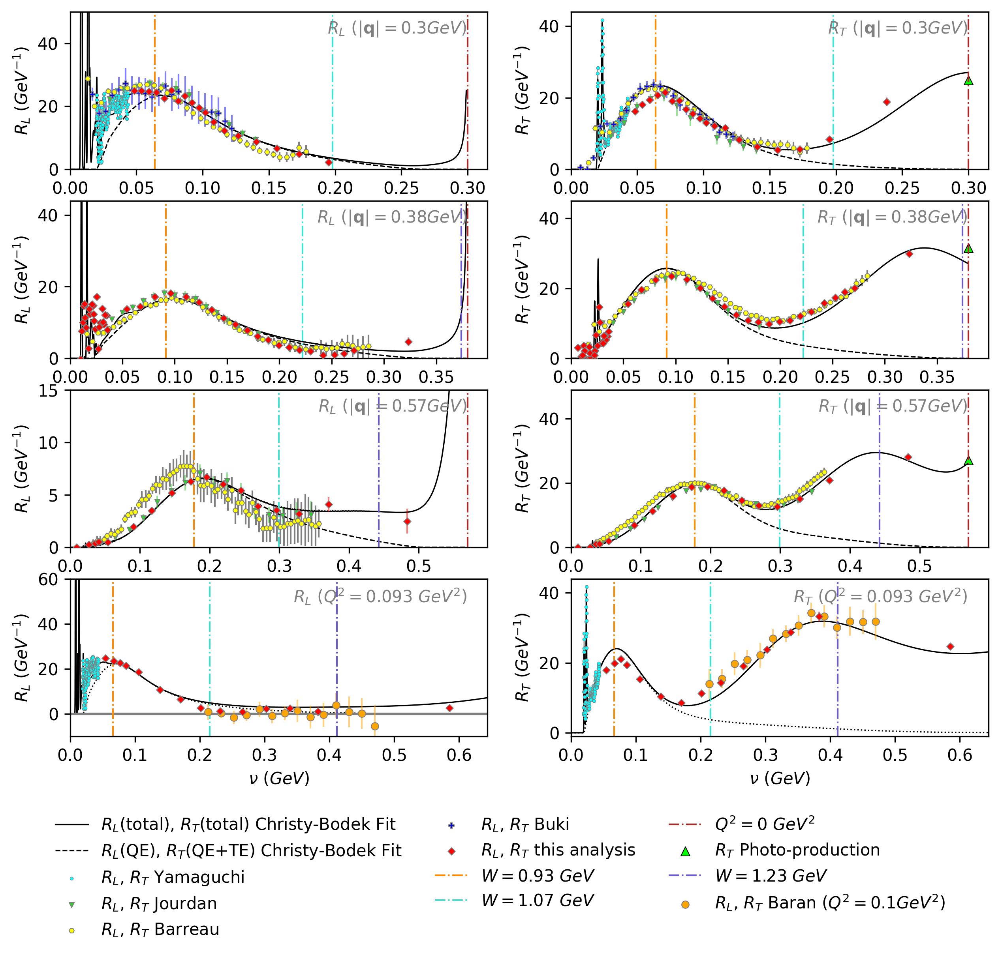

In [38]:
# fig7 6/30/2025
with PdfPages('Carbon/12C_plots/RLRT_PRD/fig7.pdf') as pdf:

    handles = []
    labels = []
    fig, axs = plt.subplots(nrows=4, ncols=2, figsize=(10,9),dpi=300)

    for test in [0]:

        RL_plot_heights = np.array([0.05,0.09,0.08,0.10,0.11, 
            0.05,0.0440, 0.0175, 0.0150,0.01, 
            0.01, 0.015,0.1,0.12,0.08,
            0.05,0.04,0.0125])*1e3
        RT_plot_heights = np.array([0.012,0.027,0.03,0.035,0.041,
            0.044,0.045,0.045,0.049,0.04,
            0.042,0.045,0.045,0.035,0.035,
            0.026,0.015,0.012])*1e3
        QE_left = [0,0,0,0,0,
                0,0,0,0,0,
                0.2,0.2,0.7,1.0,1.2,
                1.5,1.8,2.4]
        QE_right = [0.7,0.7,0.7,0.7,0.7,
                    0.7,0.7,0.7,0.7,0.7,
                    3,0.9,1.5,1.8,2.0,
                    2.3,2.6,3.3]
        RLQE_top = np.array([0.02,0.03,0.04,0.5,0.5,
                        0.02,0.02, 0.08, 0.007,0.003, 
                        0.001, 0.005,0.0012,0.0006,0.0006,
                        0.0003,0.0003,0.0003])*1e3
        RTQE_top = np.array([0.013,0.027,0.03,0.035,0.041,
                        0.044,0.045,0.045,0.049,0.04,
                        0.05,0.02,0.005,0.0025,0.002,
                        0.0015,0.001,0.0008])*1e3



        bin_indices = [5,6,8]

        for i in range(3):
            bin_index = bin_indices[i]
            qvcenter = qvcenters[bin_index]
            if qvcenter in [0.3,0.38,0.475,0.57,0.649,0.756]:
                # fit = pd.read_excel('C12paper_figures/qvbin/RLRT_qv_extractions/qvbin_'+str(qvcenter)+' final.xlsx')        
                fit = pd.concat([RLRT_extract_qv_ex(df,bin_index=bin_index),
                                RLRT_extract_qv_w2(df,bin_index=bin_index)])

            # if qvcenter >= 0.31:
            #     fit = fit.loc[fit['Ex']>=0.03]
            # Christy-Bodek fit RLRT total
            ChristyBodekFit = pd.read_csv('Carbon/Eric/ChristyBodekFit/Qvedges/'+f'Qvedge_{qvcenter}.csv',index_col = False)

            ChristyBodekFit.columns = ['qv','q2','ex','nu','RT','RL','RTQE','RLQE','RTIE','RLIE','RTE','RLE','RTNS','RLNS']    
            ChristyBodekFit['RL'] = ChristyBodekFit['RL']*1e3
            ChristyBodekFit['RLQE'] = ChristyBodekFit['RLQE']*1e3
            ChristyBodekFit['RT'] = ChristyBodekFit['RT']*1e3
            ChristyBodekFit['RTQE'] = ChristyBodekFit['RTQE']*1e3
            ChristyBodekFit['RTE'] = ChristyBodekFit['RTE']*1e3
            ChristyBodekFit['RLIE'] = ChristyBodekFit['RLIE']*1e3
            ChristyBodekFit['RTIE'] = ChristyBodekFit['RTIE']*1e3
            ChristyBodekFit['RLNS'] = ChristyBodekFit['RLNS']*1e3
            ChristyBodekFit['RTNS'] = ChristyBodekFit['RTNS']*1e3

            # Christy-Bodek fit RLRT total
            axs[i,0].plot(ChristyBodekFit['nu'],ChristyBodekFit["RL"],color='black',label="$R_L$(total), $R_T$(total) Christy-Bodek Fit", linestyle='solid',lw=0.8)
            axs[i,1].plot(ChristyBodekFit['nu'],ChristyBodekFit["RT"],color='black', linestyle='solid',lw=0.8)

            # Christy-Bodek fit RLRT QE only

            axs[i,0].plot(ChristyBodekFit['nu'],ChristyBodekFit["RLQE"],color='black',label="$R_L$(QE), $R_T$(QE+TE) Christy-Bodek Fit", linestyle='dashed',lw=0.8) 
            axs[i,1].plot(ChristyBodekFit['nu'],(ChristyBodekFit["RTQE"]+ChristyBodekFit["RTE"]),color='black', linestyle='dashed',lw=0.8)

            # # Christy-Bodek fit RLRT no delta (NS + QE)
            # axs[i,0].plot(ChristyBodekFit['nu'],ChristyBodekFit["RLNS"]+ChristyBodekFit["RLQE"],color='black',label="$R_L$(QE+NS), $R_T$(QE+NS) Christy-Bodek Fit", linestyle='dotted')
            # axs[i,1].plot(ChristyBodekFit['nu'],ChristyBodekFit["RTNS"]+ChristyBodekFit["RTQE"],color='black', linestyle='dotted')
                    
            # Yamaguchi    
            if qvcenter in [0.148,0.167,0.205,0.24,0.3] :
                # Yamaguchi RL
                Yam_data = pd.read_excel('Carbon/12C_other_extractions/Yamaguchi/Yamaguchi_plotting.xlsx',sheet_name='qv_'+str(qvcenter))                    
                Yam_data['RL'] = Yam_data['RL']*1e3
                axs[i,0].scatter(Yam_data['nu_RL'],Yam_data["RL"],color='cyan',label="$R_L$, $R_T$ Yamaguchi",**yam_scatter)
                axs[i,0].plot(Yam_data['nu_RL'],Yam_data["RL"],lw=0.5,color='gray',zorder=-2)
                # Yamaguchi RT
                Yam_data = pd.read_excel('Carbon/12C_other_extractions/Yamaguchi/Yamaguchi_plotting.xlsx',sheet_name='qv_'+str(qvcenter))
                Yam_data['RT'] = Yam_data['RT']*1e3
                axs[i,1].scatter(Yam_data['nu_RT'],Yam_data["RT"],color='cyan',**yam_scatter)
                axs[i,1].plot(Yam_data['nu_RT'],Yam_data["RT"],lw=0.5,color='gray',zorder=-2)
                nu_Yamaguchi = Yam_data['nu_RL'].max()
                fit = fit.loc[fit['nu']>nu_Yamaguchi+0.002]
    
            # Jourdan
            if qvcenter in [0.3,0.38,0.57] :
                Jourdan_data = pd.read_excel('Carbon/12C_other_extractions/Jourdan/Jourdan_RL_RT_plots.xlsx')
                Jourdan_data = Jourdan_data.loc[Jourdan_data['Q']==qvcenter]
                Jourdan_data['RL'] = Jourdan_data['RL']*1e3
                Jourdan_data['RT'] = Jourdan_data['RT']*1e3
                Jourdan_data['Error(RL)'] = Jourdan_data['Error(RL)']*1e3
                Jourdan_data['Error(RT)'] = Jourdan_data['Error(RT)']*1e3
                axs[i,0].scatter(Jourdan_data['nu'],Jourdan_data["RL"],color='limegreen',label="$R_L$, $R_T$ Jourdan", **scatter_setting,marker='v')
                axs[i,0].errorbar(Jourdan_data['nu'],Jourdan_data["RL"], yerr = Jourdan_data["Error(RL)"], color='limegreen', **errorbar_setting)
                axs[i,1].scatter(Jourdan_data['nu'],Jourdan_data["RT"],color='limegreen', **scatter_setting,marker='v')
                axs[i,1].errorbar(Jourdan_data['nu'],Jourdan_data["RT"], yerr = Jourdan_data["Error(RT)"], color='limegreen', **errorbar_setting)

            # Barreau
            if qvcenter in [0.3,0.38,0.57] :
                
                Bar_RL = pd.read_csv('Carbon/12C_other_extractions/Barreau/Barreau_RL_qvcenter_'+str(qvcenter)+'.csv')
                Bar_RT = pd.read_csv('Carbon/12C_other_extractions/Barreau/Barreau_RT_qvcenter_'+str(qvcenter)+'.csv')
                Bar_RL['RLbc'] = Bar_RL['RLbc']*1e3
                Bar_RL['RLerr_bc'] = Bar_RL['RLerr_bc']*1e3
                Bar_RT['RTbc'] = Bar_RT['RTbc']*1e3
                Bar_RT['RTerr_bc'] = Bar_RT['RTerr_bc']*1e3
                axs[i,0].scatter(Bar_RL['nu'],Bar_RL["RLbc"],color='yellow',label="$R_L$, $R_T$ Barreau", **scatter_setting,marker='H')
                axs[i,0].errorbar(Bar_RL['nu'],Bar_RL["RLbc"], yerr = Bar_RL["RLerr_bc"], color='black', **errorbar_setting)
                axs[i,1].scatter(Bar_RT['nu'],Bar_RT["RTbc"],color='yellow', **scatter_setting,marker='H')
                axs[i,1].errorbar(Bar_RT['nu'],Bar_RT["RTbc"], yerr = Bar_RT["RTerr_bc"], color='black', **errorbar_setting)

            # Buki
            if  qvcenter == 0.3 :
                df_Buki = pd.read_csv('Carbon/12C_other_extractions/Buki/Buki.csv')
                df_Buki['RL'] = df_Buki['RL']*1e3
                df_Buki['RT'] = df_Buki['RT']*1e3
                df_Buki['RLerr'] = df_Buki['RLerr']*1e3
                df_Buki['RTerr'] = df_Buki['RTerr']*1e3
                axs[i,0].errorbar(df_Buki['nu_RL'],df_Buki['RL'],yerr=df_Buki['RLerr'],color='blue',**errorbar_setting)
                axs[i,0].scatter(df_Buki['nu_RL'],df_Buki['RL'],color='blue',label="$R_L$, $R_T$ Buki",**scatter_setting,marker='P')
                axs[i,1].errorbar(df_Buki['nu_RT'],df_Buki['RT'],yerr=df_Buki['RTerr'],color='blue',**errorbar_setting)
                axs[i,1].scatter(df_Buki['nu_RT'],df_Buki['RT'],color='blue',**scatter_setting,marker='P')


            # RL RT this analysis


            fit['RL']=fit['RL']*1e3
            fit['RLerr']=fit['RLerr']*1e3
            
            axs[i,0].scatter(fit['nu'], fit['RL'],color='red',label='$R_L$, $R_T$ this analysis',**our_scatter_setting)
            axs[i,0].errorbar(fit['nu'], fit['RL'], yerr = fit['RLerr'], color='red', **errorbar_setting, ecolor='red')

            fit['RT']=fit['RT']*1e3
            fit['RTerr']=fit['RTerr']*1e3
            axs[i,1].scatter(fit['nu'], fit['RT'],color='red',**our_scatter_setting)
            axs[i,1].errorbar(fit['nu'], fit['RT'], yerr = fit['RTerr'], color='red', **errorbar_setting,ecolor='red')
        




            # Photo-production:
            photon_data, photon_data_err = photon_locator(qvcenter)
            axs[i,1].scatter(np.array(qvcenter),np.array(photon_data)*1e3,label="$R_T$ Photo-production",**photo_scatter_setting)
            axs[i,1].errorbar(np.array(qvcenter),np.array(photon_data)*1e3,yerr = np.array(photon_data_err),**errorbar_setting)

            # _________________________

            # These W (final state invariant mass) are put on plot for kinematic reference
            W_peaks = np.array([0.93,1.07,1.23]) 
            W_colors = ['darkorange','turquoise','slateblue']
            W_locations = 0.025-mass_nucleon+np.sqrt(qvcenter**2+W_peaks**2)
            # text_offset=0.1*W_locations[0]
            W_labels = ['','','']
            # RL_plot_height = RL_plot_heights[bin_index]
            # RT_plot_height = RT_plot_heights[bin_index]
            
            for k in range(len(W_peaks)):
                location = W_locations[k]
                if location < qvcenter:
                    axs[i,0].axvline(x=location, color = W_colors[k], linestyle='dashdot',lw=1,label=f'$W={W_peaks[k]}$ $GeV$ '+W_labels[k])
                    axs[i,1].axvline(x=location, color = W_colors[k], linestyle='dashdot',lw=1)
            
            axs[i,0].axvline(x=qvcenter, color = 'brown', linestyle='dashdot',lw=1,label=f'$Q^2=0$ $GeV^2$')
            axs[i,1].axvline(x=qvcenter, color = 'brown', linestyle='dashdot',lw=1)
            axs[i,0].set_xlim(0.0, qvcenter*1.05)
            axs[i,1].set_xlim(0.0, qvcenter*1.05)
            # _________________________

            
            axs[i,0].set_ylim(0,RL_plot_heights[bin_index])
            axs[i,1].set_ylim(0,RT_plot_heights[bin_index])

            # plt.tight_layout()

            h, l = axs[i,0].get_legend_handles_labels()
            handles.extend(h)
            labels.extend(l)
            h, l = axs[i,1].get_legend_handles_labels()
            handles.extend(h)
            labels.extend(l)


            # plot labeling:
            axs[i,0].text(0.95, 0.95,'$R_L \ (|\mathbf{q}|=$'+f'{qvcenter}$GeV)$',transform=axs[i,0].transAxes,ha='right',va='top',color='gray')
            axs[i,1].text(0.95, 0.95,'$R_T \ (|\mathbf{q}|=$'+f'{qvcenter}$GeV)$',transform=axs[i,1].transAxes,ha='right',va='top',color='gray')
            
            axs[i,0].set_ylabel('$R_L \ (GeV^{-1})$')
            axs[i,1].set_ylabel('$R_T \ (GeV^{-1})$')
            axs[i,0].set_xlabel('$\\nu \ (GeV)$')
            axs[i,1].set_xlabel('$\\nu \ (GeV)$')

    for test in [0]:

        W_labels=['','','']

        QE_left = [0,0,0,0,0,
                0,0,0,0,0.1,
                0.05,0.2,0.4,0.7,0.9,
                1.2,1.4,1.7]
        QE_right = [0.7,0.7,0.7,0.7,0.7,
                0.7,0.7,0.7,0.7,0.67,
                0.8,0.9,1.2,1.5,1.8,
                2.0,2.4,2.7]
        RLQE_top = np.array([0.02,0.03,0.04,0.5,0.5,
                0.02,0.02, 0.08, 0.007,0.008, 
                0.005, 0.003,0.0012,0.0006,0.0006,
                0.0003,0.0001,0.00006])*1e3
        RTQE_top = np.array([0.013,0.027,0.03,0.035,0.041,
                0.044,0.045,0.045,0.049,0.03,
                0.03,0.015,0.005,0.003,0.002,
                0.001,0.0007,0.00022])*1e3
        RL_plot_heights = np.array([0.08,0.065,0.08,0.10,0.11,
                0.06,0.032, 0.022, 0.0140,0.08, 
                0.07, 0.04, 0.019,0.012,0.01,   
                0.007, 0.005,0.0025])*1e3
        RT_plot_heights = np.array([0.035,0.033,0.035,0.035,0.041,
                0.044,0.04,0.03,0.03,0.05,
                0.05,0.04,0.025,0.015,0.016,  
                0.01, 0.007,0.004])*1e3

        RL_lower_bounds = np.array([0,-10,-100,-60,-60,-20,-20,
                -10,-6,-6,-6,-6,
                0,0,0,0,0,
                0,0,0])
        RT_lower_bounds = np.array([0,-6,-6,-6,-6,
                -6,-6,-2,-2,
                0,0,0,0,0,
                0,0,0])

        for i in [3]:
            # bin_index = bin_indices[i]
            bin_index = 5

            Q2center = Q2centers[bin_index]
            if Q2center in [0.093,0.265,0.38,0.5]:
                # fit = pd.read_excel('C12paper_figures/Q2bin/RLRT_Q2_extractions/Q2bin_'+str(Q2center)+' final.xlsx')
                fit = pd.concat([RLRT_extract_q2_ex(df,bin_index=bin_index),
                                RLRT_extract_q2_w2(df,bin_index=bin_index)])


            ChristyBodekFit = pd.read_csv('Carbon/Eric/ChristyBodekFit/Q2edges/'+f'Q2edge_{Q2center}.csv',index_col = False)
            ChristyBodekFit.columns = ['qv','q2','ex','nu','RT','RL','RTQE','RLQE','RTIE','RLIE','RTE','RLE','RTNS','RLNS']
            ChristyBodekFit['RL'] = ChristyBodekFit['RL']*1e3
            ChristyBodekFit['RLQE'] = ChristyBodekFit['RLQE']*1e3
            ChristyBodekFit['RT'] = ChristyBodekFit['RT']*1e3
            ChristyBodekFit['RTQE'] = ChristyBodekFit['RTQE']*1e3
            ChristyBodekFit['RTE'] = ChristyBodekFit['RTE']*1e3
            # RLRT total
            axs[i,0].plot(ChristyBodekFit['nu'],ChristyBodekFit["RL"],color='black',label="$R_L$(total), $R_T$(total) Christy-Bodek Fit", linestyle='solid',zorder=0,lw=0.8)
            axs[i,1].plot(ChristyBodekFit['nu'],ChristyBodekFit["RT"],color='black', linestyle='solid',zorder=0,lw=0.8)
            # RLRT QE
            axs[i,0].plot(ChristyBodekFit['nu'],ChristyBodekFit["RLQE"],color='black',label="$R_L$(QE), $R_T$(QE+TE) Christy-Bodek Fit", linestyle='dotted',zorder=0,lw=0.8) 
            axs[i,1].plot(ChristyBodekFit['nu'],ChristyBodekFit["RTQE"]+ChristyBodekFit["RTE"],color='black', linestyle='dotted',zorder=0,lw=0.8)
            
            # Yamaguchi
            Yama_qvcenter = qvcenters[bin_index]
            
            if Yama_qvcenter in [0.148,0.167,0.205,0.24,0.3]:
                # Yamaguchi RL

                Yam_data = pd.read_excel('Carbon/12C_other_extractions/Yamaguchi/Yamaguchi_plotting.xlsx',sheet_name='qv_'+str(Yama_qvcenter))                    
                Yam_data['RL'] = Yam_data['RL']*1e3
                axs[i,0].scatter(Yam_data['nu_RL'],Yam_data["RL"],color='cyan',label="$R_L$, $R_T$ Yamaguchi",**yam_scatter)
                axs[i,0].plot(Yam_data['nu_RL'],Yam_data["RL"],lw=0.5,color='gray',zorder=-1)
                # Yamaguchi RT
                Yam_data = pd.read_excel('Carbon/12C_other_extractions/Yamaguchi/Yamaguchi_plotting.xlsx',sheet_name='qv_'+str(Yama_qvcenter))
                Yam_data['RT'] = Yam_data['RT']*1e3
                axs[i,1].scatter(Yam_data['nu_RT'],Yam_data["RT"],color='cyan',**yam_scatter)
                axs[i,1].plot(Yam_data['nu_RT'],Yam_data["RT"],lw=0.5,color='gray',zorder=-1)
                fit = fit.loc[fit['nu']>=Yam_data['nu_RL'].max()]

            # RL this analysis

            fit['RL']=fit['RL']*1e3
            fit['RLerr']=fit['RLerr']*1e3
            fit['RT']=fit['RT']*1e3
            fit['RTerr']=fit['RTerr']*1e3
            axs[i,0].scatter(fit['nu'], fit['RL'],color='red',label='$R_L$, $R_T$ this analysis',**our_scatter_setting)
            axs[i,0].errorbar(fit['nu'], fit['RL'], yerr = fit['RLerr'], color='red', **errorbar_setting)


            # RT this analysis
            axs[i,1].scatter(fit['nu'], fit['RT'],color='red',**our_scatter_setting)
            axs[i,1].errorbar(fit['nu'], fit['RT'], yerr = fit['RTerr'], ecolor='red',  **errorbar_setting)


            # Baran
            if Q2center==0.093:
                axs[i,0].axhline(y=0, color='grey', linestyle='-')
                Baran = pd.read_csv('Carbon/12C_other_extractions/Baran/BaranRLRT.txt',sep='\s+')
                Baran['RL'] = Baran['RL']
                Baran['RLerr'] = Baran['RLerr']
                Baran['RT'] = Baran['RT']
                Baran['RTerr'] = Baran['RTerr']
                # baran_scatter_setting = {'s':30,'edgecolors':'black','linewidth':0.5,'zorder':3,'alpha':1}
                axs[i,0].scatter(Baran['nuRL'], Baran['RL'],color='orange',label='$R_L$, $R_T$ Baran ($Q^2=0.1GeV^2$)',**baran_scatter_setting)
                axs[i,0].errorbar(Baran['nuRL'], Baran['RL'], yerr = Baran['RLerr'], ecolor='orange', **errorbar_setting)
                axs[i,1].scatter(Baran['nuRT'], Baran['RT'],color='orange',**baran_scatter_setting)
                axs[i,1].errorbar(Baran['nuRT'], Baran['RT'], yerr = Baran['RTerr'], ecolor='orange', **errorbar_setting)


            W_peaks = np.array([0.93,1.07,1.23]) 
            W_colors = ['darkorange','turquoise','slateblue']
            W_locations = 0.025 + (W_peaks**2+Q2center-mass_nucleon**2)/(2*mass_nucleon)

            for k in range(len(W_peaks)):

                location = W_locations[k]
                # if location < fit['nu'].max():
                axs[i,0].axvline(x=location, color = W_colors[k], linestyle='dashdot',lw=1,label=f'$W={W_peaks[k]}$ $GeV$ '+W_labels[k])
                axs[i,1].axvline(x=location, color = W_colors[k], linestyle='dashdot',lw=1)

            if fit['nu'].max() > W_locations[2]:
                xmax = fit['nu'].max()*1.1
                axs[i,0].set_xlim(0.0, xmax)
                axs[i,1].set_xlim(0.0, xmax)

            else:
                axs[i,0].set_xlim(0.0, W_locations[2]*1.1)
                axs[i,1].set_xlim(0.0, W_locations[2]*1.1)

            axs[i,0].set_ylim(-10,RL_plot_heights[bin_index])
            axs[i,1].set_ylim(-1,RT_plot_heights[bin_index])


            # plot labeling:
            axs[i,0].text(0.95, 0.95,f'$R_L \ (Q^2=${Q2center} $GeV^2$)',transform=axs[i,0].transAxes,ha='right',va='top',color='gray')
            axs[i,1].text(0.95, 0.95,f'$R_T \ (Q^2=${Q2center} $GeV^2$)',transform=axs[i,1].transAxes,ha='right',va='top',color='gray')

            axs[i,0].set_ylabel('$R_L \ (GeV^{-1})$')
            axs[i,1].set_ylabel('$R_T \ (GeV^{-1})$')
            axs[i,0].set_xlabel('$\\nu \ (GeV)$')
            axs[i,1].set_xlabel('$\\nu \ (GeV)$')


            h, l = axs[i,0].get_legend_handles_labels()
            handles.extend(h)
            labels.extend(l)
            h, l = axs[i,1].get_legend_handles_labels()
            handles.extend(h)
            labels.extend(l)
        # unique_handles = []
        # unique_labels = []
        # for label in labels:
        #     if label not in unique_labels:
        #         unique_labels.append(label)
        #         if label == 'RL, RT GENIE-LFG':
        #             # 's':12,'edgecolors':'black','linewidth':0.5,'zorder':3,'alpha':1
        #             unique_handles.append(plt.Line2D([0], [0], color='violet', linestyle='-', marker='s',  linewidth=2,alpha=0.7,markersize=6))
        #         elif label == 'RL, RT GENIE-SUSA':
        #             unique_handles.append(plt.Line2D([0], [0], color='green', linestyle='-', marker='*',  linewidth=2,alpha=0.7, markersize=6))
        #         else:
        #             unique_handles.append(handles[labels.index(label)])
        #         # unique_handles.append(handles[labels.index(label)])

        # fig.legend(unique_handles, unique_labels, loc='lower center', ncol=4,frameon=False)
        # plt.tight_layout()
        # plt.subplots_adjust(bottom=0.15)
        # plt.show()


    unique_handles = []
    unique_labels = []
    for label in labels:
        if label not in unique_labels:
            unique_labels.append(label)
            unique_handles.append(handles[labels.index(label)])

    # print(unique_labels)
    fig.legend(unique_handles, unique_labels, loc='lower center', ncol=3,frameon=False)
    # plt.tight_layout()
    plt.subplots_adjust(bottom=0.2)
    plt.show()
    pdf.savefig(fig)



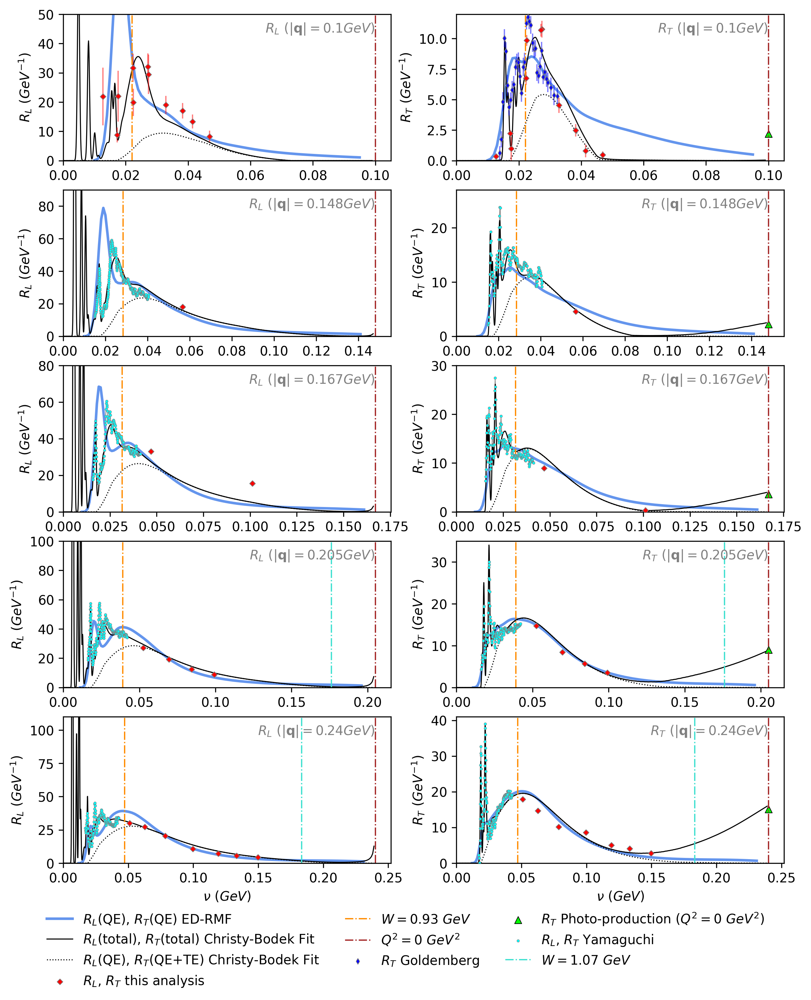

In [18]:
# fig8
with PdfPages('Carbon/12C_plots/RLRT_PRD/fig8.pdf') as pdf:
    fig = RLRT_plot_qvbin(df,bin_indices=[0,1,2,3,4],
                        #   legend_ncol=3, 
                          EDRMF_Tania_plot=True,
                    Jourdan_plot=True, Barreau_plot=True,Buki_plot=True)
    pdf.savefig(fig)

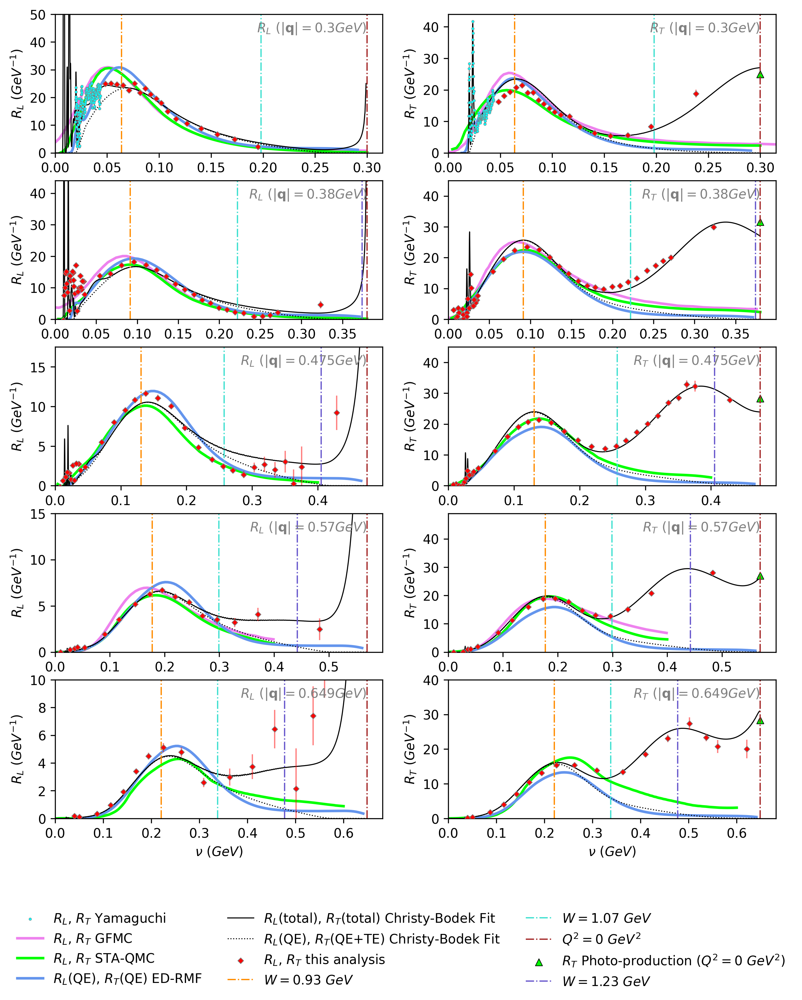

In [19]:
# fig9
with PdfPages('Carbon/12C_plots/RLRT_PRD/fig9.pdf') as pdf:
    fig = RLRT_plot_qvbin(df,bin_indices=[5,6,7,8,9], GFMC_plot=True, EDRMF_Tania_plot=True, STA_plot=True)
    pdf.savefig(fig)

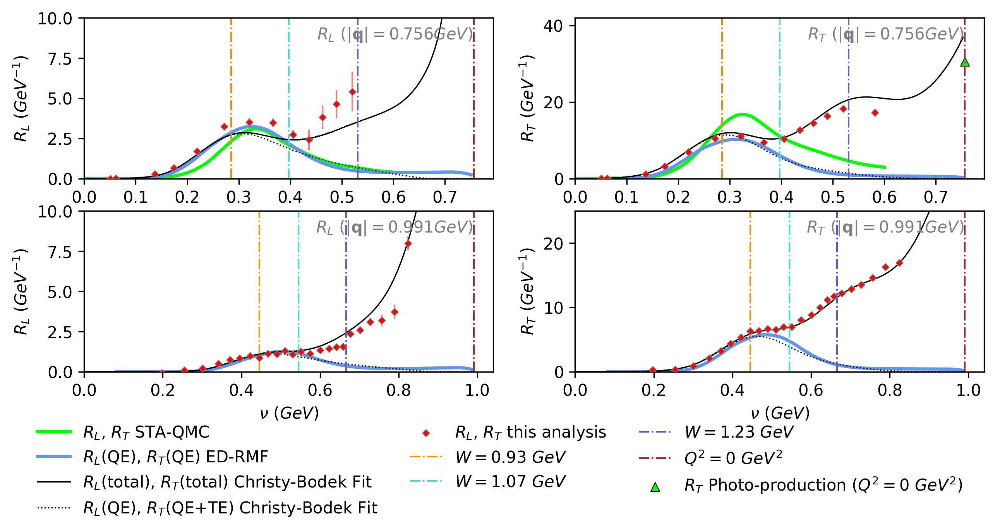

In [20]:
# fig10
with PdfPages('Carbon/12C_plots/RLRT_PRD/fig10.pdf') as pdf:
    fig = RLRT_plot_qvbin(df,bin_indices=[10,11],figsize=(10,5),
                          subplots_adjust=0.27,  
                          GFMC_plot=True, EDRMF_Tania_plot=True,STA_plot=True)
    pdf.savefig(fig)

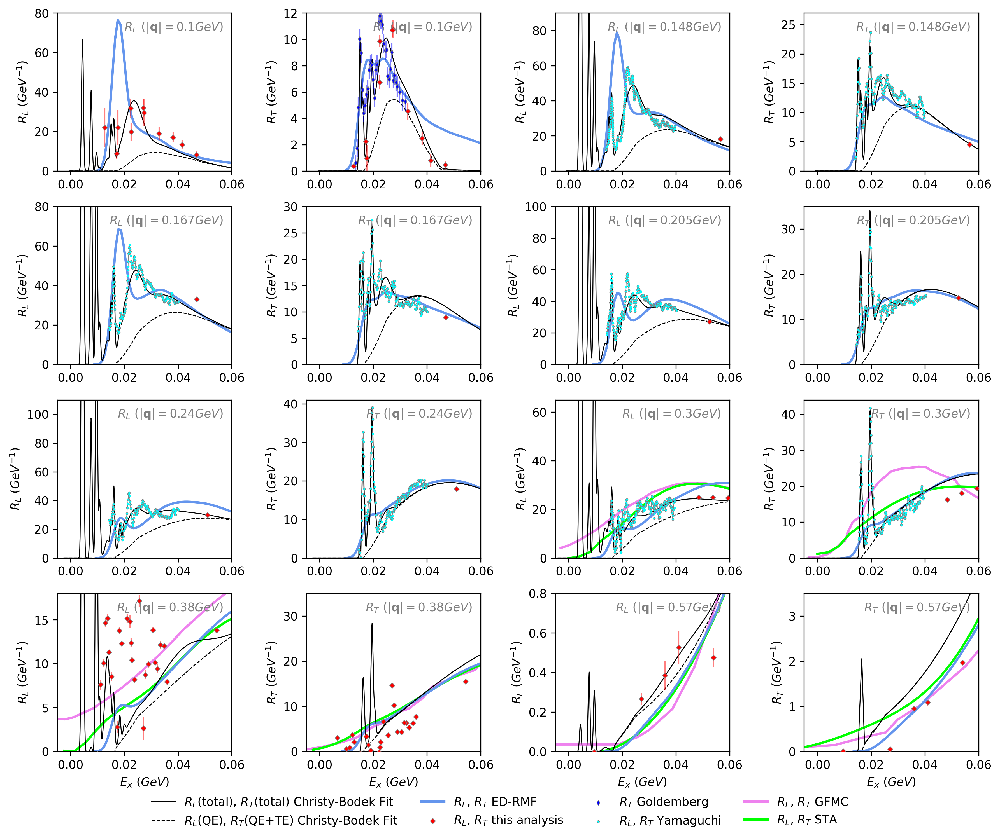

In [125]:
# fig11
with PdfPages('Carbon/12C_plots/RLRT_PRD/fig11.pdf') as pdf:
    fig = RLRT_plot_qvbin_ex(df,bin_indices=[0,1,2,3,4,5,6,8],
                             subplots_adjust=0.1,
                             GFMC_plot=True,EDRMF_Tania_plot=True,ChristyBodekFit_plot = True, STA_plot=True)
    pdf.savefig(fig)

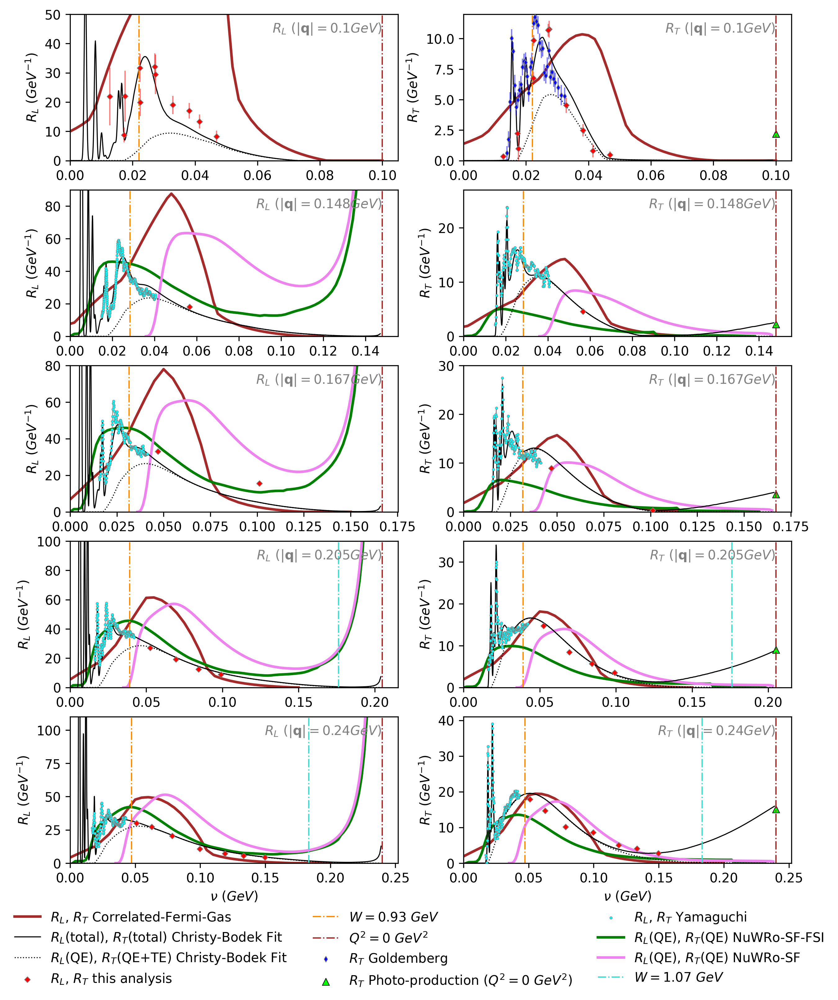

In [22]:
# fig12
with PdfPages('Carbon/12C_plots/RLRT_PRD/fig12.pdf') as pdf:
    fig = RLRT_plot_qvbin(df,bin_indices=[0,1,2,3,4],subplots_adjust=0.12,NuWRo_SF_FSI_plot=True, NuWRo_SF_plot=True, CFG_plot=True,ACHILLES_plot=True)
    pdf.savefig(fig)

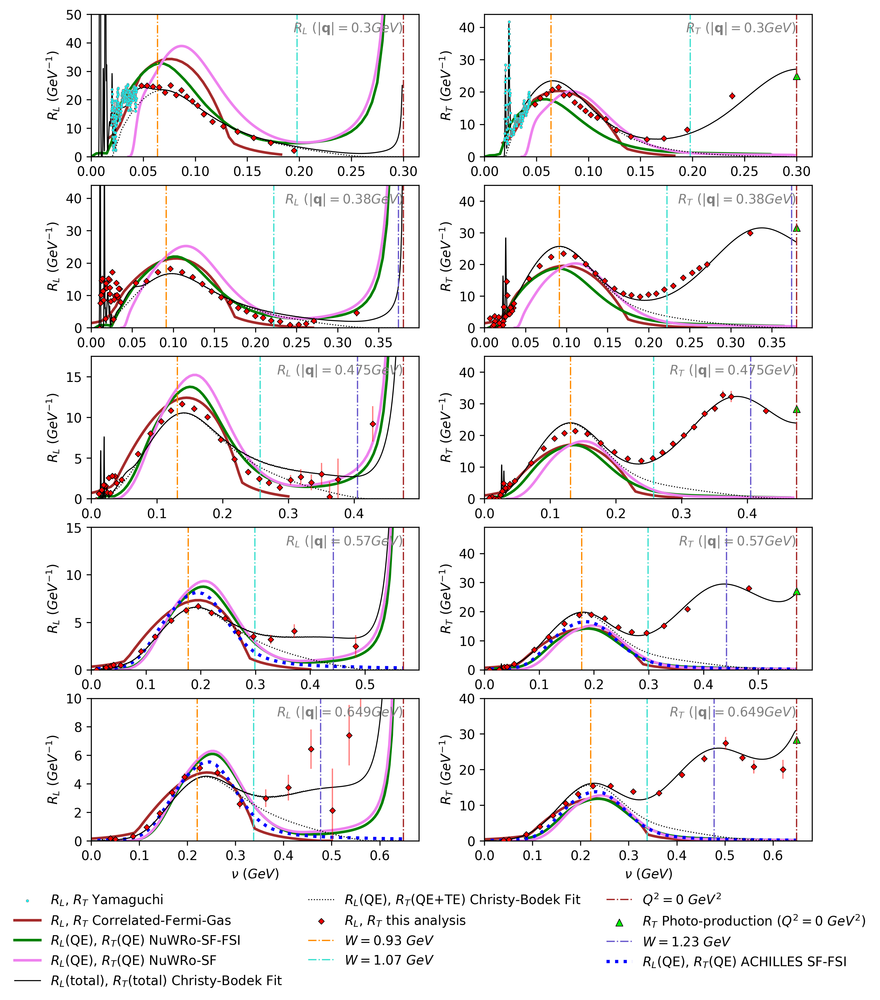

In [187]:
# fig13
with PdfPages('Carbon/12C_plots/RLRT_PRD/fig13.pdf') as pdf:
    fig = RLRT_plot_qvbin(df,bin_indices=[5,6,7,8,9],subplots_adjust=0.14,NuWRo_SF_FSI_plot=True, NuWRo_SF_plot=True, CFG_plot=True,ACHILLES_plot=True)
    pdf.savefig(fig)

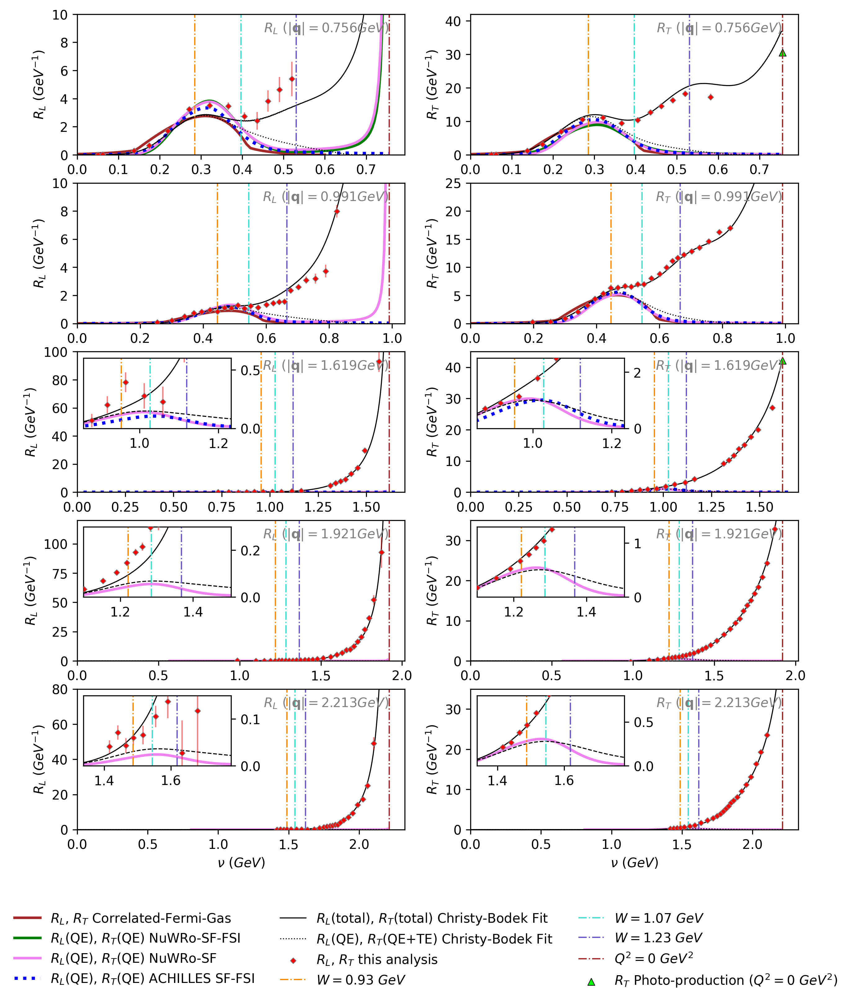

In [23]:
# fig14
with PdfPages('Carbon/12C_plots/RLRT_PRD/fig14.pdf') as pdf:
    fig = RLRT_plot_qvbin(df,bin_indices=[10,11,12,13,14],subplots_adjust=0.15,NuWRo_SF_FSI_plot=True, NuWRo_SF_plot=True, CFG_plot=True,ACHILLES_plot=True)
    pdf.savefig(fig)

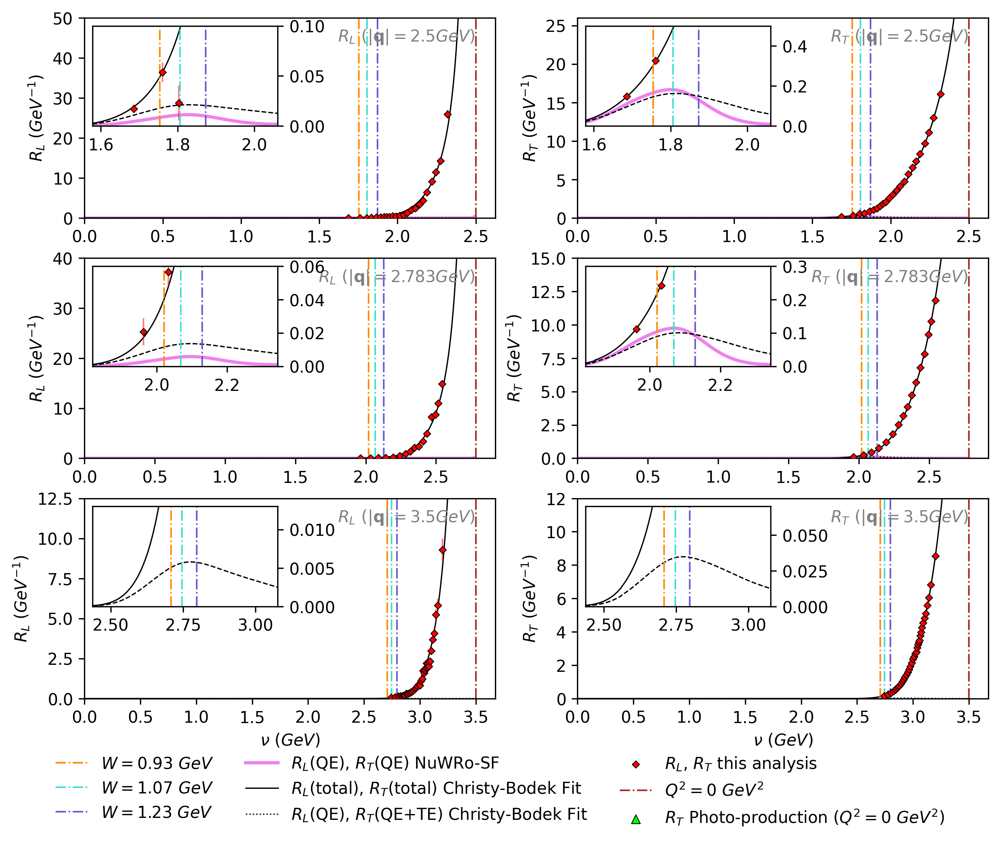

In [220]:
# fig15
with PdfPages('Carbon/12C_plots/RLRT_PRD/fig15.pdf') as pdf:
    fig = RLRT_plot_qvbin(df,bin_indices=[15,16,17],figsize=(10,8),subplots_adjust=0.15,NuWRo_SF_FSI_plot=True, NuWRo_SF_plot=True, CFG_plot=True,ACHILLES_plot=True)
    pdf.savefig(fig)

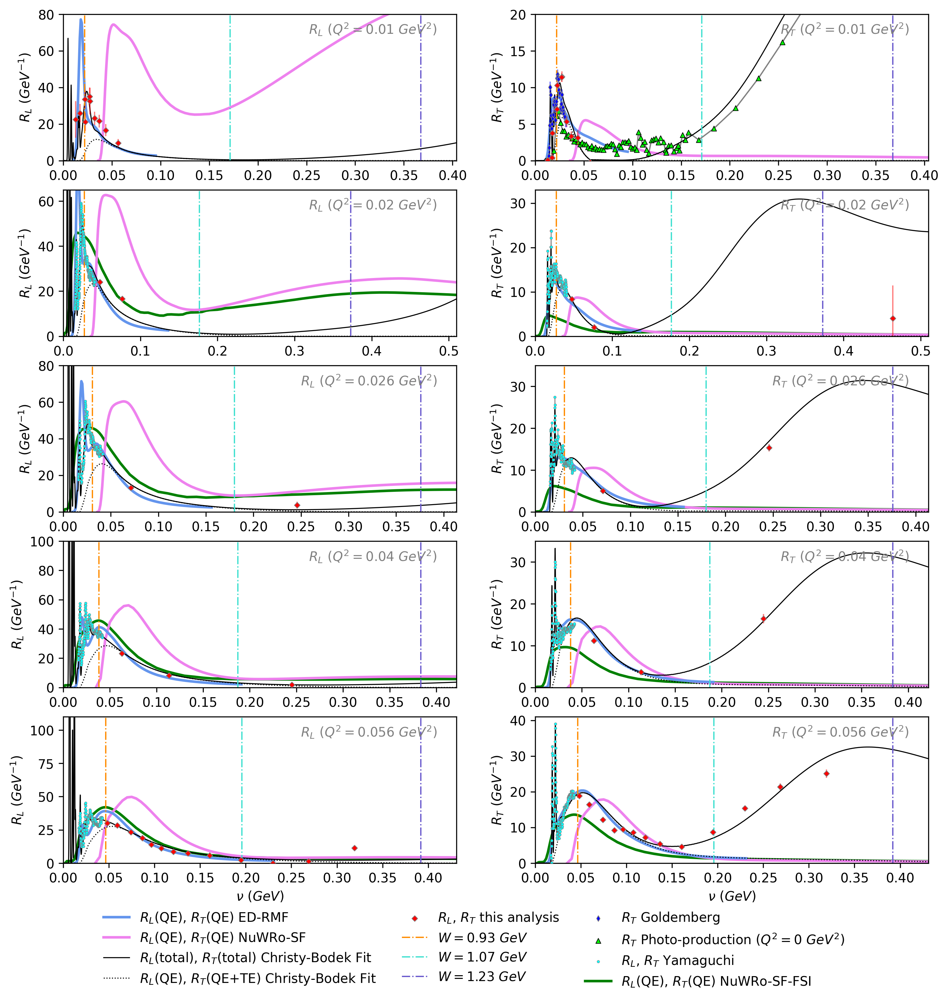

In [56]:
# fig16
with PdfPages('Carbon/12C_plots/RLRT_PRD/fig16.pdf') as pdf:
    fig = RLRT_plot_Q2bin(df=df,bin_indices=[0,1,2,3,4],
        # figsize=(8,8),
        # subplot_adjust=0.16,
        NuWRo_SF_plot=True,
        EDRMF_Tania_plot=True, NuWRo_SF_FSI_plot=True)
    pdf.savefig(fig)

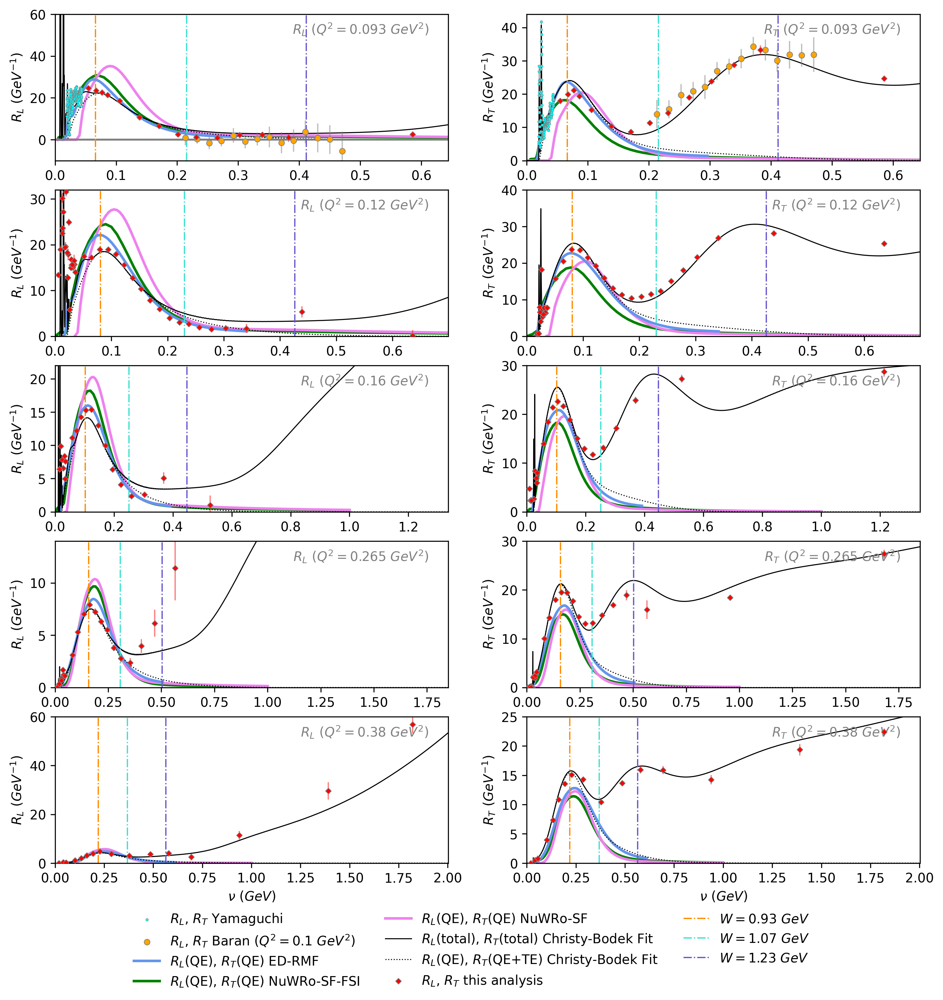

In [84]:
# fig17
with PdfPages('Carbon/12C_plots/RLRT_PRD/fig17.pdf') as pdf:
    fig = RLRT_plot_Q2bin(df=df,bin_indices=[5,6,7,8,9],
        # figsize=(8,8),
        subplots_adjust=0.12,
        NuWRo_SF_plot=True,
        EDRMF_Tania_plot=True, NuWRo_SF_FSI_plot=True)
    pdf.savefig(fig)

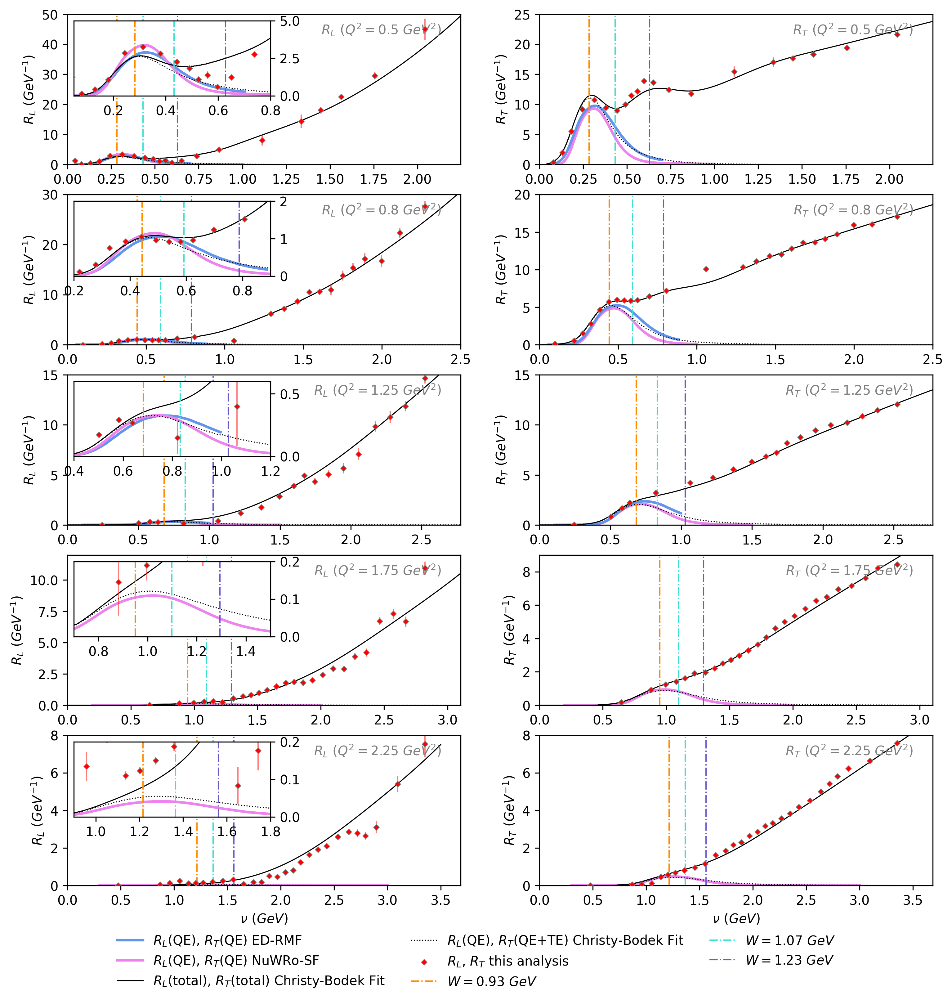

In [110]:
# fig18
with PdfPages('Carbon/12C_plots/RLRT_PRD/fig18.pdf') as pdf:
    fig = RLRT_plot_Q2bin(df=df,bin_indices=[10,11,12,13,14],
        # figsize=(8,8),
        subplots_adjust=0.1,
        NuWRo_SF_plot=True,
        EDRMF_Tania_plot=True, NuWRo_SF_FSI_plot=True)
    pdf.savefig(fig)

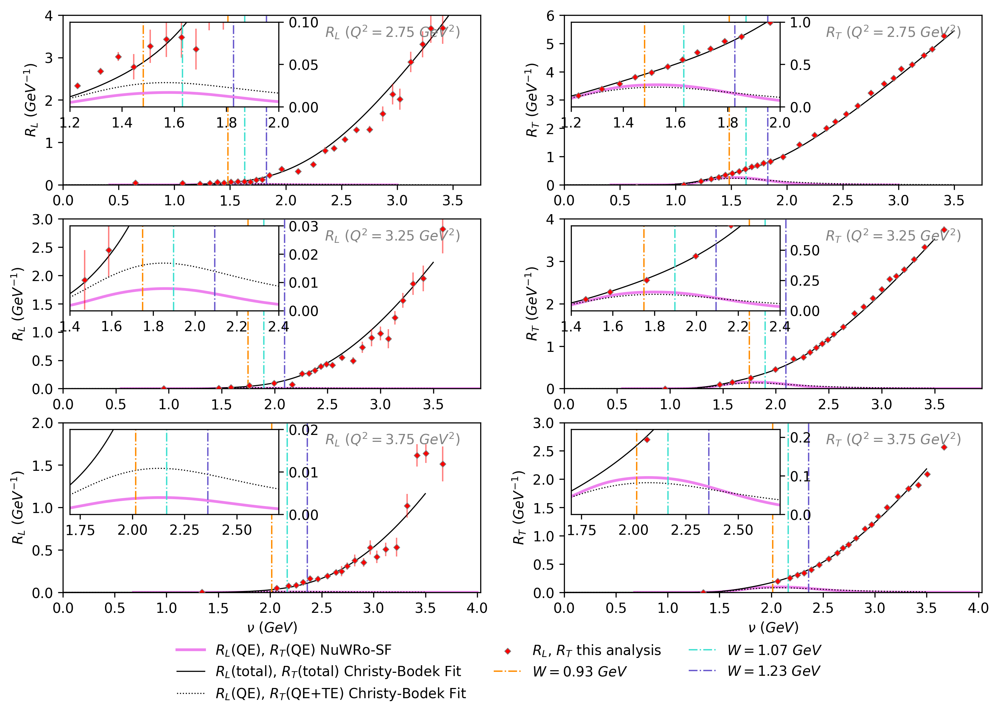

In [106]:
# fig19
with PdfPages('Carbon/12C_plots/RLRT_PRD/fig19.pdf') as pdf:
    fig = RLRT_plot_Q2bin(df=df,bin_indices=[15,16,17],
        figsize=(12,8),
        subplots_adjust=0.15,
        NuWRo_SF_plot=True,
        EDRMF_Tania_plot=True, NuWRo_SF_FSI_plot=True)
    pdf.savefig(fig)

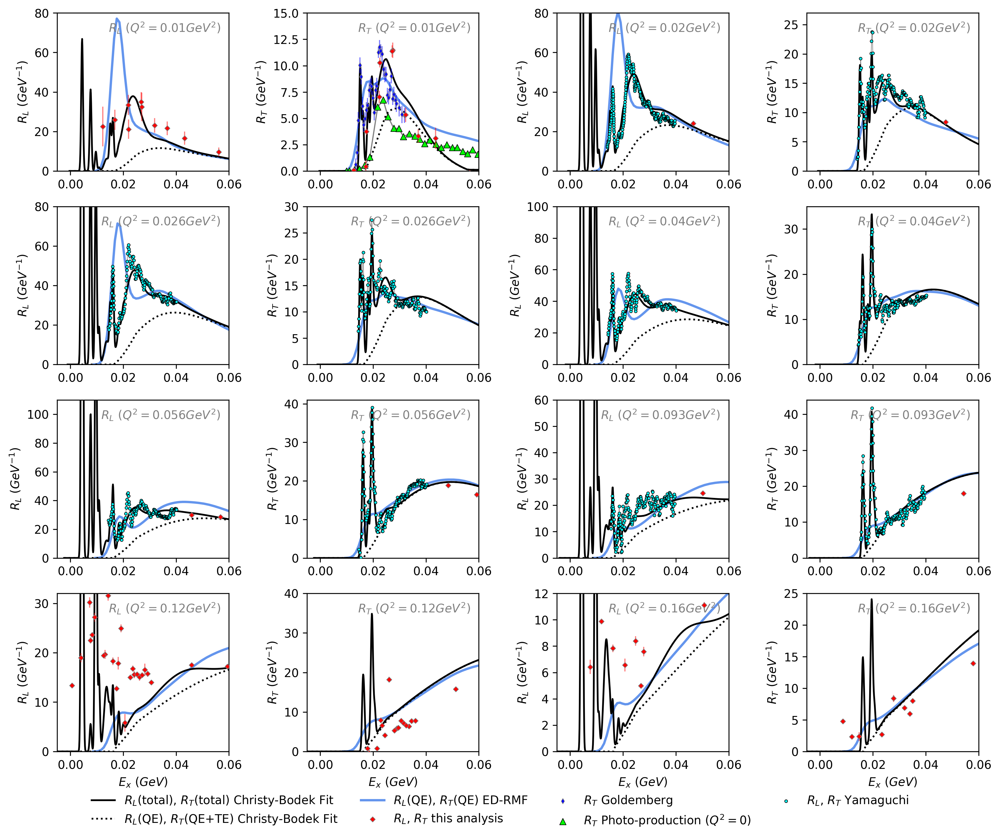

In [137]:
# fig20
with PdfPages('Carbon/12C_plots/RLRT_PRD/fig20.pdf') as pdf:
    fig = RLRT_plot_Q2bin_ex(df=df,bin_indices=[0,1,2,3,4,5,6,7],Rosenbluth_plot=False, Yamaguchi_plot=True,Photon_plot=True,subplots_adjust=0.1,
                        Goldemberg_plot=True, EDRMF_Tania_plot=True,NuWRo_SF_FSI_plot=False, NuWRo_SF_plot=False)
    pdf.savefig(fig)

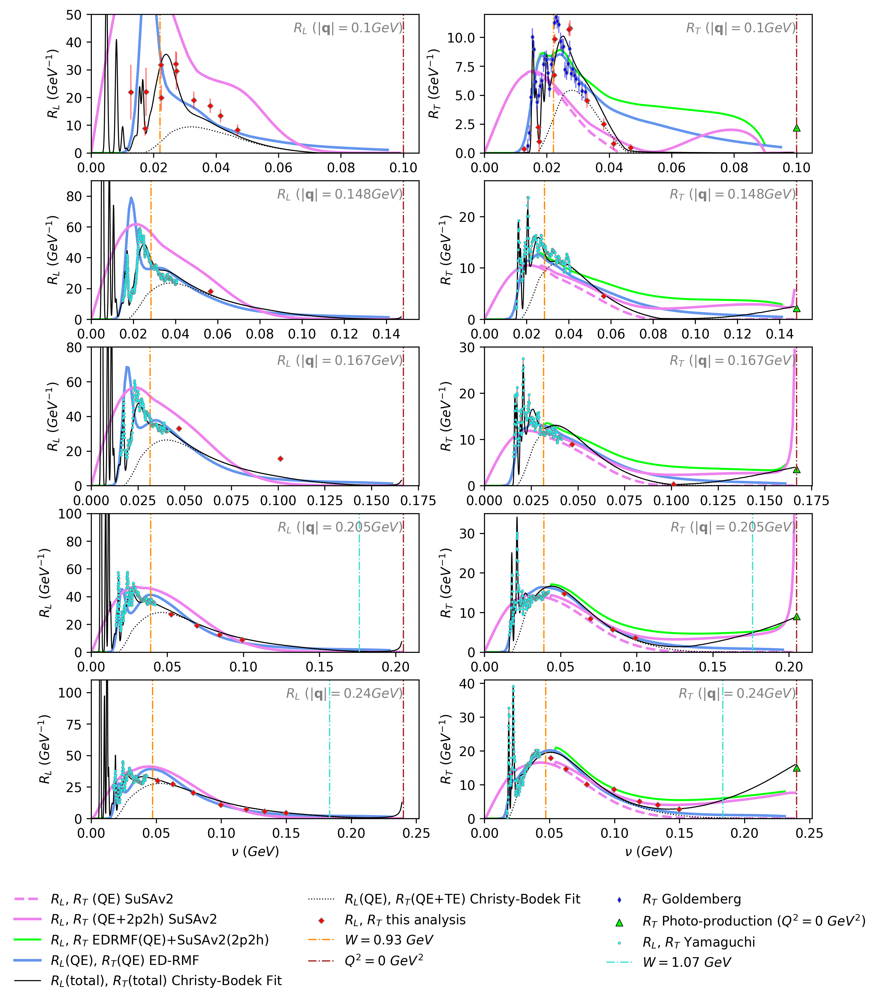

In [158]:
# fig 21
with PdfPages('Carbon/12C_plots/RLRT_PRD/fig21.pdf') as pdf:
    fig = RLRT_plot_qvbin(df,bin_indices=[0,1,2,3,4],
                        subplots_adjust=0.16,
                        EDRMF_Tania_plot=True,
                        # SuSA_extract_RLRT=True,
                        SuSAv2_plot=True, 
                        EDRMF_SuSA2p2h_plot=True
    )
    pdf.savefig(fig)

In [ ]:

# fig 21-24
with PdfPages('Carbon/12C_plots/RLRT_PRD/fig21.pdf') as pdf:
    fig = RLRT_plot_qvbin(df,bin_indices=[0,1,2,3,4],subplot_adjust=0.16, legend_ncol=3, figsize=(8,9), Rosenbluth_plot=False, Goldemberg_plot=True,
                            SuSA_extract_RLRT=True, Susa_plot=True, Susa_drop_negative=False, STA_plot=False,RMF_Tania_plot=False,EDRMF_SuSA2p2h_plot=False)
    pdf.savefig(fig)
with PdfPages('Carbon/12C_plots/RLRT_PRD/fig22.pdf') as pdf:
    fig = RLRT_plot_qvbin(df,bin_indices=[5,6,7,8,9],subplot_adjust=0.16, legend_ncol=3, figsize=(8,9), Rosenbluth_plot=False, Goldemberg_plot=True,
                            SuSA_extract_RLRT=True, Susa_plot=True, Susa_drop_negative=False, STA_plot=False,RMF_Tania_plot=False,EDRMF_SuSA2p2h_plot=False)
    pdf.savefig(fig)
with PdfPages('Carbon/12C_plots/RLRT_PRD/fig23.pdf') as pdf:
    fig = RLRT_plot_qvbin(df,bin_indices=[10,11,12,13,14],subplot_adjust=0.16, legend_ncol=3, figsize=(8,9), Rosenbluth_plot=False, Goldemberg_plot=True,
                            SuSA_extract_RLRT=True, Susa_plot=True, Susa_drop_negative=False, STA_plot=False,RMF_Tania_plot=False,EDRMF_SuSA2p2h_plot=False)
    pdf.savefig(fig)
with PdfPages('Carbon/12C_plots/RLRT_PRD/fig24.pdf') as pdf:
    fig = RLRT_plot_qvbin(df,bin_indices=[15,16,17],subplot_adjust=0.25, legend_ncol=3, figsize=(8,6), Rosenbluth_plot=False, Goldemberg_plot=True,
                            SuSA_extract_RLRT=True, Susa_plot=True, Susa_drop_negative=False, STA_plot=False,RMF_Tania_plot=False,EDRMF_SuSA2p2h_plot=False)
    pdf.savefig(fig)
# with PdfPages('Carbon/12C_plots/RLRT_PRD/susa_q_keep_negative.pdf') as pdf:
#     for bin_indices in [[0,1,2,3,4],[5,6,7,8,9],[10,11,12,13,14]]:
#         fig = RLRT_plot_qvbin(df,bin_indices=bin_indices,subplot_adjust=0.16, legend_ncol=3, figsize=(8,9), Rosenbluth_plot=False, Goldemberg_plot=False,
#                               Susa_plot=True, Susa_drop_negative=False, STA_plot=False,RMF_Tania_plot=True,EDRMF_SuSA2p2h_plot=True)
#         pdf.savefig(fig)
#     fig = RLRT_plot_qvbin(df,bin_indices=[15,16,17],subplot_adjust=0.25, legend_ncol=3, figsize=(8,6), Rosenbluth_plot=False, Goldemberg_plot=False,Susa_plot=True, 
#                           Susa_drop_negative=False, STA_plot=False,RMF_Tania_plot=True,EDRMF_SuSA2p2h_plot=True)
#     pdf.savefig(fig)


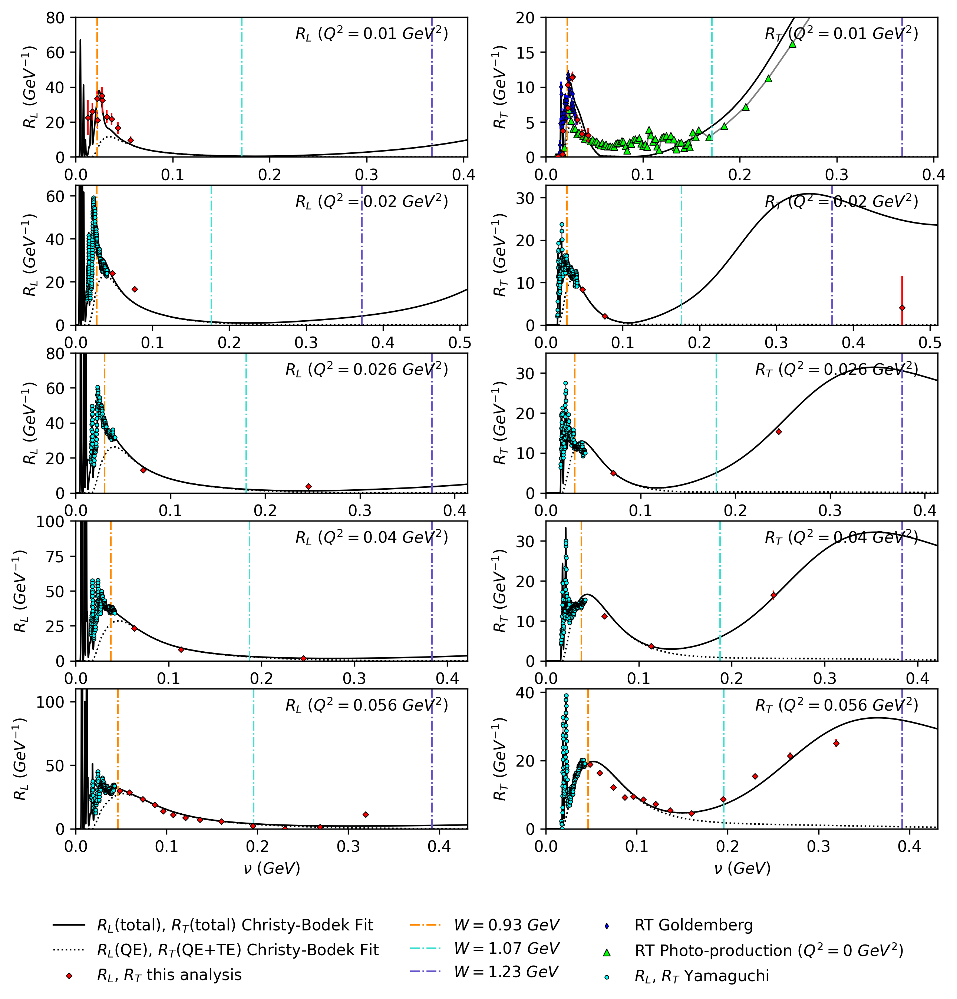

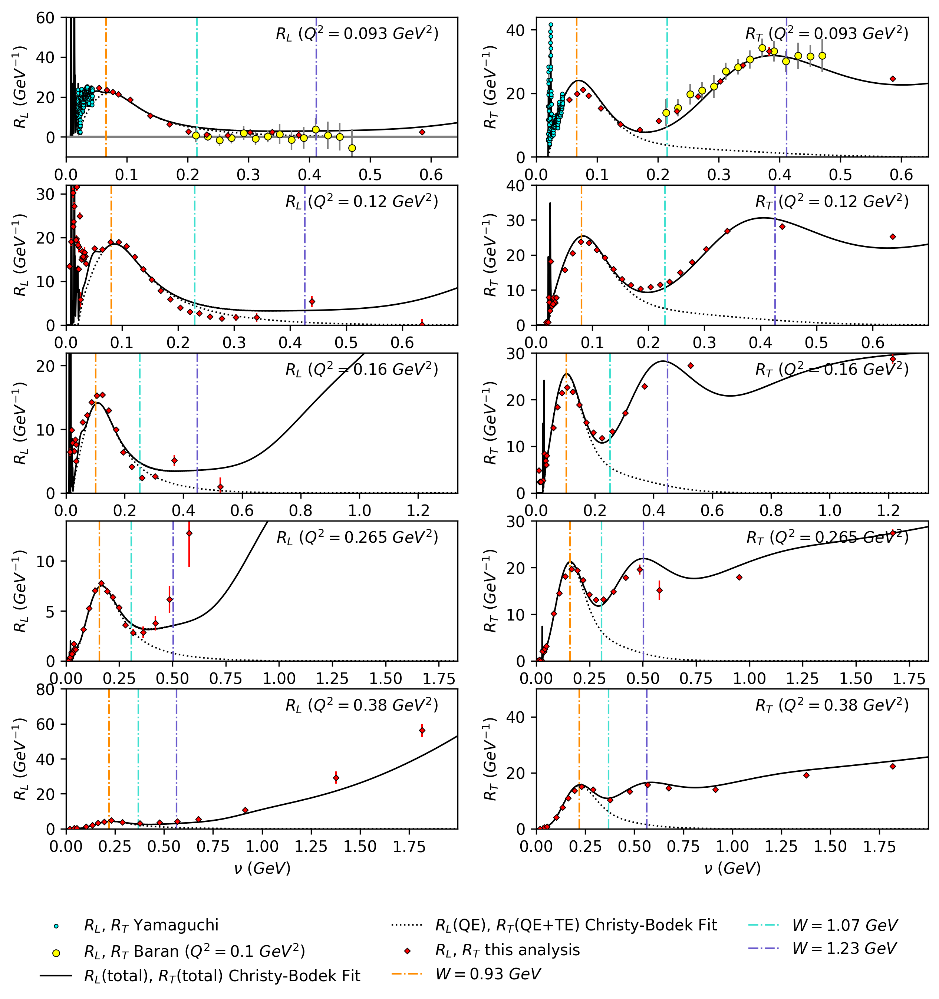

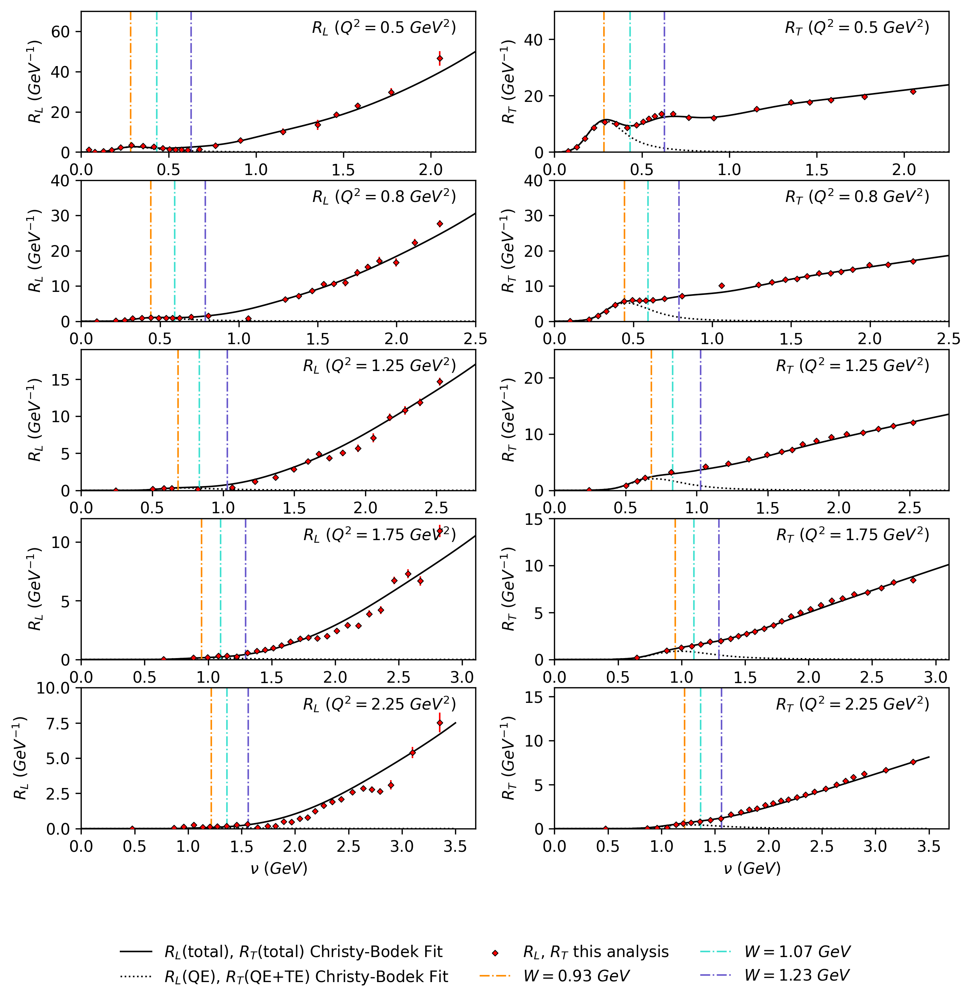

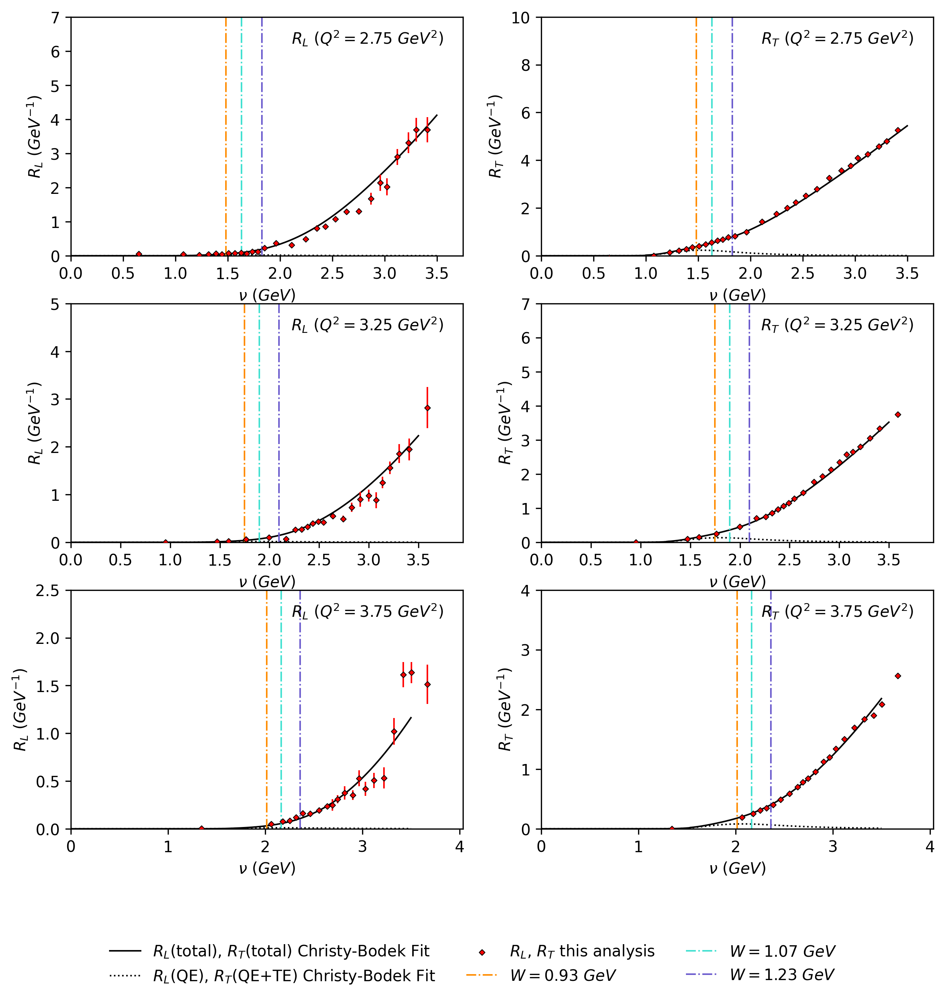

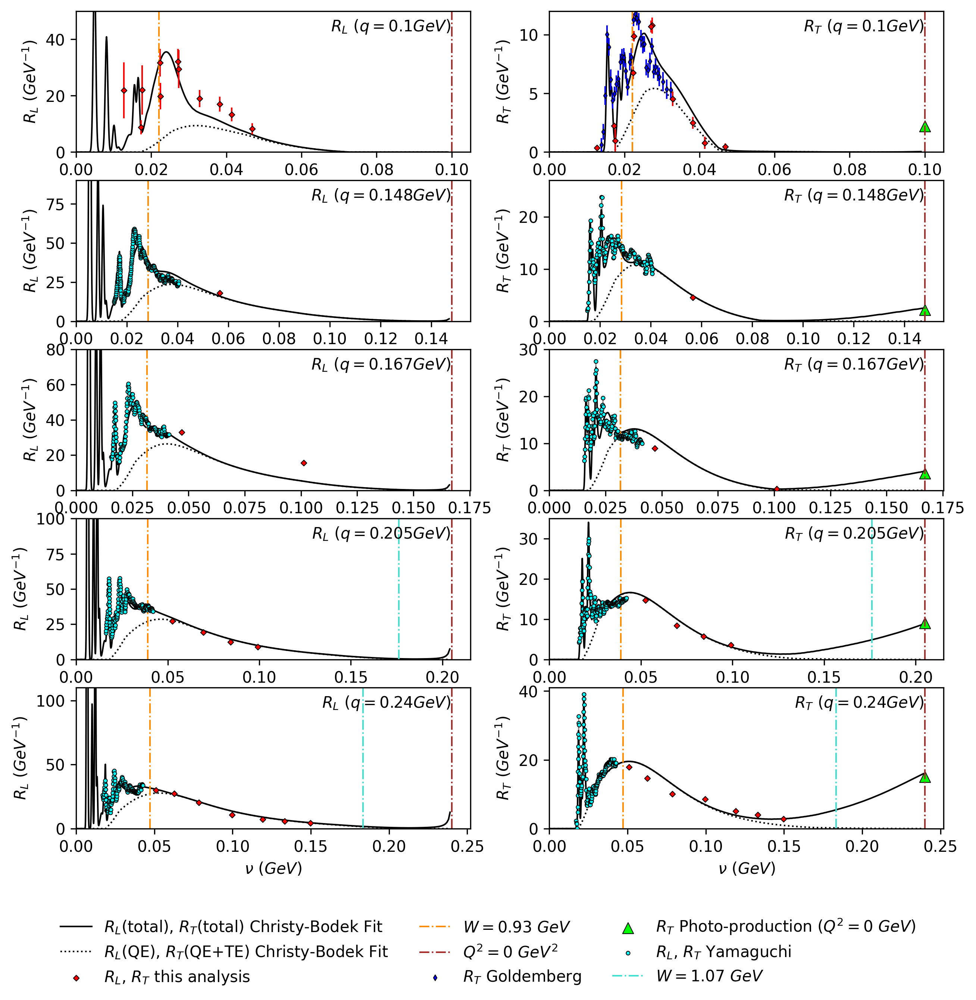

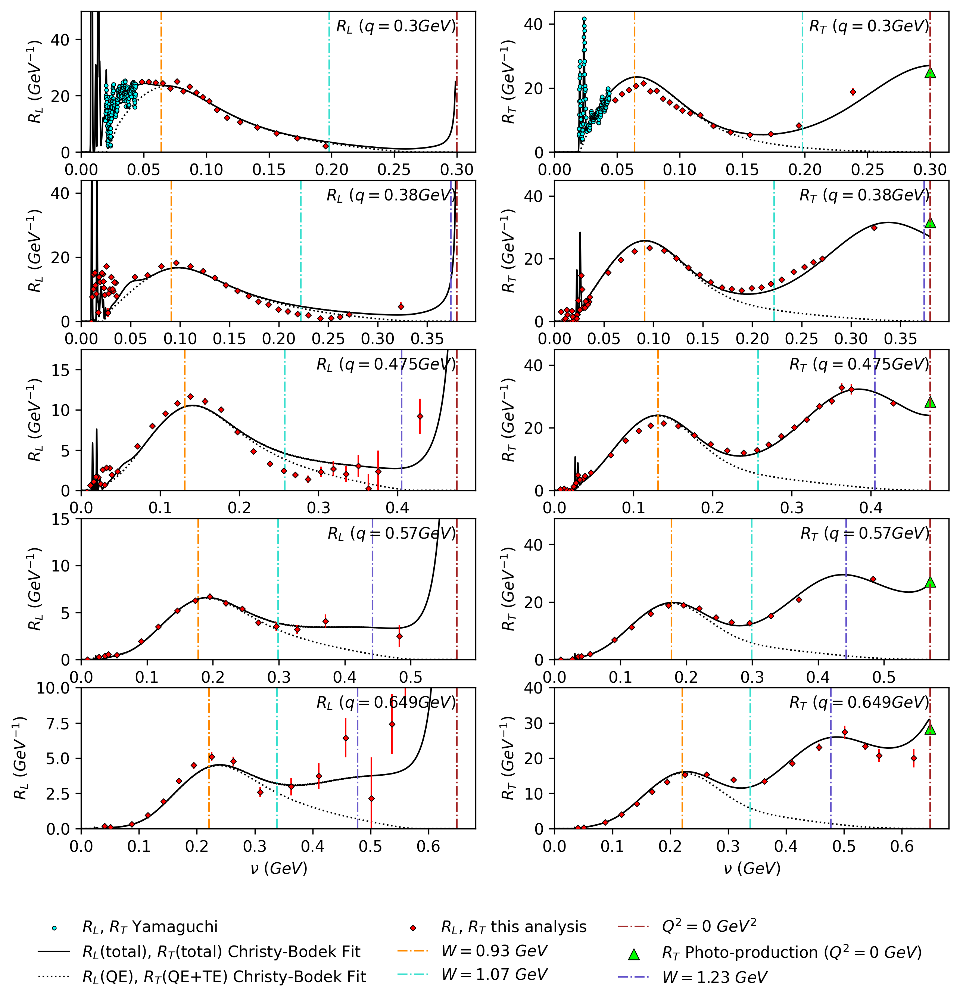

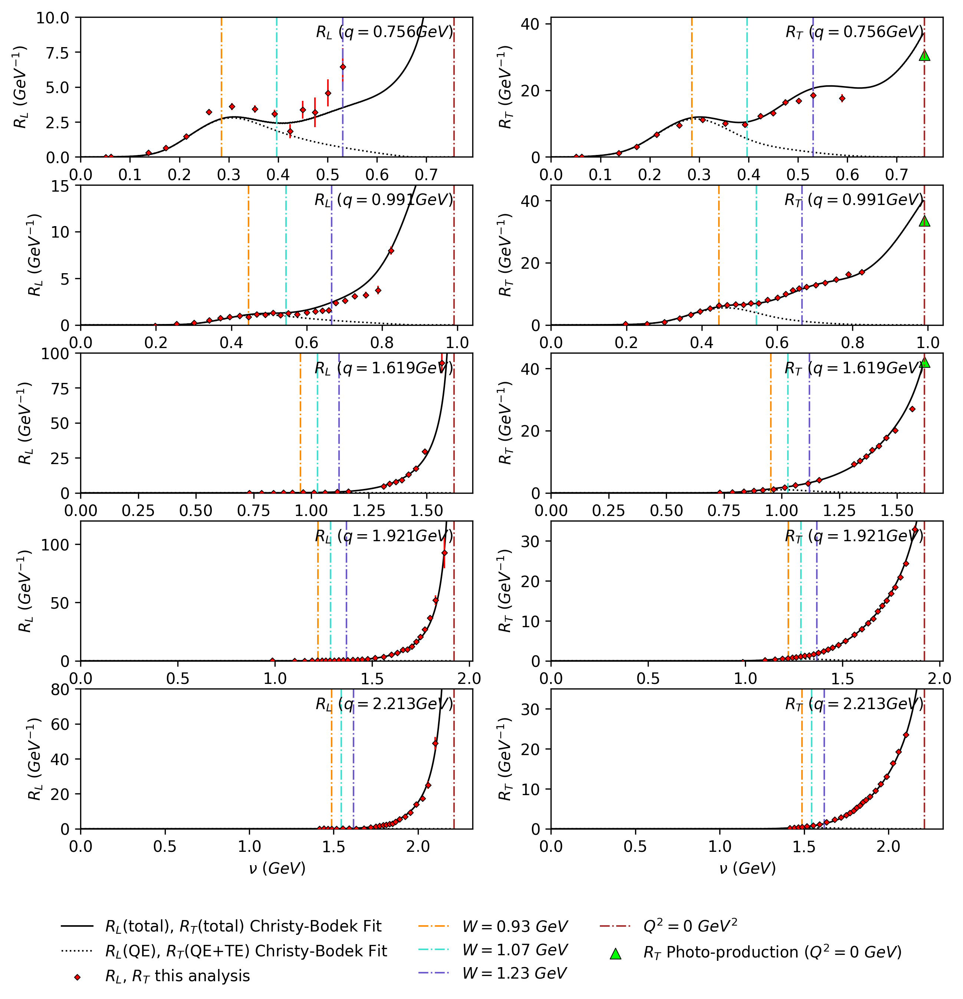

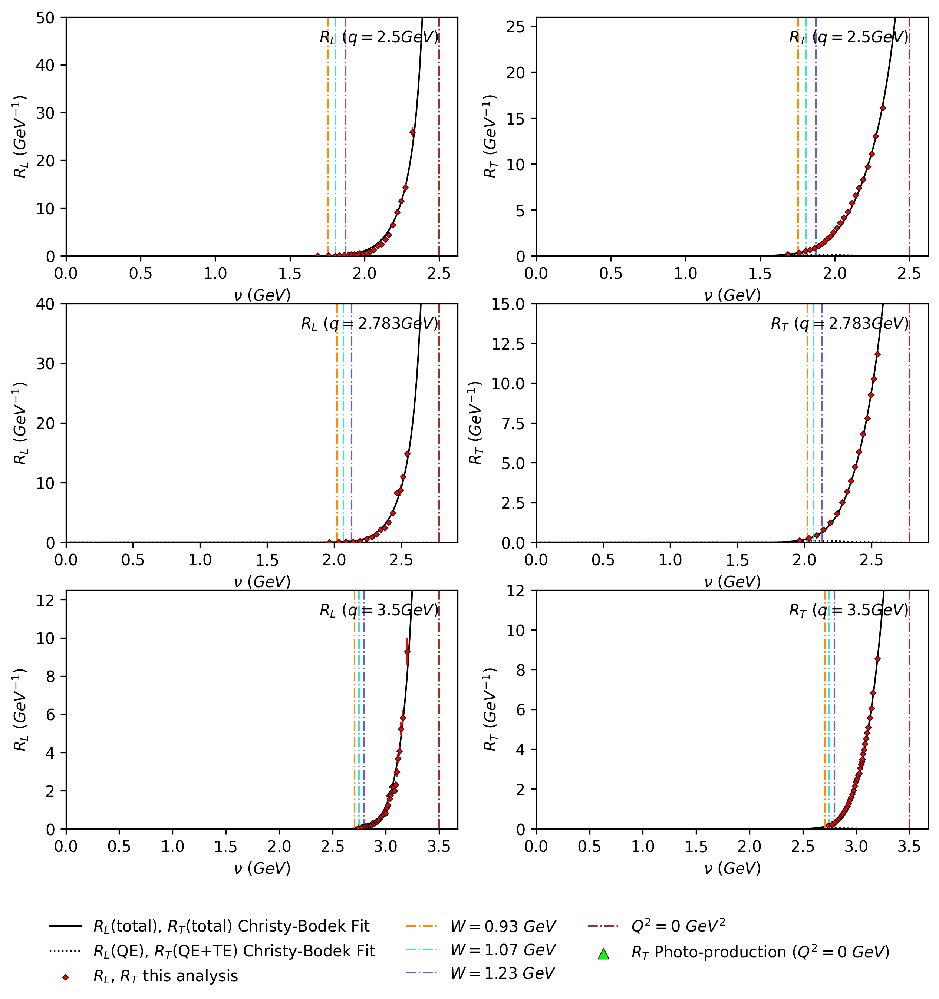

In [49]:
# plot Q2bins, qvbins: df

with PdfPages('Carbon/12C_plots/data_Q2bin.pdf') as pdf:
    plot_indeices = [[0,1,2,3,4],[5,6,7,8,9],[10,11,12,13,14],[15,16,17]]
    for bin_indices in plot_indeices:
        fig = RLRT_plot_Q2bin(df=df,bin_indices=bin_indices)
        pdf.savefig(fig)


with PdfPages('Carbon/12C_plots/data_qvbin.pdf') as pdf:
    plot_indeices = [[0,1,2,3,4],[5,6,7,8,9],[10,11,12,13,14],[15,16,17]]
    for bin_indices in plot_indeices:
        fig = RLRT_plot_qvbin(df=df,bin_indices=bin_indices)
        pdf.savefig(fig)

## print W2center, Excenter length
# for Q2center in Q2centers:
#     print(Q2center,'Ex len:',len(df.loc[(df['Q2center'] == Q2center) & (df['Ex'] < Ex_cut),'Ex']),
#           'W2 len:',len(df.loc[(df['Q2center'] == Q2center) & (df['Ex'] >= Ex_cut),'W2']))
# print()
# for qvcenter in qvcenters:
#     print(qvcenter,'Ex len:',len(df.loc[(df['qvcenter'] == qvcenter) & (df['Ex'] < Ex_cut),'Ex']),
#           'W2 len:',len(df.loc[(df['qvcenter'] == qvcenter) & (df['Ex'] >= Ex_cut),'W2']))


In [96]:
# df_CB 12C fake data

qemodplot_columns = ['e','nu','ep','theta','nu-nuel','w2','q2','sigtot','sigqe','sigie','sigmec','nuccstot','signonuc']
# df.loc[df['Ex']>0.05]
pd.read_csv('Carbon/12C_data_raw/12C-25June11.csv')[['E0','ThetaDeg','nu']].to_csv('Carbon/input.txt',index=False,header=False,sep=' ')
with open('Carbon/output.txt', 'w') as output_file:
    subprocess.run(['Carbon/Eric/cscompqe-25June10/qemodplot_norm', 'Carbon/input.txt'], stdout=output_file) 
subprocess.run(['sleep', '0.5'])
df_CB = pd.read_csv('Carbon/output.txt', sep='\s+', header=None, names=qemodplot_columns)
df_CB['cross']=df_CB['sigtot']*12*1e3
df_CB['E0']=df_CB['e']
df_CB['ThetaDeg']=df_CB['theta']
df_CB['A']=12
df_CB['Z']=6
df_CB=df_CB[['A','Z','E0','nu','ThetaDeg','cross']]
df_CB = prepare_df(df_data=df_CB,coulomb=0.0)
df_CB = calculate_bc(df_CB)
df_CB

RL RT bc_q2_w2 done.
RL RT bc_q2_ex done.
RL RT bc_qv_w2 done.
RL RT bc_q2_ex done.


,A,Z,E0,nu,ThetaDeg,cross,error,dataSet,normalization,normError,...,RL_qvc_w2,RT_qvc_w2,RL_qvd_w2,RT_qvd_w2,bc_qv_w2,RL_qvc_ex,RT_qvc_ex,RL_qvd_ex,RT_qvd_ex,bc_qv_ex
0,12,6,0.1196,0.00710,90.0,141.843240,0.0,-1,1,0,...,0.000000,0.000000,0.067601,3.425115e-06,1.000000,0.044276,1.684530e-04,0.067893,3.125043e-06,0.655017
1,12,6,0.1196,0.01210,90.0,13697.976000,0.0,-1,1,0,...,0.000000,0.000000,0.027170,9.867213e-04,1.000000,0.044276,1.684530e-04,0.027840,9.043287e-04,1.526488
2,12,6,0.1196,0.01710,90.0,36572.412000,0.0,-1,1,0,...,0.000000,0.000000,0.019829,8.019052e-03,1.000000,0.018909,7.127865e-03,0.019674,7.804702e-03,0.943007
3,12,6,0.1196,0.02210,90.0,34300.956000,0.0,-1,1,0,...,0.000000,0.000000,0.034280,1.320338e-02,1.000000,0.033817,1.255326e-02,0.033377,1.305634e-02,0.993573
4,12,6,0.1196,0.00210,145.0,0.002093,0.0,-1,1,0,...,0.000000,0.000000,0.013673,2.723063e-09,1.000000,0.084943,1.192114e-07,0.013717,2.730976e-09,6.188102
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10366,12,6,0.7795,0.29939,50.4,1948.359600,0.0,-1,1,0,...,0.004417,0.011808,0.003843,1.174165e-02,1.025409,0.000004,2.583892e-12,0.003949,1.174557e-02,1.000000
10367,12,6,0.7795,0.30742,50.4,1919.274000,0.0,-1,1,0,...,0.003860,0.012570,0.003726,1.190963e-02,1.071624,0.000004,2.583892e-12,0.003812,1.174627e-02,1.000000
10368,12,6,0.7795,0.31582,50.4,1916.048400,0.0,-1,1,0,...,0.003860,0.012570,0.003619,1.228352e-02,1.038453,0.000004,2.583892e-12,0.003688,1.193841e-02,1.000000
10369,12,6,0.7795,0.32345,50.4,1936.966800,0.0,-1,1,0,...,0.003860,0.012570,0.003470,1.278893e-02,1.000799,0.000004,2.583892e-12,0.003619,1.227589e-02,1.000000


/var/folders/74/13k54tvs74vchflrfsmkcc_m0000gn/T/ipykernel_99171/635266448.py:512: RuntimeWarning: divide by zero encountered in divide
  Chi2 = np.sum(np.square((y-linear_model(x,a_opt,b_opt))/y_err))
/var/folders/74/13k54tvs74vchflrfsmkcc_m0000gn/T/ipykernel_99171/635266448.py:512: RuntimeWarning: divide by zero encountered in divide
  Chi2 = np.sum(np.square((y-linear_model(x,a_opt,b_opt))/y_err))
/var/folders/74/13k54tvs74vchflrfsmkcc_m0000gn/T/ipykernel_99171/635266448.py:578: RuntimeWarning: divide by zero encountered in divide
  Chi2 = np.sum(np.square((y-linear_model(x,a_opt,b_opt))/y_err))
/var/folders/74/13k54tvs74vchflrfsmkcc_m0000gn/T/ipykernel_99171/635266448.py:512: RuntimeWarning: divide by zero encountered in divide
  Chi2 = np.sum(np.square((y-linear_model(x,a_opt,b_opt))/y_err))
/var/folders/74/13k54tvs74vchflrfsmkcc_m0000gn/T/ipykernel_99171/635266448.py:578: RuntimeWarning: divide by zero encountered in divide
  Chi2 = np.sum(np.square((y-linear_model(x,a_opt,b_opt)

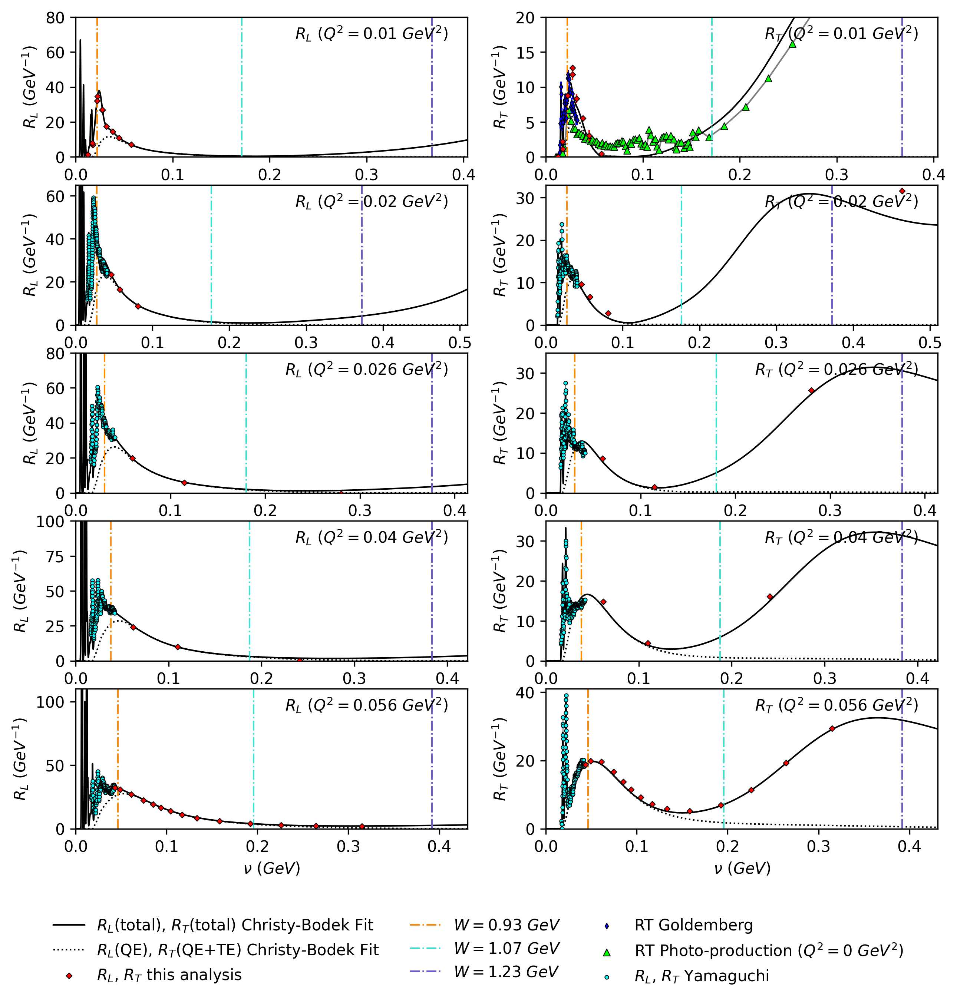

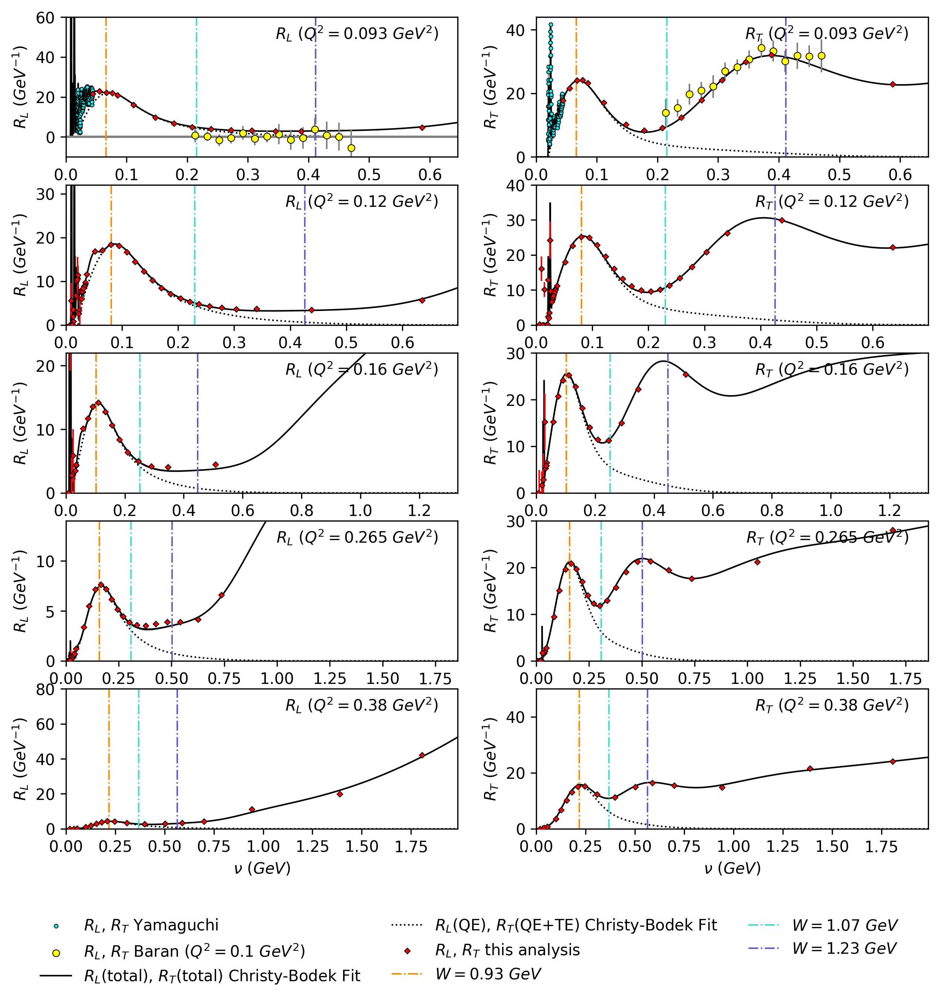

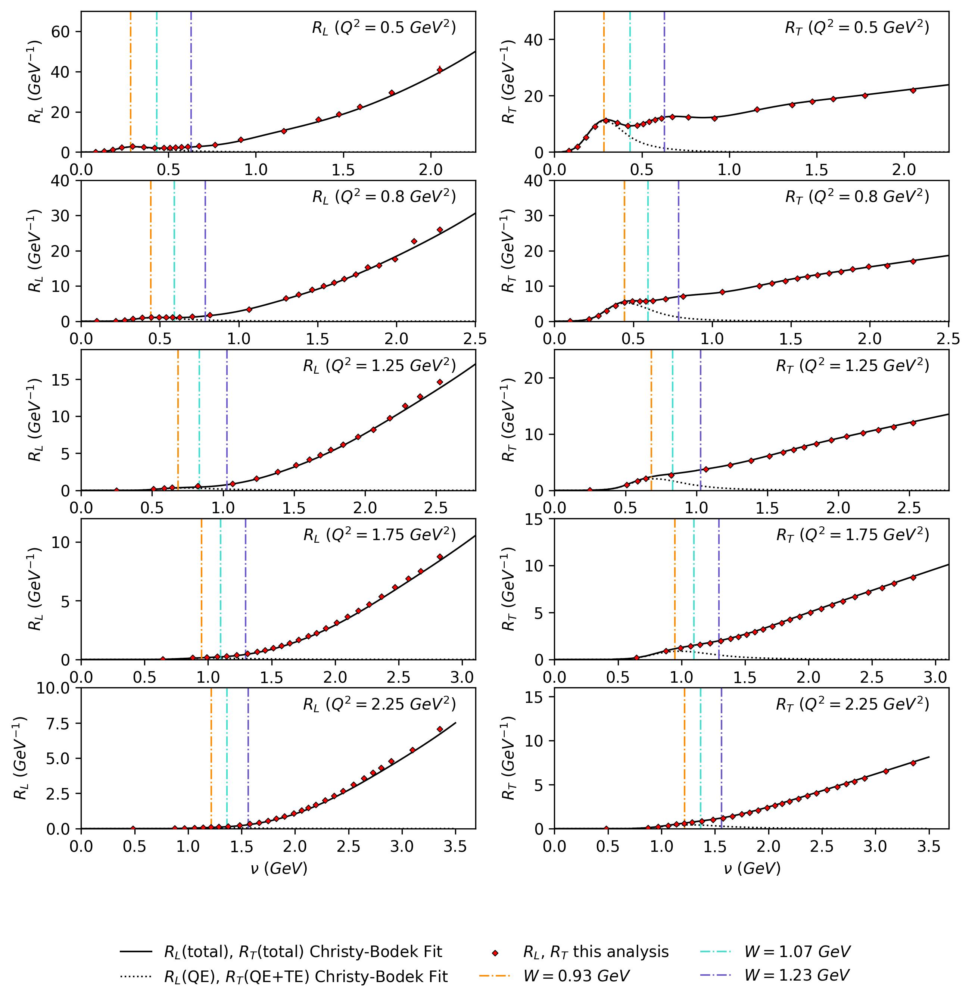

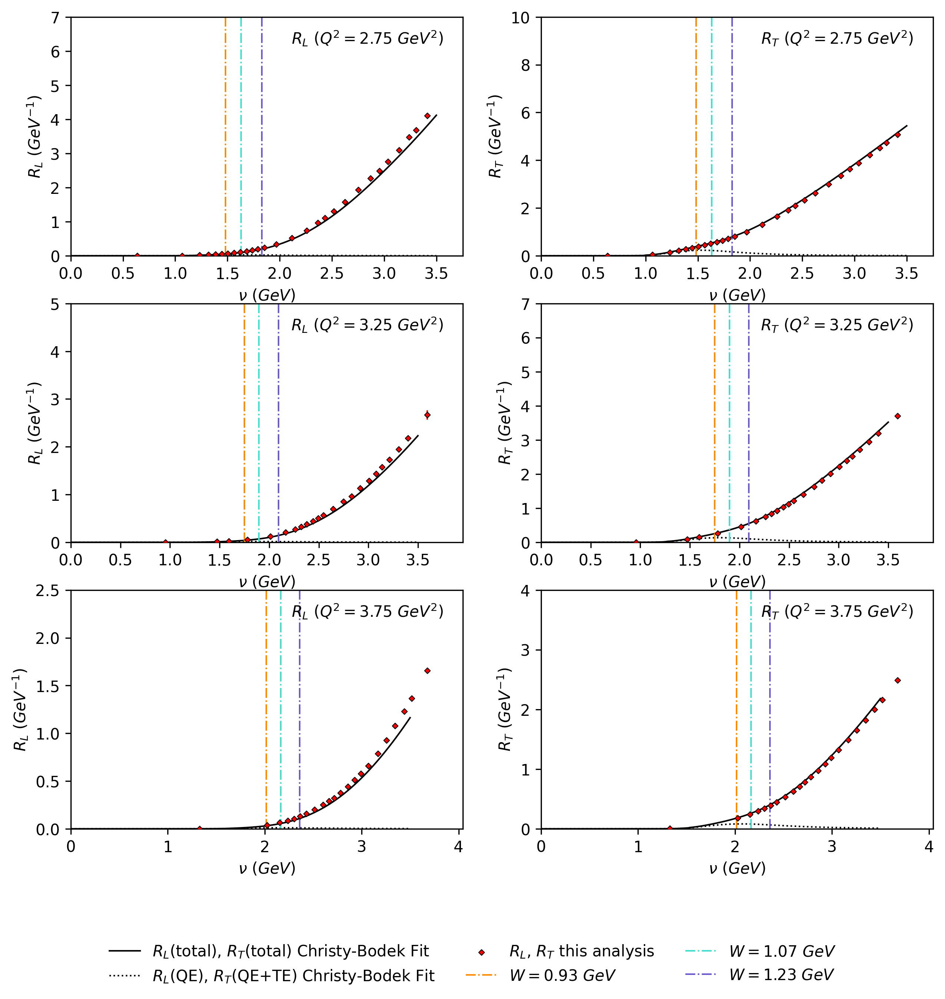

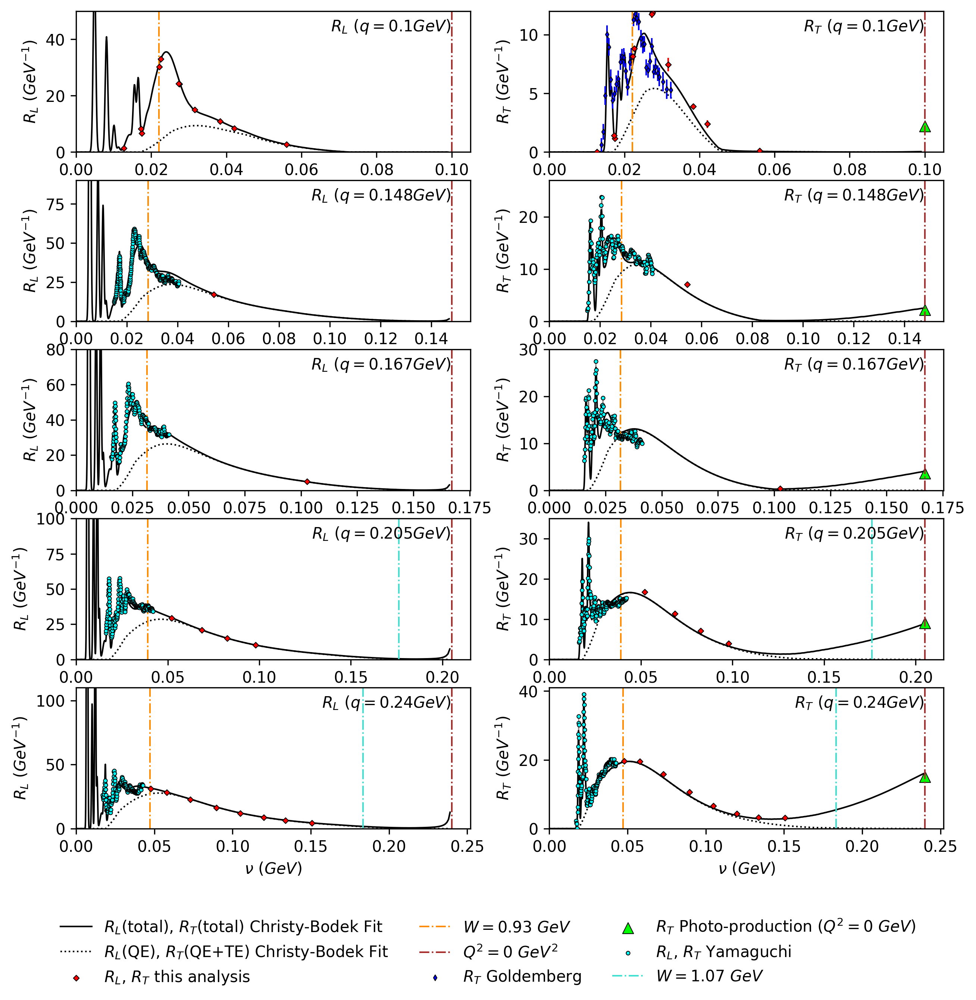

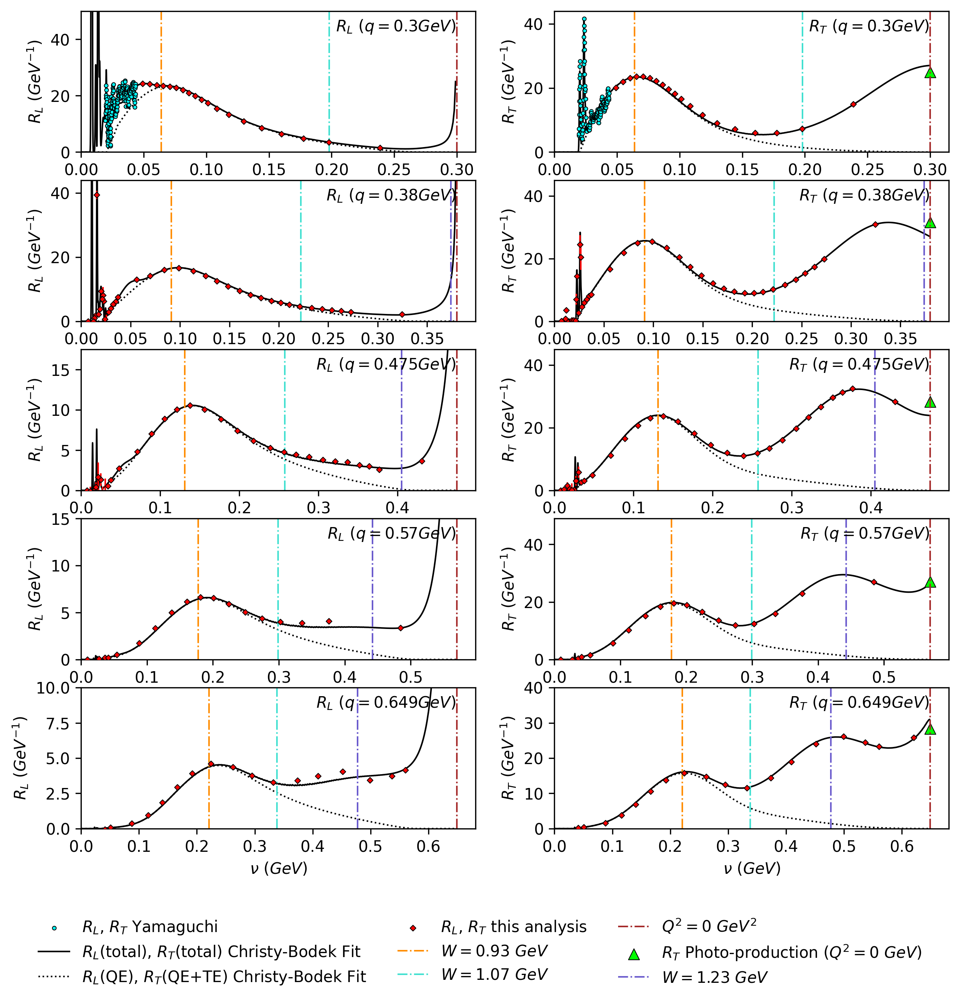

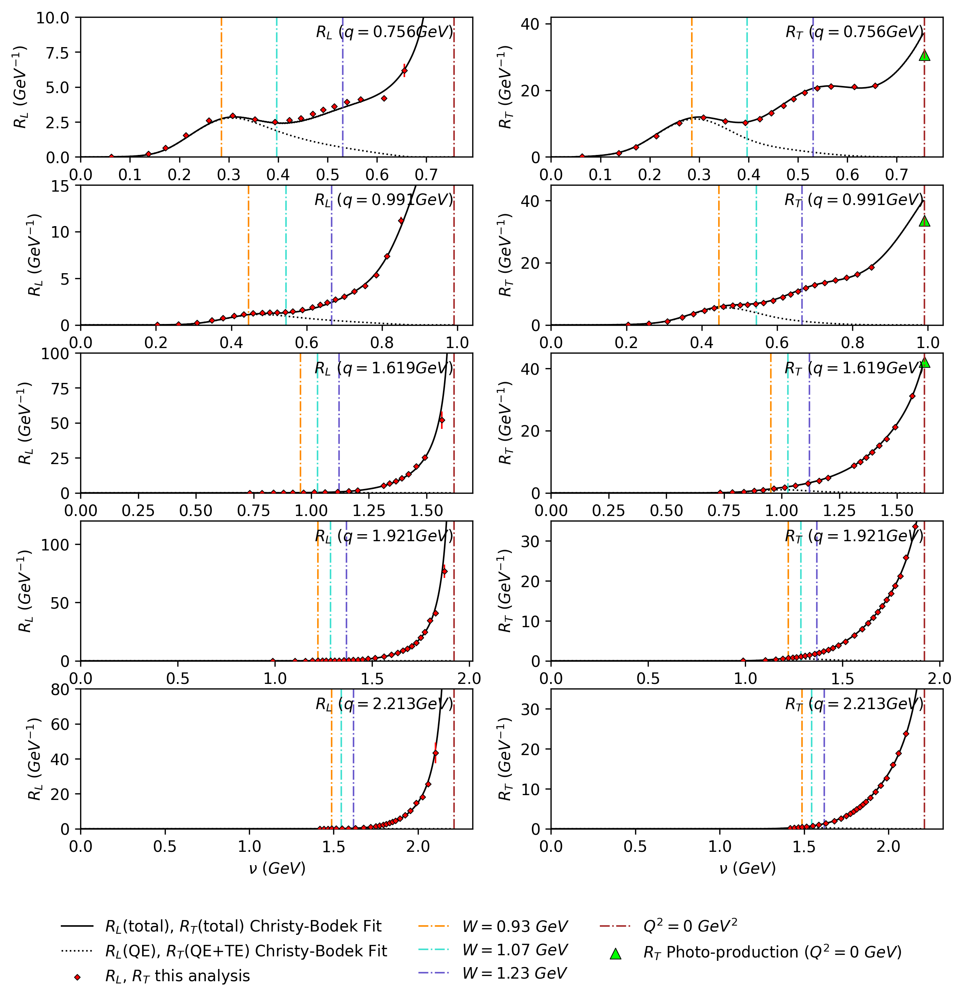

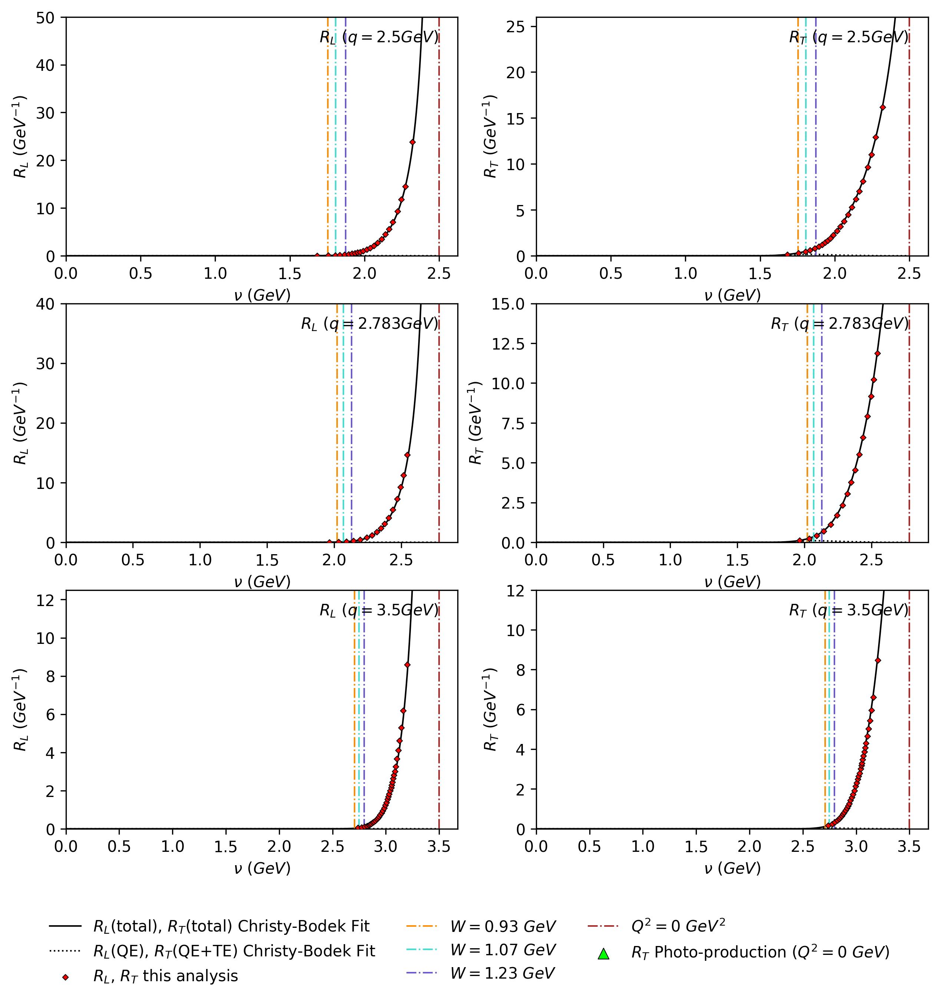

In [97]:
# plot Q2bins, qvbins: df_CB

with PdfPages('Carbon/12C_plots/CBfit_Q2bin.pdf') as pdf:
    plot_indeices = [[0,1,2,3,4],[5,6,7,8,9],[10,11,12,13,14],[15,16,17]]
    for bin_indices in plot_indeices:
        fig=RLRT_plot_Q2bin(df=df_CB,bin_indices=bin_indices,absolute_sigma=False,bc=True)
        pdf.savefig(fig)

with PdfPages('Carbon/12C_plots/CBfit_qvbin.pdf') as pdf:
    plot_indeices = [[0,1,2,3,4],[5,6,7,8,9],[10,11,12,13,14],[15,16,17]]
    for bin_indices in plot_indeices:
        fig=RLRT_plot_qvbin(df=df_CB,bin_indices=bin_indices,absolute_sigma=False,bc=True)
        pdf.savefig(fig)



In [45]:
# df_susa 12C
df_susa = pd.read_csv('Carbon/12C_theory_predictions/SuSAv2/12C_susa.csv')
df_susa = df_susa[['A','Z','E0','nu','ThetaDeg','cross']]
df_susa = prepare_df(df_data=df_susa,coulomb=0.0)
df_susa = calculate_bc(df_susa)
df_susa=df_susa.dropna()
df_susa

RL RT bc_q2_w2 done.
RL RT bc_q2_ex done.
RL RT bc_qv_w2 done.
RL RT bc_q2_ex done.


,A,Z,E0,nu,ThetaDeg,cross,error,dataSet,normalization,normError,...,RL_qvc_w2,RT_qvc_w2,RL_qvd_w2,RT_qvd_w2,bc_qv_w2,RL_qvc_ex,RT_qvc_ex,RL_qvd_ex,RT_qvd_ex,bc_qv_ex
0,12,6,0.1196,0.0121,90.0,43222.092190,0.0,-1,1,0,...,0.000000,0.000000,0.027170,9.867213e-04,1.000000,0.021628,2.922729e-03,0.027840,9.043287e-04,0.891528
1,12,6,0.1196,0.0171,90.0,53561.194000,0.0,-1,1,0,...,0.000000,0.000000,0.019829,8.019052e-03,1.000000,0.018895,7.114130e-03,0.019674,7.804702e-03,0.941893
2,12,6,0.1196,0.0221,90.0,56388.912290,0.0,-1,1,0,...,0.000000,0.000000,0.034280,1.320338e-02,1.000000,0.033621,1.251872e-02,0.033377,1.305634e-02,0.988920
3,12,6,0.1196,0.0021,145.0,823.811316,0.0,-1,1,0,...,0.000000,0.000000,0.013673,2.723063e-09,1.000000,0.087507,3.977145e-07,0.013717,2.730976e-09,6.373760
4,12,6,0.1196,0.0071,145.0,3045.103033,0.0,-1,1,0,...,0.000000,0.000000,0.089748,3.188237e-07,1.000000,0.069255,2.678861e-05,0.089550,2.771600e-07,0.775630
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8995,12,6,0.2500,0.0330,50.0,119100.187000,0.0,-1,1,0,...,0.036742,0.014597,0.037219,1.429283e-02,0.994758,0.015364,2.404434e-09,0.037296,1.425028e-02,1.000000
8996,12,6,0.2500,0.0331,50.0,118913.033300,0.0,-1,1,0,...,0.036742,0.014597,0.037193,1.431085e-02,0.995019,0.015364,2.404434e-09,0.037265,1.426609e-02,1.000000
8997,12,6,0.2500,0.0331,50.0,118913.033300,0.0,-1,1,0,...,0.036742,0.014597,0.037193,1.431085e-02,0.995019,0.015364,2.404434e-09,0.037265,1.426609e-02,1.000000
8998,12,6,0.2500,0.0333,50.0,118685.696300,0.0,-1,1,0,...,0.036742,0.014597,0.037148,1.434917e-02,0.995375,0.015364,2.404434e-09,0.037209,1.430018e-02,1.000000


/var/folders/74/13k54tvs74vchflrfsmkcc_m0000gn/T/ipykernel_99171/635266448.py:512: RuntimeWarning: divide by zero encountered in divide
  Chi2 = np.sum(np.square((y-linear_model(x,a_opt,b_opt))/y_err))
/var/folders/74/13k54tvs74vchflrfsmkcc_m0000gn/T/ipykernel_99171/635266448.py:512: RuntimeWarning: divide by zero encountered in divide
  Chi2 = np.sum(np.square((y-linear_model(x,a_opt,b_opt))/y_err))
/var/folders/74/13k54tvs74vchflrfsmkcc_m0000gn/T/ipykernel_99171/635266448.py:512: RuntimeWarning: invalid value encountered in divide
  Chi2 = np.sum(np.square((y-linear_model(x,a_opt,b_opt))/y_err))
/var/folders/74/13k54tvs74vchflrfsmkcc_m0000gn/T/ipykernel_99171/635266448.py:578: RuntimeWarning: divide by zero encountered in divide
  Chi2 = np.sum(np.square((y-linear_model(x,a_opt,b_opt))/y_err))
/var/folders/74/13k54tvs74vchflrfsmkcc_m0000gn/T/ipykernel_99171/635266448.py:512: RuntimeWarning: divide by zero encountered in divide
  Chi2 = np.sum(np.square((y-linear_model(x,a_opt,b_opt))

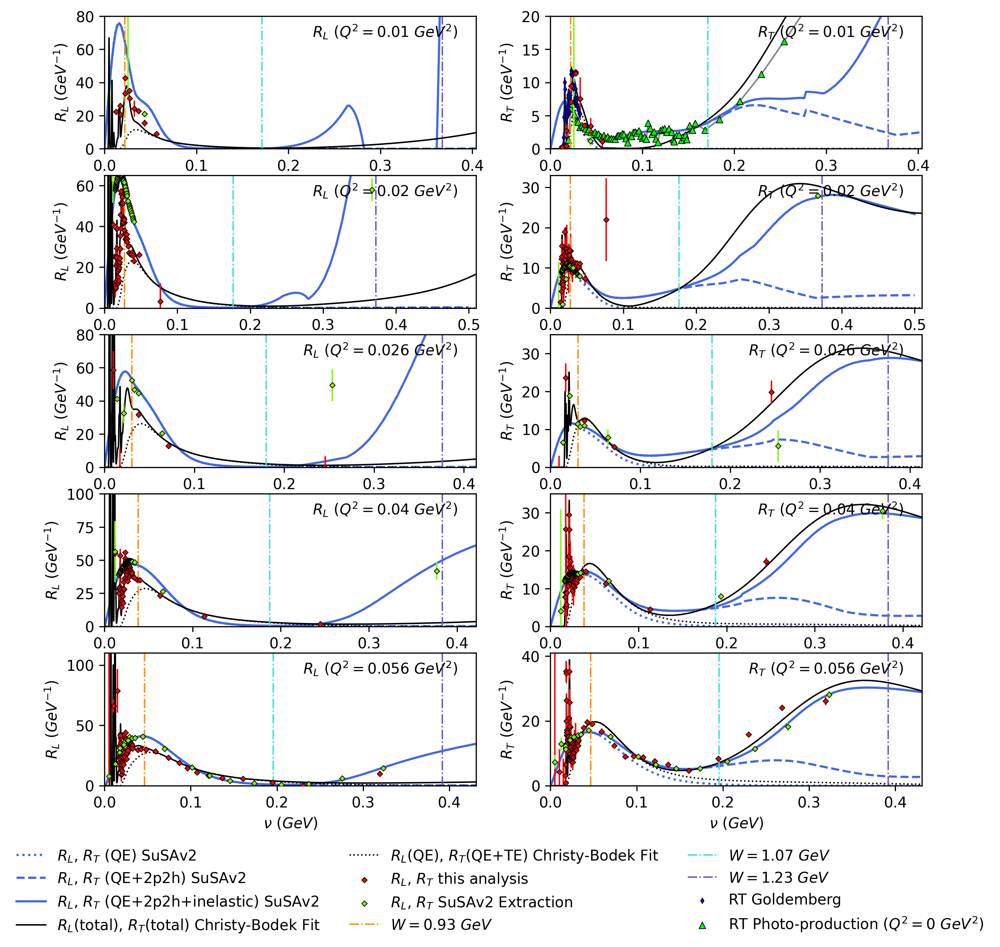

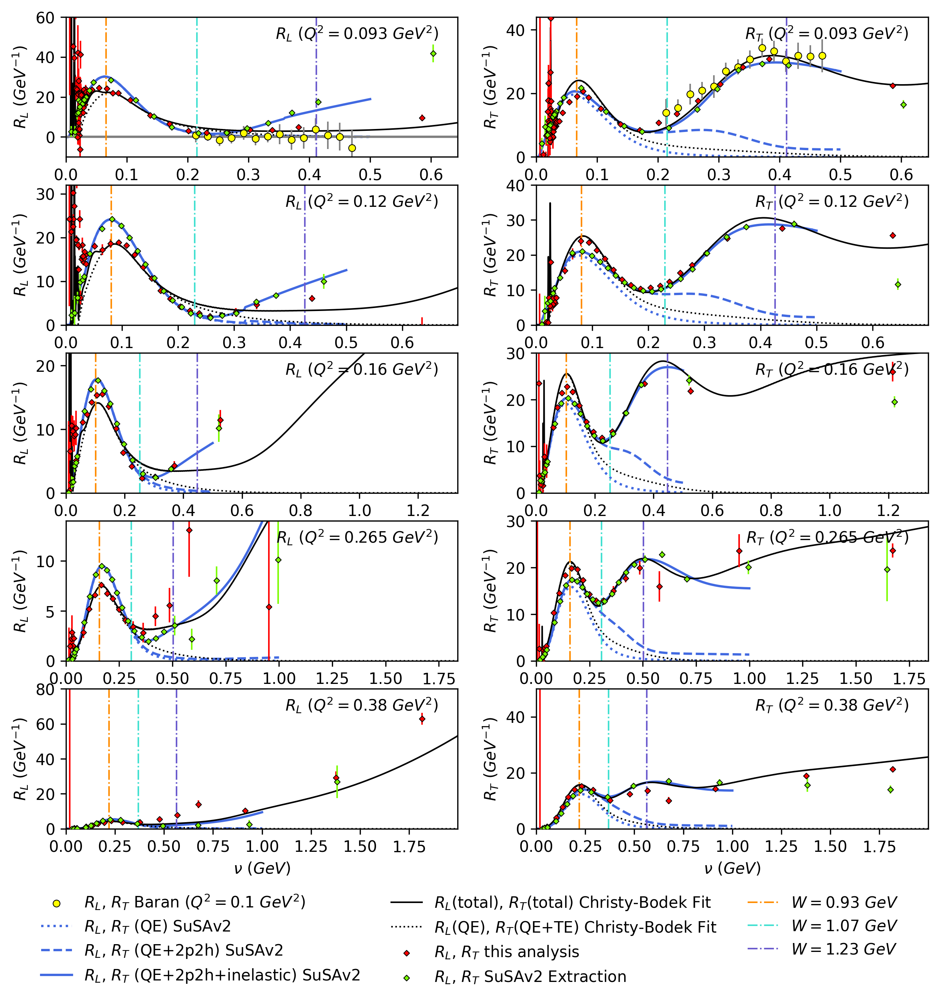

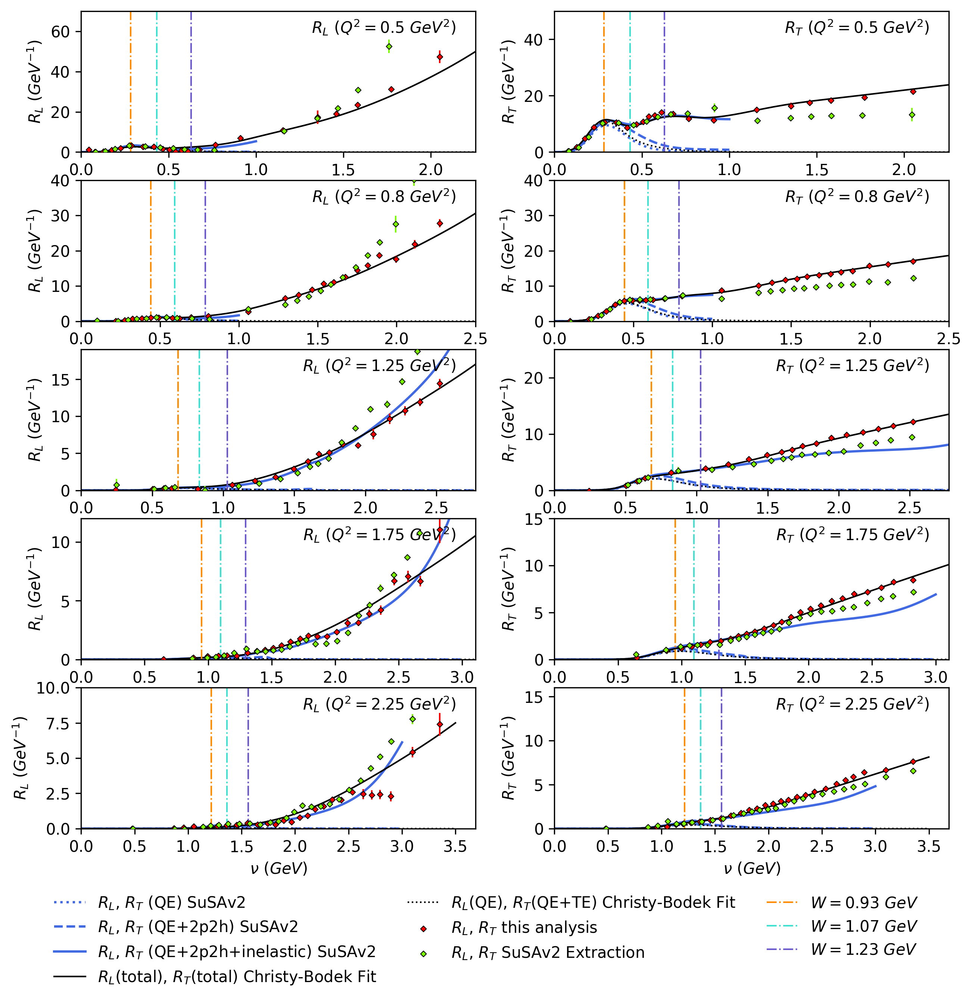

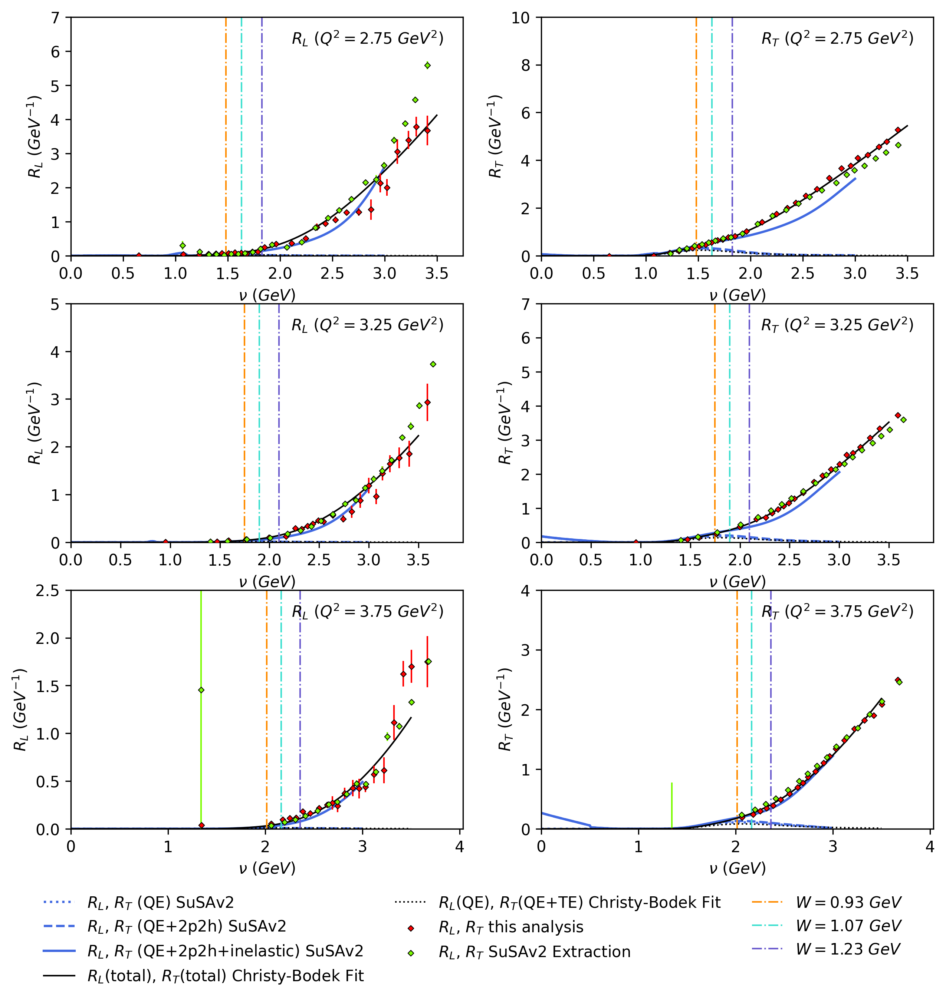

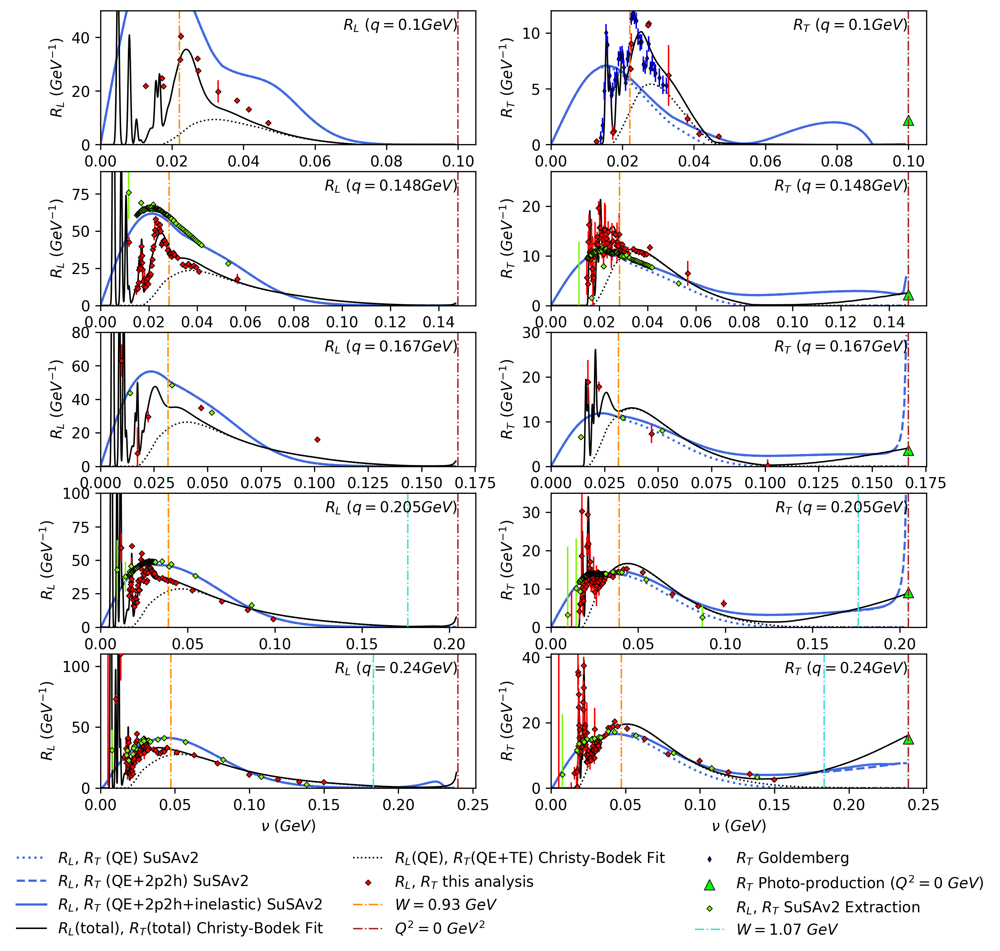

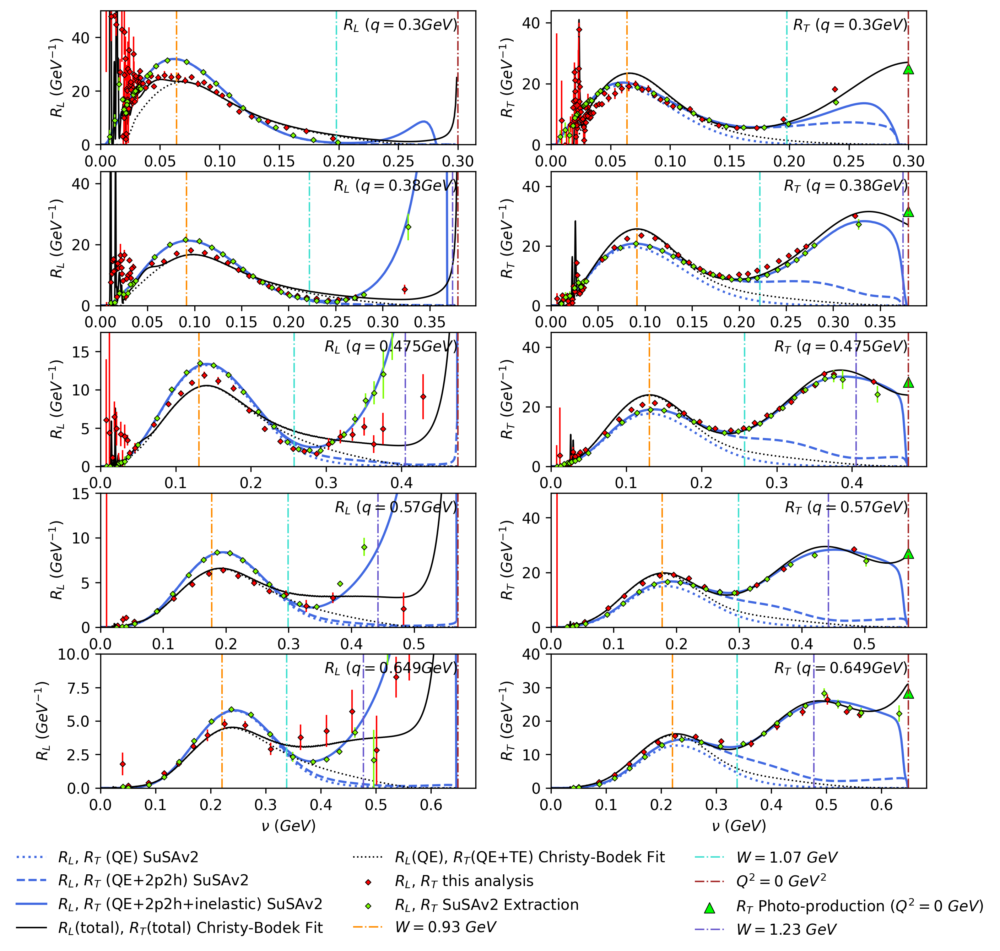

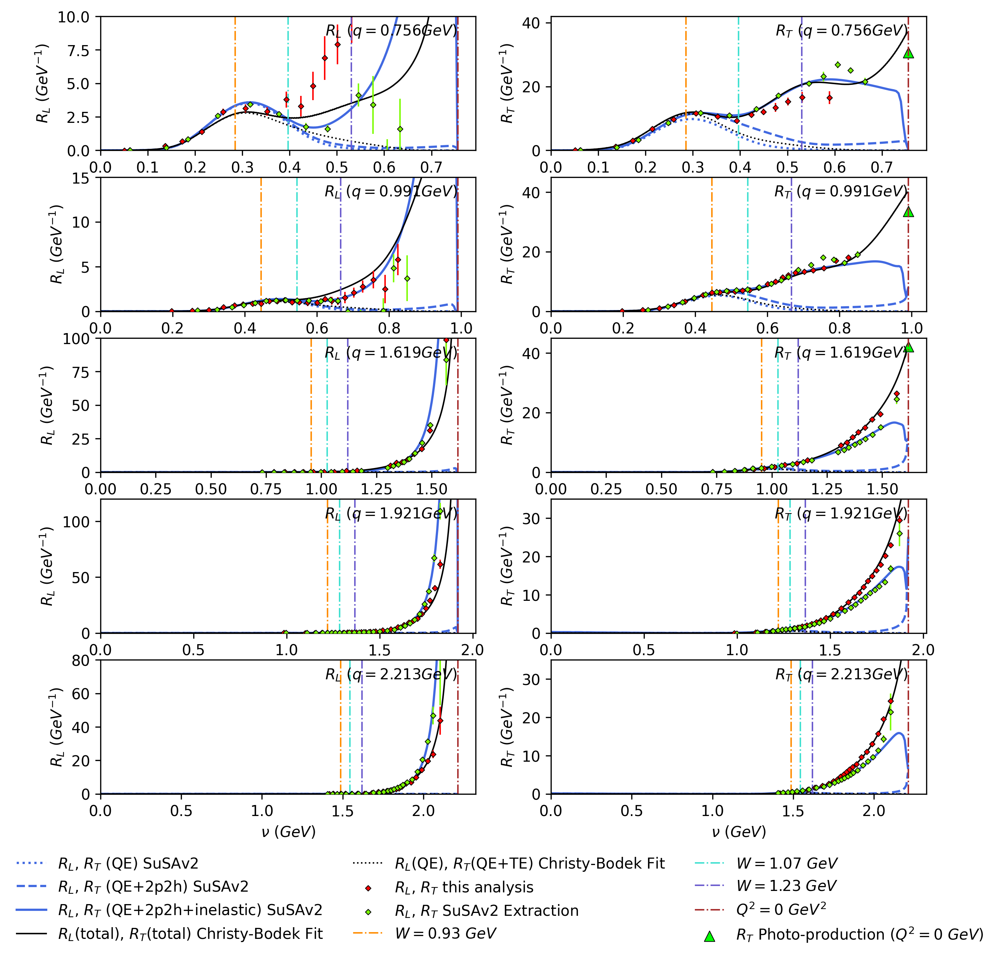

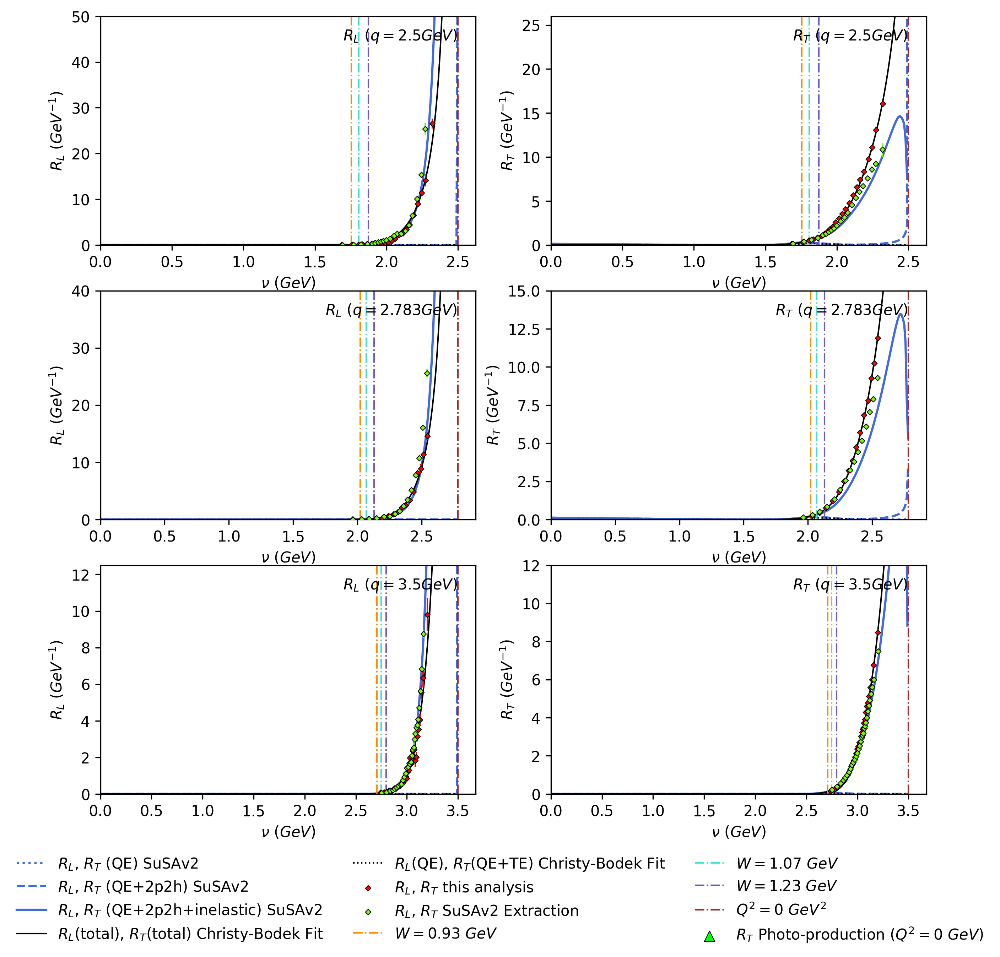

In [76]:
# plot Q2bins, qvbins: df_susa

with PdfPages('Carbon/12C_plots/SuSAv2_Q2bin.pdf') as pdf:
    plot_indeices = [[0,1,2,3,4],[5,6,7,8,9],[10,11,12,13,14],[15,16,17]]
    for bin_indices in plot_indeices:
        fig=RLRT_plot_Q2bin(df=df,df_susa=df_susa,bin_indices=bin_indices,absolute_sigma=False,bc=True,Yamaguchi_plot=False,SuSAv2_plot=True)
        pdf.savefig(fig)

with PdfPages('Carbon/12C_plots/SuSAv2_qvbin.pdf') as pdf:
    plot_indeices = [[0,1,2,3,4],[5,6,7,8,9],[10,11,12,13,14],[15,16,17]]
    for bin_indices in plot_indeices:
        fig=RLRT_plot_qvbin(df=df,df_susa=df_susa,bin_indices=bin_indices,absolute_sigma=False,bc=True,Yamaguchi_plot=False,SuSAv2_plot=True)
        pdf.savefig(fig)



In [26]:
# df_genie 12C
df_genie = pd.read_csv('Carbon/12C_MC_predictions/GENIE/12C-GENIE-25May15.csv')
df_genie = df_genie[['A','Z','E0','nu','ThetaDeg','cross','error']]
df_genie = prepare_df(df_data=df_genie,coulomb=0.0)
df_genie = calculate_bc(df_genie)
df_genie=df_genie.dropna()
df_genie

RL RT bc_q2_w2 done.
RL RT bc_q2_ex done.
RL RT bc_qv_w2 done.
RL RT bc_q2_ex done.


,A,Z,E0,nu,ThetaDeg,cross,error,dataSet,normalization,normError,...,RL_qvc_w2,RT_qvc_w2,RL_qvd_w2,RT_qvd_w2,bc_qv_w2,RL_qvc_ex,RT_qvc_ex,RL_qvd_ex,RT_qvd_ex,bc_qv_ex
1,12,6,1.299,0.058455,37.5,2915.67,728.918,-1,1,0,...,0.000000,0.000000,0.000003,0.000034,1.000000,0.000007,7.043520e-05,0.000002,0.000033,2.174066
2,12,6,1.299,0.071445,37.5,3462.36,794.320,-1,1,0,...,0.000000,0.000000,0.000004,0.000062,0.000000,0.000000,0.000000e+00,0.000004,0.000060,1.000000
3,12,6,1.299,0.084435,37.5,6195.80,1062.570,-1,1,0,...,0.000000,0.000000,0.000007,0.000105,0.000000,0.000000,0.000000e+00,0.000007,0.000101,1.000000
4,12,6,1.299,0.097425,37.5,12027.10,1480.440,-1,1,0,...,0.000010,0.000107,0.000012,0.000170,0.641873,0.000000,0.000000e+00,0.000012,0.000161,1.000000
5,12,6,1.299,0.110415,37.5,21867.50,1996.220,-1,1,0,...,0.000010,0.000107,0.000021,0.000264,0.407607,0.000000,0.000000e+00,0.000019,0.000250,1.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10568,12,6,0.240,0.207600,145.0,656597.00,13714.900,-1,1,0,...,0.000789,0.008106,0.001591,0.008821,1.227877,0.015470,3.660738e-09,0.002029,0.007523,1.000000
10569,12,6,0.240,0.210000,145.0,683525.00,13993.300,-1,1,0,...,0.000789,0.008106,0.001384,0.009301,1.095884,0.015470,3.660738e-09,0.001789,0.007935,1.000000
10570,12,6,0.240,0.212400,145.0,708735.00,14249.000,-1,1,0,...,0.000789,0.008106,0.001198,0.009797,0.972640,0.015470,3.660738e-09,0.001566,0.008362,1.000000
10571,12,6,0.240,0.214800,145.0,726496.00,14426.400,-1,1,0,...,0.000789,0.008106,0.001033,0.010302,0.858167,0.015470,3.660738e-09,0.001358,0.008791,1.000000


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scipy/optimize/_minpack_py.py:975: RuntimeWarning: divide by zero encountered in divide
  transform = 1.0 / sigma
/var/folders/74/13k54tvs74vchflrfsmkcc_m0000gn/T/ipykernel_99171/204692517.py:501: OptimizeWarning: Covariance of the parameters could not be estimated
  params, covariance = curve_fit(linear_model, x, y, sigma=y_err, absolute_sigma=absolute_sigma)
/var/folders/74/13k54tvs74vchflrfsmkcc_m0000gn/T/ipykernel_99171/204692517.py:507: RuntimeWarning: divide by zero encountered in divide
  Chi2 = np.sum(np.square((y-linear_model(x,a_opt,b_opt))/y_err))
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/scipy/optimize/_minpack_py.py:975: RuntimeWarning: divide by zero encountered in divide
  transform = 1.0 / sigma
/var/folders/74/13k54tvs74vchflrfsmkcc_m0000gn/T/ipykernel_99171/204692517.py:567: OptimizeWarning: Covariance of the parameters could not be estimated
  params,

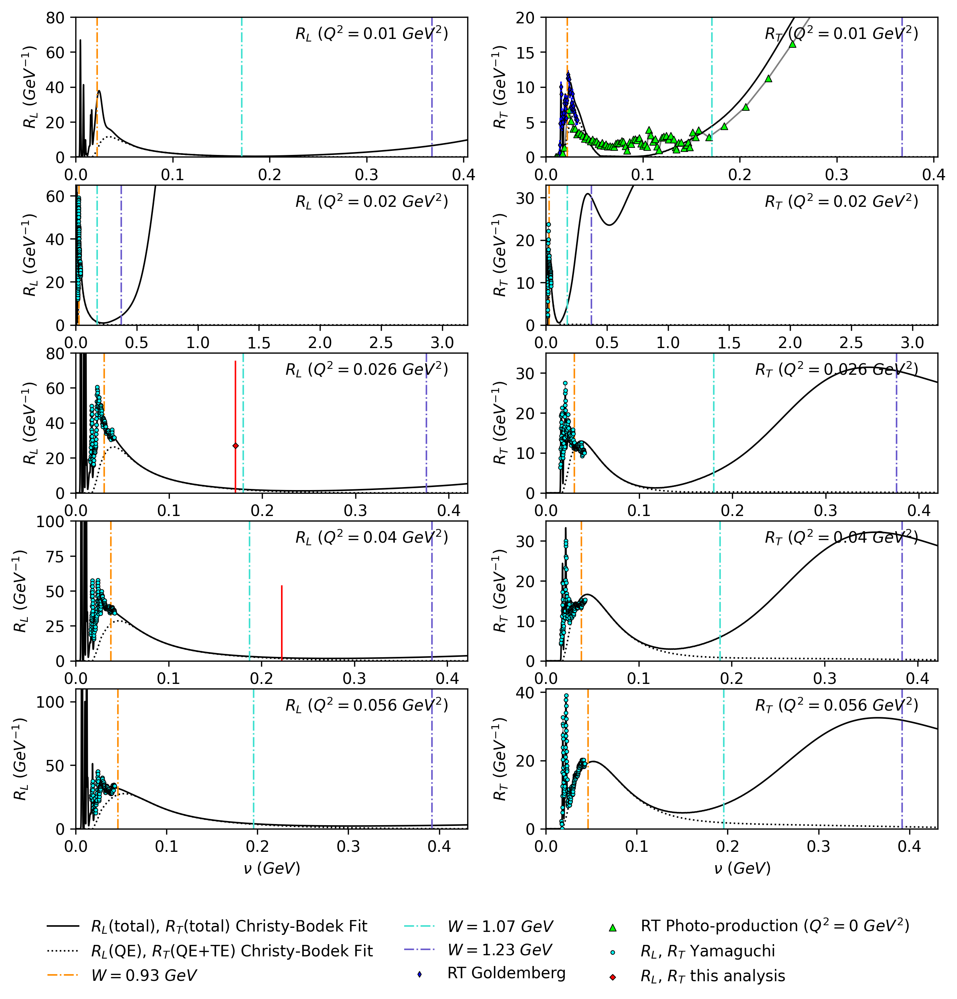

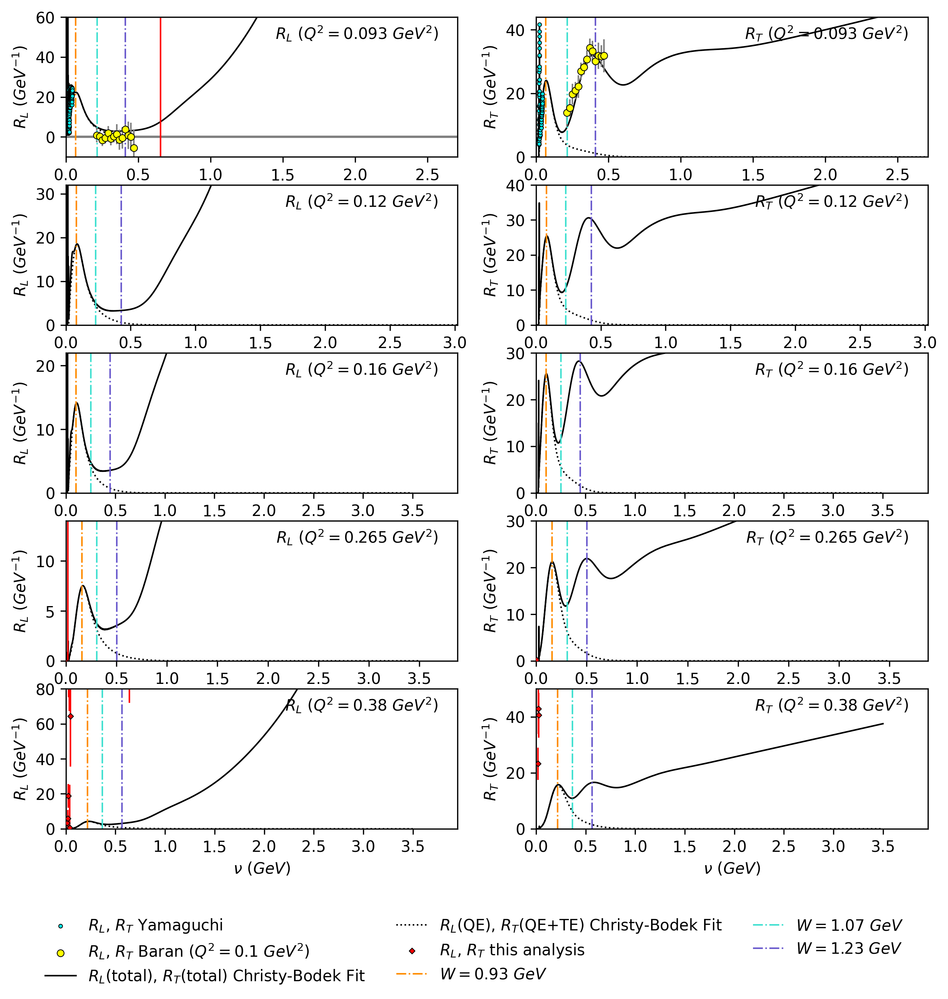

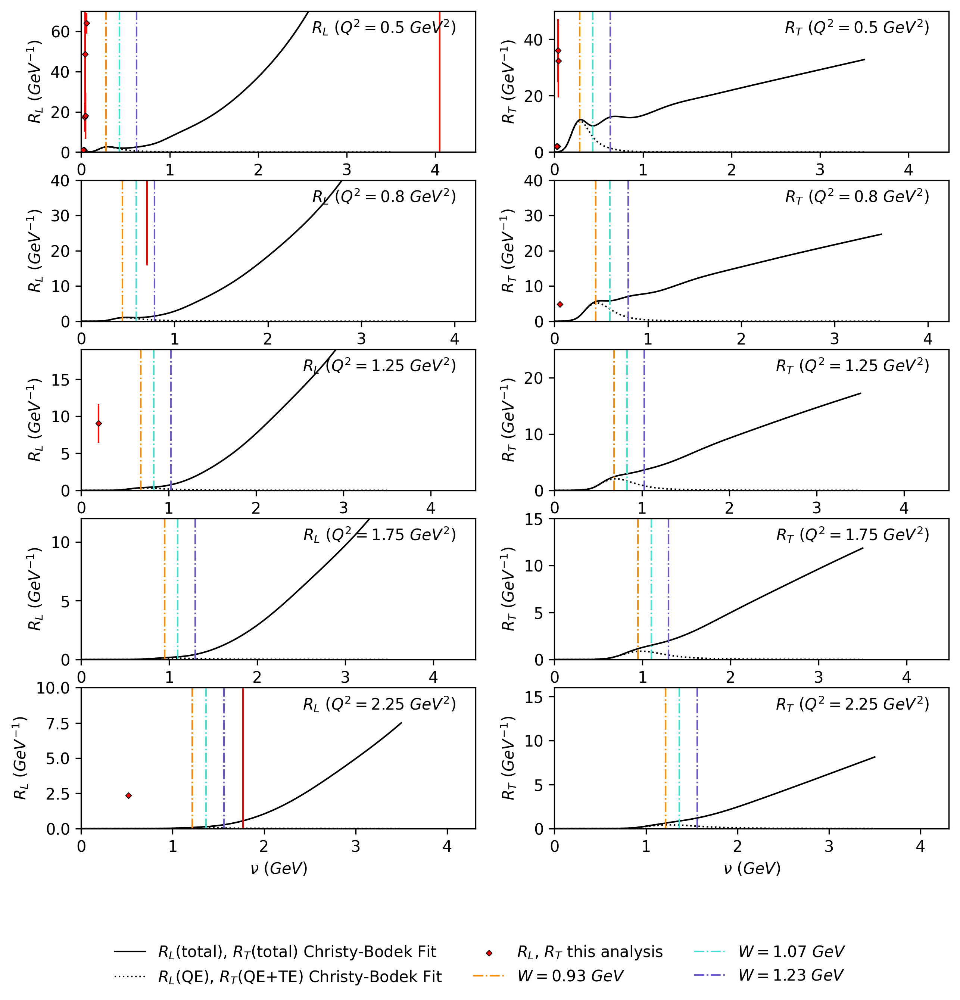

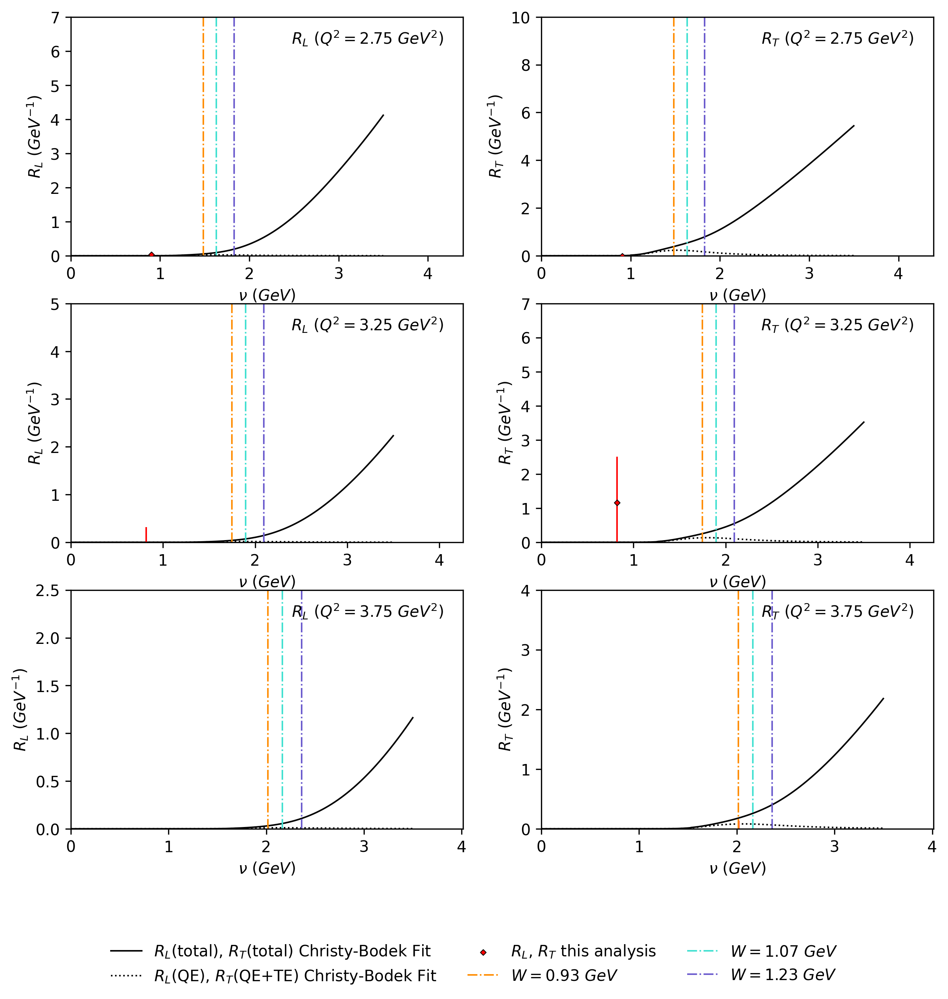

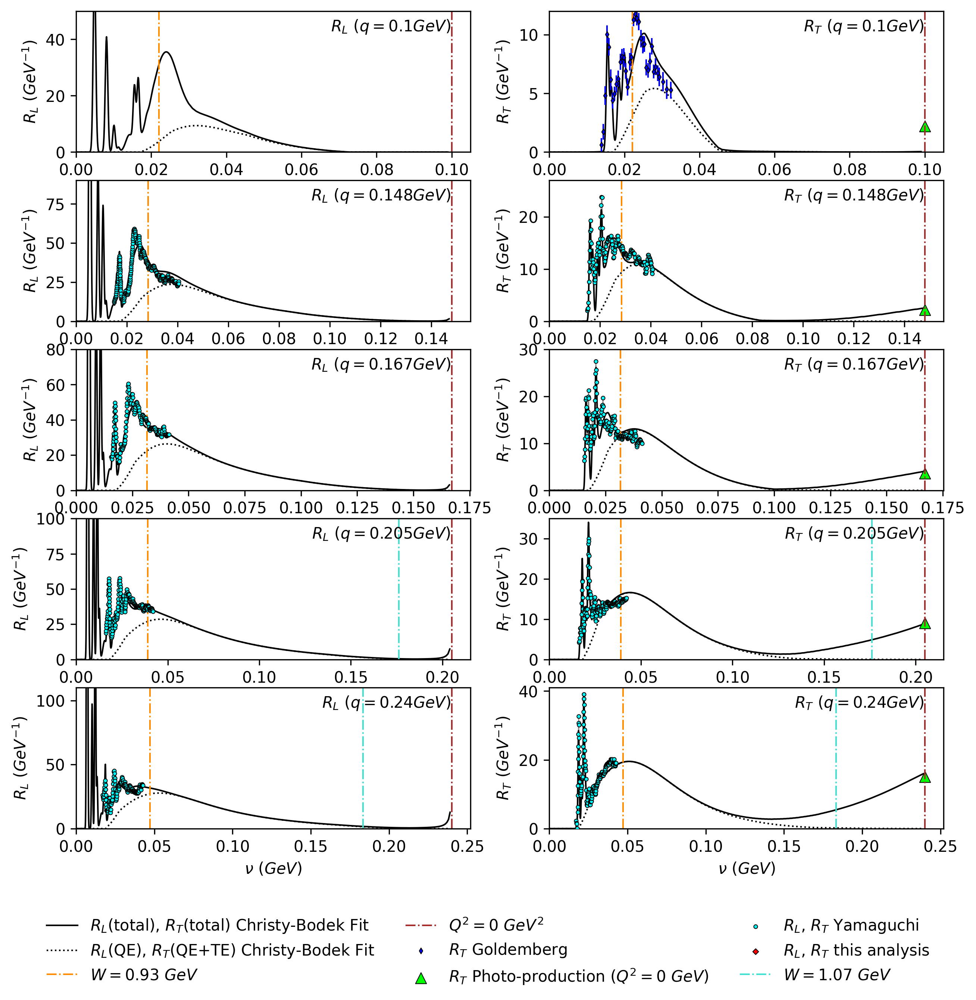

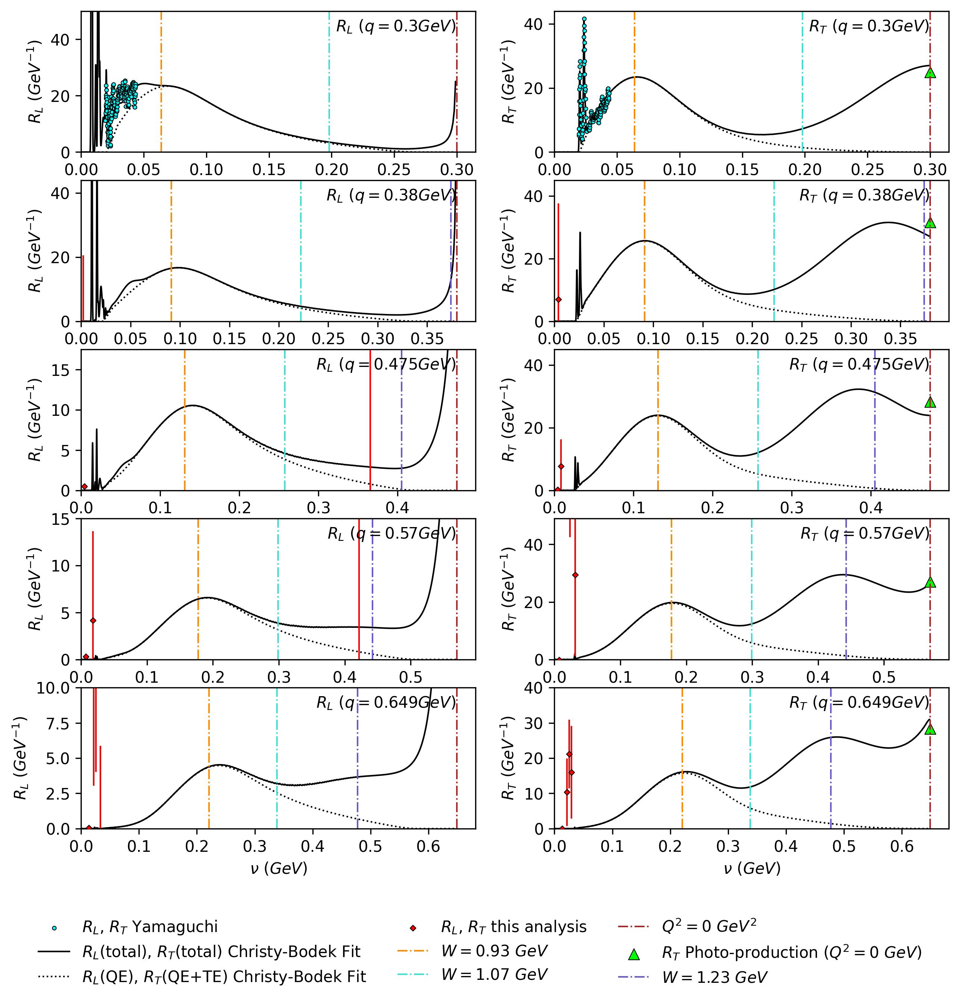

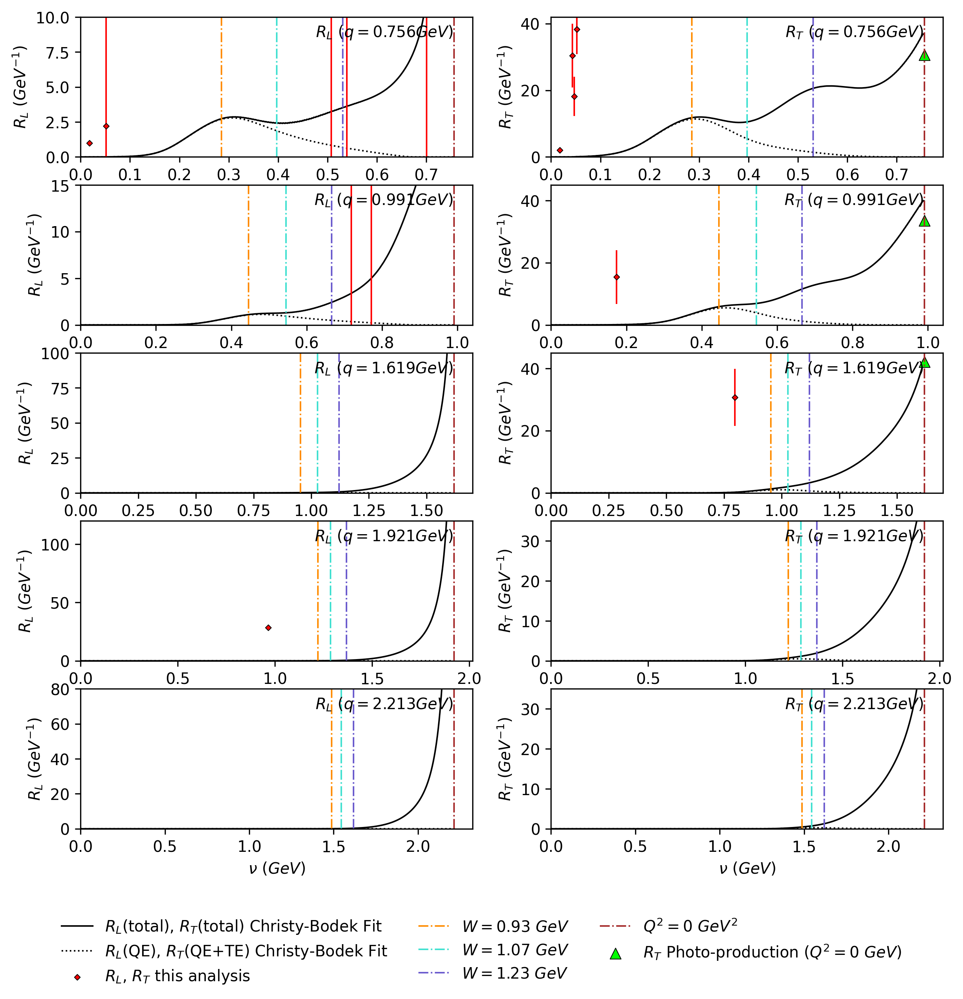

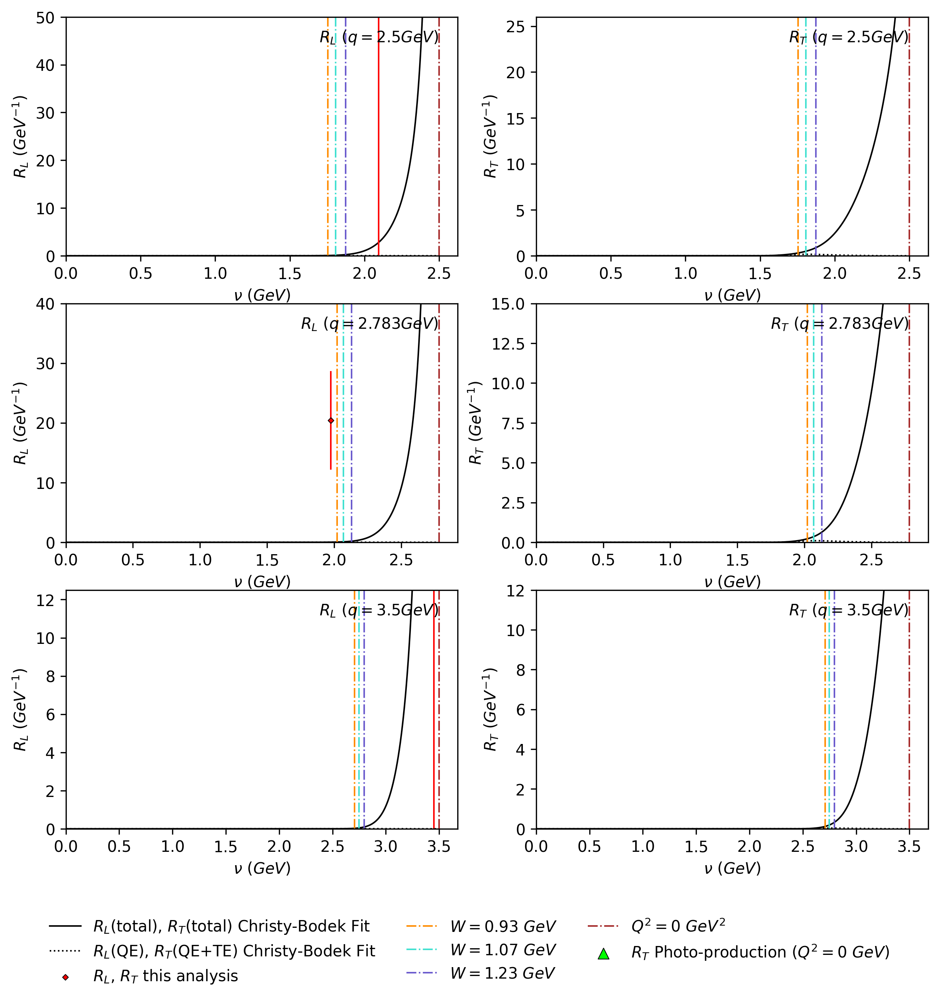

In [27]:
# plot Q2bins, qvbins: df_genie

with PdfPages('Carbon/12C_plots/GENIE_Q2bin.pdf') as pdf:
    plot_indeices = [[0,1,2,3,4],[5,6,7,8,9],[10,11,12,13,14],[15,16,17]]
    for bin_indices in plot_indeices:
        fig=RLRT_plot_Q2bin(df=df_genie,bin_indices=bin_indices,absolute_sigma=True,bc=True)
        pdf.savefig(fig)

with PdfPages('Carbon/12C_plots/GENIE_qvbin.pdf') as pdf:
    plot_indeices = [[0,1,2,3,4],[5,6,7,8,9],[10,11,12,13,14],[15,16,17]]
    for bin_indices in plot_indeices:
        fig=RLRT_plot_qvbin(df=df_genie,bin_indices=bin_indices,absolute_sigma=True,bc=True)
        pdf.savefig(fig)



In [98]:
df = pd.read_csv('Carbon/12C_data_raw/12C-25May23.csv')
if 'error' not in df.columns:
    df['error']=0.0

# calculate normalized cross section:
if 'dataSet' not in df.columns:
    df['dataSet']=-1
    df['normalization']=1
    df['normError']=0
else:
    df["normalization"]=df["dataSet"].map(dataSet_to_normalization)
    df["normError"]=df["dataSet"].map(dataSet_to_normError)
df['normCross'] = df['cross'] * df['normalization']
    
# system_err = 0.02
system_err = 0.0

df['error'] = np.sqrt(df['error']**2 + ((system_err*df['cross'])**2))
df['normCrossError']=df['normCross']*np.sqrt((df['error']/df['cross'])**2+(df['normError']/df['normalization'])**2)
df["ThetaRad"]=df["ThetaDeg"]*np.pi/180
df["sin2(T/2)"]=(np.sin(df["ThetaRad"]/2))**2
df["cos2(T/2)"]=(np.cos(df["ThetaRad"]/2))**2
df["tan2(T/2)"]=(np.tan(df["ThetaRad"]/2))**2

df["Ex"] = df["nu"] - (df["E0"]-df["E0"]/(1+2*df["E0"]*df["sin2(T/2)"]/mass_C12))
# df = df.sort_values(by=['nu'])

qemodplot_columns = ['e','nu','ep','theta','nu-nuel','w2','q2','sigtot','sigqe','sigie','sigmec','nuccstot','signonuc']
# df.loc[df['Ex']>0.05]

df[['E0','ThetaDeg','nu']].to_csv('Carbon/input.txt',index=False,header=False,sep=' ')
with open('Carbon/output.txt', 'w') as output_file:
    subprocess.run(['Carbon/Eric/cscompqe-25June10/qemodplot_norm', 'Carbon/input.txt'], stdout=output_file) 
subprocess.run(['sleep', '0.5'])
df_CB = pd.read_csv('Carbon/output.txt', sep='\s+', header=None, names=qemodplot_columns)
print('len df_CB df:',len(df_CB),len(df))
df['sigtot']=df_CB['sigtot']*12*1e3
# df_CB['cross']=df_CB['sigtot']*12*1e3
# df_CB['E0']=df_CB['e']
# df_CB['ThetaDeg']=df_CB['theta']
# df_CB['A']=12
# df_CB['Z']=6
# df_CB=df_CB[['A','Z','E0','nu','ThetaDeg','cross']]
# df_CB = prepare_df(df_data=df_CB,coulomb=0.0)
# df_CB = calculate_bc(df_CB)
# df_CB







# plotting data vs fit Xsec
inputs = []
for dataSet in np.sort(df['dataSet'].unique()):
    df_author = df.loc[df['dataSet'] == dataSet]
    df_author = df_author.loc[df_author['Ex'] > 0.03]
    for E0 in np.sort(df_author['E0'].unique()):
        df_E0 = df_author.loc[df_author['E0'] == E0]
        for ThetaDeg in np.sort(df_E0['ThetaDeg'].unique()):
            inputs.append((dataSet, E0, ThetaDeg))
print(len(inputs))

len df_CB df: 10724 10724
156


In [116]:
# plot XSec comparison with datasets, CBfit, SuSAv2, GENIE

df_genie=pd.read_csv('Carbon/12C_MC_predictions/GENIE/12C-GENIE-25May15.csv')

count=0
# with PdfPages('C12paper_figures/data_vs_fit_Xsec.pdf') as pdf:
with PdfPages('Carbon/12C_plots/GENIE_SuSA_12C_Xsec.pdf') as pdf:

    for i in range(13): # 修改这个数，取决画多少页
        fig, axs = plt.subplots(ncols=3, nrows=4, figsize=(20, 20), dpi=200) 
        for j, ax in enumerate(axs.flat):
            if i*12+j >= len(inputs): #每页画12个图
                break
            dataSet, E0, ThetaDeg, = inputs[i*12+j]
            df_theta = df.loc[(df['dataSet']==dataSet)&(df['E0'] == E0)&(df['ThetaDeg'] == ThetaDeg)]
            df_theta = df_theta.loc[df_theta['Ex'] > 0.03]
            df_theta = df_theta.sort_values(by='nu')

            # # plot against nu
            ax.errorbar(df_theta['nu'], df_theta['normCross'], yerr=df_theta['normCrossError'], fmt='.', markersize=5, label=f'$E_0=${E0}$GeV$\n$\\theta=${ThetaDeg}°', color='blue',zorder=-1)
            ax.scatter(df_theta['nu'], df_theta['sigtot'], label='Christy-Bodek Fit', color='red',marker='.',s=5)
            ax.plot(df_theta['nu'], df_theta['sigtot'], color='red', alpha=0.5)


            # ax.errorbar(df_susa['nu'], df_susa['normCross'], yerr=df_theta['normCrossError'], fmt='.', label=f'$E_0=${E0}$GeV$\n$\\theta=${ThetaDeg}°', color='blue',zorder=-1)
            df_susa_theta = df_susa.loc[(df_susa['E0'] == E0)&(df_susa['ThetaDeg'] == ThetaDeg)]
            ax.errorbar(df_susa_theta['nu'], df_susa_theta['cross'],  fmt='.', markersize=5, label=f'SuSAv2', color='limegreen',zorder=-1)
            df_genie_theta = df_genie.loc[(df_genie['E0'] == E0)&(df_genie['ThetaDeg'] == ThetaDeg)]
            ax.errorbar(df_genie_theta['nu'], df_genie_theta['cross']/1000,  fmt='.', markersize=5, label=f'GENIE', color='orange',zorder=-1)

            ax.set_xlabel('$\\nu \ (GeV)$')    
            ax.set_ylabel('$\\frac{d^2 \sigma}{d\Omega d\\nu} (nb/sr/GeV)$')
            ax.set_ylim(0,None)
            ax.set_title(f'{dataSet}: {dataSet_to_name[dataSet]} ($\\times${dataSet_to_normalization[dataSet]})')

            formatter = ScalarFormatter(useMathText=True)
            formatter.set_scientific(True)
            formatter.set_powerlimits((0,0))
            ax.yaxis.set_major_formatter(formatter)
            ax.legend()
        # plt.show()
        plt.tight_layout()
        pdf.savefig(fig)
        plt.close(fig)


In [8]:
# # (uncomment when use) calculate CB Q2edges, Qvedges; make sure you have the correct smwidth!
# def calculate_CB_Q2edges(Q2):
#     # df = pd.DataFrame({'nu':np.arange(0.0,3.5,0.001)})
#     df = pd.DataFrame({'nu':np.append(np.arange(0.0,0.0299,0.0001),np.arange(0.030,3.5,0.001))})
#     df['q2']=Q2
#     response_columns = ['qv','q2','ex','nu','RTTOT','RLTOT','RTQE','RLQE','RTIE','RLIE','RTE','RLE','RTNS','RLNS']
#     df[['q2','nu']].to_csv('Carbon/input.txt',index=True,header=False,sep=' ')
#     with open('Carbon/output.txt', 'w') as output_file:
#         subprocess.run(['Carbon/Eric/response-25June10/response_Q2edges', 'Carbon/input.txt'], stdout=output_file) 
#     subprocess.run(['sleep', '0.5'])
#     df = pd.read_csv('Carbon/output.txt', sep='\s+', header=None, names=response_columns)
#     df=df.dropna()
#     return df

# def calculate_CB_Qvedges(qv):
#     # df = pd.DataFrame({'nu':np.arange(0.0,qv,0.001)})
#     df = pd.DataFrame({'nu':np.append(np.arange(0.0,0.0299,0.0001),np.arange(0.030,qv,0.001))})
#     df['qv']=qv
#     response_columns = ['qv','q2','ex','nu','RTTOT','RLTOT','RTQE','RLQE','RTIE','RLIE','RTE','RLE','RTNS','RLNS']
#     df[['qv','nu']].to_csv('Carbon/input.txt',index=True,header=False,sep=' ')
#     with open('Carbon/output.txt', 'w') as output_file:
#         subprocess.run(['Carbon/Eric/response-25June10/response_Qvedges', 'Carbon/input.txt'], stdout=output_file) 
#     subprocess.run(['sleep', '0.5'])
#     df = pd.read_csv('Carbon/output.txt', sep='\s+', header=None, names=response_columns)
#     df=df.dropna()
#     return df

# for Q2 in Q2centers:
#     df_edges=calculate_CB_Q2edges(Q2)
#     df_edges.to_csv(f'Carbon/Eric/ChristyBodekFit/Q2edges/Q2edge_{Q2}.csv',index=False)
# for Q2 in Q2bins:
#     df_edges=calculate_CB_Q2edges(Q2)
#     df_edges.to_csv(f'Carbon/Eric/ChristyBodekFit/Q2edges/Q2edge_{Q2}.csv',index=False)

# for qv in qvcenters:
#     df_edges=calculate_CB_Qvedges(qv)
#     df_edges.to_csv(f'Carbon/Eric/ChristyBodekFit/Qvedges/Qvedge_{qv}.csv',index=False)
# for qv in qvbins:
#     df_edges=calculate_CB_Qvedges(qv)
#     df_edges.to_csv(f'Carbon/Eric/ChristyBodekFit/Qvedges/Qvedge_{qv}.csv',index=False)

In [9]:
# # (uncomment when use) save extracted RLRT to file
# df_ours = pd.DataFrame()
# for i in range(len(qvcenters)):

#     qvcenter = qvcenters[i]
#     fit = pd.concat([RLRT_extract_q2_ex(df,bin_index=i,bc=True,absolute_sigma=True),
#                         RLRT_extract_q2_w2(df,bin_index=i,bc=True,absolute_sigma=True)])

#     if i in [1,2,3,4,5]:
#         # for Yama_qvcenter in [0.148,0.167,0.205,0.24,0.3]:
#         Yama_qvcenter  = qvcenters[i]
#         # Yamaguchi RL
#         Yam_data = pd.read_excel('Carbon/12C_other_extractions/Yamaguchi/Yamaguchi_plotting.xlsx',sheet_name='qv_'+str(Yama_qvcenter))                  
#         fit = fit.loc[fit['nu']>Yam_data['nu_RL'].max()+0.002]

#     # append to DataFrame
#     df_ours = pd.concat([df_ours, fit], ignore_index=True)
# df_ours.to_csv('Carbon/12C_plots/Q2bin_our_extraction.csv',index=False)


# df_ours = pd.DataFrame()
# for i in range(len(qvcenters)):

#     qvcenter = qvcenters[i]
#     fit = pd.concat([RLRT_extract_qv_ex(df,bin_index=i,bc=True,absolute_sigma=True),
#                         RLRT_extract_qv_w2(df,bin_index=i,bc=True,absolute_sigma=True)])

#     if i in [1,2,3,4,5]:
#         # for Yama_qvcenter in [0.148,0.167,0.205,0.24,0.3]:
#         Yama_qvcenter  = qvcenters[i]
#         # Yamaguchi RL
#         Yam_data = pd.read_excel('Carbon/12C_other_extractions/Yamaguchi/Yamaguchi_plotting.xlsx',sheet_name='qv_'+str(Yama_qvcenter))                  
#         fit = fit.loc[fit['nu']>Yam_data['nu_RL'].max()+0.002]

#     # append to DataFrame
#     df_ours = pd.concat([df_ours, fit], ignore_index=True)
# df_ours.to_csv('Carbon/12C_plots/Qvbin_our_extraction.csv',index=False)



In [10]:
# # (uncomment when use) check Rosenbluth plot
# # test q=0.756
# fit=RLRT_extract_qv_w2(df=df,bin_index=10,Rosenbluth_plot=True)

# fig,ax=plt.subplots(nrows=1,ncols=2,figsize=(12,5))
# ax[0].scatter(fit['nu'],fit['RL'],**our_scatter_setting)
# ax[0].errorbar(fit['nu'],fit['RL'],yerr=fit['RLerr'],**errorbar_setting)
# ax[1].scatter(fit['nu'],fit['RT'],**our_scatter_setting)
# ax[1].errorbar(fit['nu'],fit['RT'],yerr=fit['RTerr'],**errorbar_setting)

# CBfit = pd.read_csv('Carbon/Eric/ChristyBodekFit/Qvedges/Qvedge_0.756.csv')
# CBfit = CBfit.loc[CBfit['nu']<=0.6]
# ax[0].plot(CBfit['nu'],CBfit['RLTOT'])
# ax[1].plot(CBfit['nu'],CBfit['RTTOT'])

# # test q=0.1
# fit=RLRT_extract_qv_ex(df=df,bin_index=0,Rosenbluth_plot=True,bc=True)
# fig,ax=plt.subplots(nrows=1,ncols=2,figsize=(12,5))
# ax[0].scatter(fit['nu'],fit['RL'],**our_scatter_setting)
# ax[0].errorbar(fit['nu'],fit['RL'],yerr=fit['RLerr'],**errorbar_setting)
# ax[1].scatter(fit['nu'],fit['RT'],**our_scatter_setting)
# ax[1].errorbar(fit['nu'],fit['RT'],yerr=fit['RTerr'],**errorbar_setting)

# CBfit = pd.read_csv('Carbon/Eric/ChristyBodekFit/Qvedges/Qvedge_0.1.csv')
# ax[0].plot(CBfit['nu'],CBfit['RLTOT'])
# ax[1].plot(CBfit['nu'],CBfit['RTTOT'])


In [ ]:
# # (uncomment when use) pre-process genie
# # prepare data from the GENIE folder
# filtered_lines = []
# for file_name in os.listdir('Carbon/12C_MC_predictions/GENIE/CrossSections'):
#     if not file_name.endswith('.txt'):
#         continue
#     if (file_name.endswith('DIS.txt') or file_name.endswith('MEC.txt') or file_name.endswith('NRB.txt') 
#         or file_name.endswith('QEL.txt') or file_name.endswith('RES.txt')):
#         continue
#     print(file_name)
#     with open(f'Carbon/12C_MC_predictions/GENIE/CrossSections/{file_name}', 'r') as file:
#         for line in file:
#             stripped_line = line.strip()
#             if stripped_line and stripped_line[0].isdigit():
#                 filtered_lines.append(stripped_line.split())

# df = pd.DataFrame(filtered_lines, columns=['Z','A','E0','ThetaDeg','nu','cross','error'])
# # df['dataSet']=27
# # csv_name = 'G18_10a_Nov11.csv'
# df.to_csv('Carbon/12C_MC_predictions/GENIE/12C-GENIE-25May15.csv',  index=False)
# df = pd.read_csv('Carbon/12C_MC_predictions/GENIE/12C-GENIE-25May15.csv')
# df = df.dropna()
# df = df.loc[df['error'] != 0]
# df['cross']=df['cross']*1e3
# df['error']=df['error']*1e3
# df.to_csv('Carbon/12C_MC_predictions/GENIE/12C-GENIE-25May15.csv',  index=False)

CrossSection_C_4074.0MeV_58.0.txt
CrossSection_C_1299.0MeV_37.5.txt
CrossSection_C_1204.0MeV_55.0.txt
CrossSection_C_2095.0MeV_60.0.txt
CrossSection_C_2346.0MeV_30.0.txt
CrossSection_C_518.8MeV_90.0.txt
CrossSection_C_4045.0MeV_55.0.txt
CrossSection_C_1930.0MeV_18.0.txt
CrossSection_C_4074.0MeV_39.0.txt
CrossSection_C_5150.0MeV_38.0.txt
CrossSection_C_2020.0MeV_15.0.txt
CrossSection_C_2347.6MeV_45.0.txt
CrossSection_C_3488.6MeV_14.0.txt
CrossSection_C_1300.0MeV_13.5.txt
CrossSection_C_280.1MeV_60.0.txt
CrossSection_C_1204.4MeV_45.0.txt
CrossSection_C_3116.0MeV_60.0.txt
CrossSection_C_3116.0MeV_25.0.txt
CrossSection_C_5011.0MeV_29.0.txt
CrossSection_C_4074.0MeV_43.0.txt
CrossSection_C_2130.0MeV_16.0.txt
CrossSection_C_5150.0MeV_23.0.txt
CrossSection_C_320.0MeV_90.0.txt
CrossSection_C_5150.0MeV_27.0.txt
CrossSection_C_480.0MeV_36.0.txt
CrossSection_C_1204.0MeV_16.0.txt
CrossSection_C_556.8MeV_90.0.txt
CrossSection_C_240.0MeV_36.0.txt
CrossSection_C_2222.0MeV_15.5.txt
CrossSection_C_400.0

In [ ]:
os.system('say done')